# Import

In [1]:
import wfdb
import matplotlib.pyplot as plt
import os
import pandas as pd
import neurokit2 as nk
import numpy as np
from scipy import stats
from scipy.stats import skew, kurtosis
from scipy.signal import butter, filtfilt, iirnotch
from concurrent.futures import ProcessPoolExecutor, as_completed
from tqdm import tqdm
import gc
import os
import seaborn as sns

mapping  = pd.read_csv('/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/ConditionNames_SNOMED-CT.csv')

# tạo dict ánh xạ {SNOMED_CT: FullName}
snomed_map = dict(zip(mapping['Snomed_CT'], mapping['Full Name']))

#base dir path
base_dir = '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/'
records_path = os.path.join(base_dir, "RECORDS")
records = [] #address of files of 1 object
with open(records_path,"r") as f:
    folders = [line.strip() for line in f.readlines()]
print("Số folder:", len(folders))
for folder in folders:
    file = os.path.join(base_dir,folder,"RECORDS")
    with open(file,"r") as f:
        records.extend(os.path.join(base_dir,folder,line.strip()) for line in f.readlines())


records_test = [records[i] for i in range(10)]
records_test

Số folder: 100


['/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00001',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00002',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00004',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00005',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00006',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00007',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00008',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00009',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00010',
 '/home/duong/physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/01/010/JS00011']

# Vizualization

In [2]:

def visualize_qrs_delineation(ecg_signal, r_peaks, sampling_rate=500, n_beats=5):
    """
    Vẽ chi tiết QRS complex để kiểm tra detect Q, R, S có đúng không
    """
    # Chạy delineation
    _, waves = nk.ecg_delineate(ecg_signal, {'ECG_R_Peaks': r_peaks}, sampling_rate)
    
    # Lấy các điểm
    qrs_onsets = waves.get('ECG_Q_Peaks', [])
    r_peaks_detect = r_peaks
    qrs_offsets = waves.get('ECG_S_Peaks', [])
    
    # Tính QRS duration
    if len(qrs_onsets) > 0 and len(qrs_offsets) > 0:
        # Chỉ lấy những cặp Q-S hợp lệ
        valid_pairs = []
        for q, s in zip(qrs_onsets, qrs_offsets):
            if not np.isnan(q) and not np.isnan(s) and s > q:
                valid_pairs.append((q, s))
        
        if len(valid_pairs) > 0:
            qrs_durations = [(s - q) / sampling_rate * 1000 for q, s in valid_pairs]
            qrs_mean = np.mean(qrs_durations)
            qrs_std = np.std(qrs_durations)
        else:
            qrs_mean, qrs_std = 0, 0
    else:
        qrs_mean, qrs_std = 0, 0
    
    # === VẼ 2 LOẠI BIỂU ĐỒ ===
    
    # --- BIỂU ĐỒ 1: TOÀN BỘ TÍN HIỆU ---
    fig, axes = plt.subplots(2, 1, figsize=(18, 10))
    
    # Plot tín hiệu đầy đủ
    axes[0].plot(ecg_signal, 'k-', linewidth=0.5, alpha=0.7, label='ECG Signal')
    
    # Đánh dấu R-peaks
    axes[0].scatter(r_peaks_detect, ecg_signal[r_peaks_detect], 
                   c='red', s=80, marker='o', label='R-peaks', zorder=5)
    
    # Đánh dấu Q (onset)
    if len(qrs_onsets) > 0:
        valid_q = [q for q in qrs_onsets if not np.isnan(q)]
        if len(valid_q) > 0:
            valid_q = np.array(valid_q).astype(int)
            axes[0].scatter(valid_q, ecg_signal[valid_q], 
                           c='green', s=60, marker='^', label='Q (onset)', zorder=5)
    
    # Đánh dấu S (offset)
    if len(qrs_offsets) > 0:
        valid_s = [s for s in qrs_offsets if not np.isnan(s)]
        if len(valid_s) > 0:
            valid_s = np.array(valid_s).astype(int)
            axes[0].scatter(valid_s, ecg_signal[valid_s], 
                           c='blue', s=60, marker='v', label='S (offset)', zorder=5)
    
    axes[0].set_xlabel('Sample Index', fontsize=12)
    axes[0].set_ylabel('Amplitude', fontsize=12)
    axes[0].set_title(f'Full ECG Signal - QRS Duration: {qrs_mean:.1f} ± {qrs_std:.1f} ms', 
                     fontsize=14, fontweight='bold')
    axes[0].legend(loc='upper right', fontsize=10)
    axes[0].grid(True, alpha=0.3)
    
    # --- BIỂU ĐỒ 2: ZOOM VÀO TỪNG NHỊP ---
    # Chọn n_beats nhịp đầu tiên để zoom
    beats_to_show = min(n_beats, len(r_peaks_detect))
    
    for i in range(beats_to_show):
        r_idx = r_peaks_detect[i]
        
        # Lấy window xung quanh R-peak (±200ms)
        window = int(0.2 * sampling_rate)
        start = max(0, r_idx - window)
        end = min(len(ecg_signal), r_idx + window)
        
        # Tìm Q và S tương ứng với R-peak này
        q_idx = None
        s_idx = None
        
        if len(qrs_onsets) > i and not np.isnan(qrs_onsets[i]):
            q_idx = int(qrs_onsets[i])
        if len(qrs_offsets) > i and not np.isnan(qrs_offsets[i]):
            s_idx = int(qrs_offsets[i])
        
        # Subplot cho từng nhịp
        ax = plt.subplot(2, beats_to_show, beats_to_show + i + 1)
        
        # Vẽ tín hiệu
        time_axis = np.arange(start, end)
        ax.plot(time_axis, ecg_signal[start:end], 'k-', linewidth=2)
        
        # Đánh dấu R
        ax.scatter(r_idx, ecg_signal[r_idx], c='red', s=100, marker='o', 
                  label='R', zorder=5)
        
        # Đánh dấu Q
        if q_idx is not None and start <= q_idx < end:
            ax.scatter(q_idx, ecg_signal[q_idx], c='green', s=80, marker='^', 
                      label='Q', zorder=5)
            # Vẽ đường dọc từ Q
            ax.axvline(q_idx, color='green', linestyle='--', alpha=0.5)
        
        # Đánh dấu S
        if s_idx is not None and start <= s_idx < end:
            ax.scatter(s_idx, ecg_signal[s_idx], c='blue', s=80, marker='v', 
                      label='S', zorder=5)
            # Vẽ đường dọc từ S
            ax.axvline(s_idx, color='blue', linestyle='--', alpha=0.5)
        
        # Tính QRS duration cho nhịp này
        if q_idx is not None and s_idx is not None:
            qrs_dur = (s_idx - q_idx) / sampling_rate * 1000
            ax.set_title(f'Beat {i+1}\nQRS: {qrs_dur:.1f}ms', fontsize=10)
            
            # Highlight vùng QRS
            ax.axvspan(q_idx, s_idx, alpha=0.2, color='yellow')
        else:
            ax.set_title(f'Beat {i+1}\nQRS: N/A', fontsize=10)
        
        ax.set_xlabel('Sample', fontsize=9)
        ax.set_ylabel('Amp', fontsize=9)
        ax.grid(True, alpha=0.3)
        ax.legend(fontsize=8, loc='upper right')
    
    plt.tight_layout()
    plt.show()
    
    # === IN THỐNG KÊ ===
    print("\n" + "="*60)
    print("📊 QRS DELINEATION STATISTICS")
    print("="*60)
    print(f"✅ Total R-peaks detected: {len(r_peaks_detect)}")
    print(f"✅ Valid Q-peaks detected: {len([q for q in qrs_onsets if not np.isnan(q)])}")
    print(f"✅ Valid S-peaks detected: {len([s for s in qrs_offsets if not np.isnan(s)])}")
    print(f"\n📏 QRS Duration:")
    print(f"   Mean: {qrs_mean:.2f} ms")
    print(f"   Std:  {qrs_std:.2f} ms")
    
    if qrs_mean > 120:
        print(f"\n⚠️  WARNING: QRS duration > 120ms")
        if qrs_std > 20:
            print(f"   ⚠️  High STD ({qrs_std:.1f}ms) → Possibly NOISE or detection error")
        else:
            print(f"   ✅ Low STD ({qrs_std:.1f}ms) → Possibly real Bundle Branch Block")
    elif qrs_mean > 0:
        print(f"\n✅ QRS duration is NORMAL (60-100ms expected)")
    
    print("="*60 + "\n")
    
    return qrs_mean, qrs_std


# Extract

⚙️ Sử dụng 6 tiến trình song song


Processing ECG:   0%|          | 0/10 [00:00<?, ?it/s]

I
I
I
I
I
I


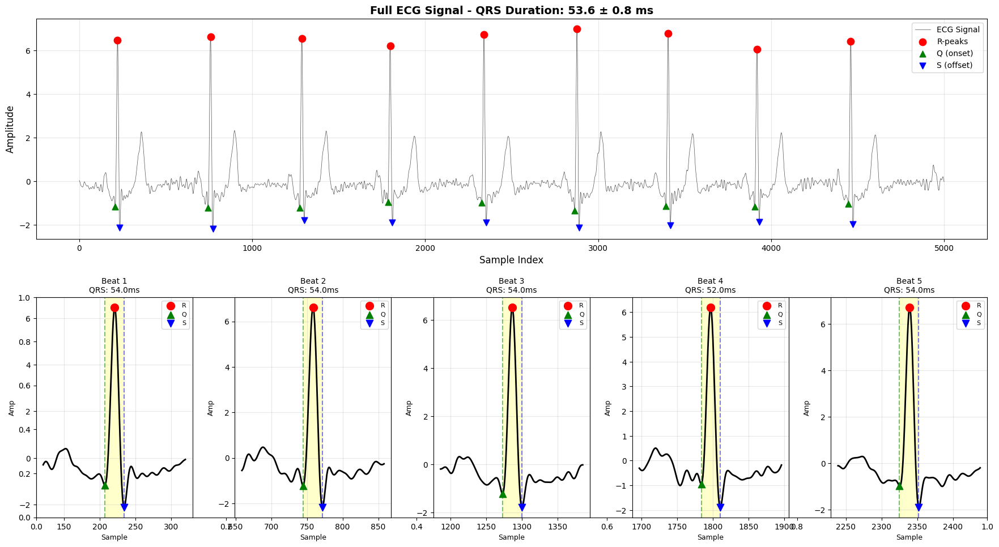


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9


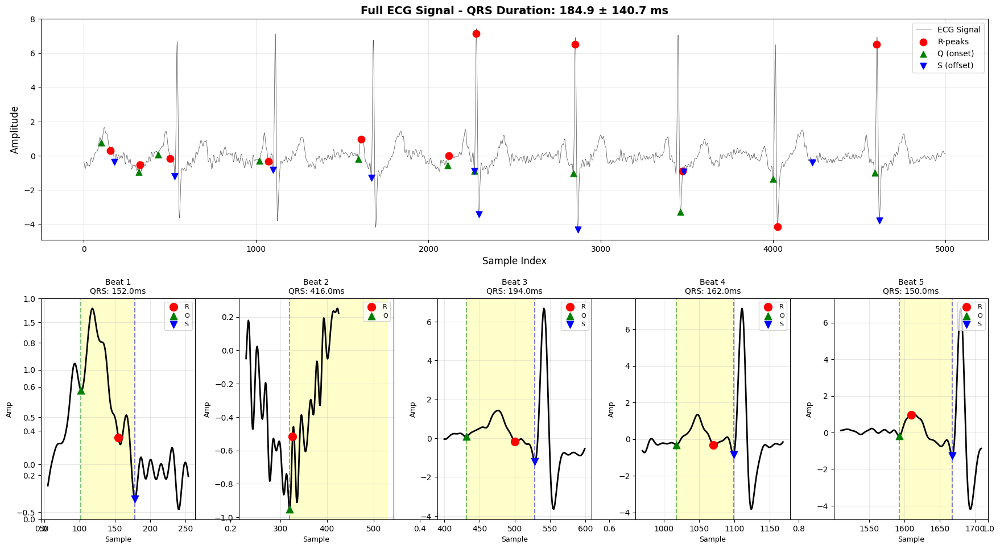

✅ Valid Q-peaks detected: 9

📊 QRS DELINEATION STATISTICS
============================================================✅ Valid S-peaks detected: 9


📏 QRS Duration:✅ Total R-peaks detected: 11


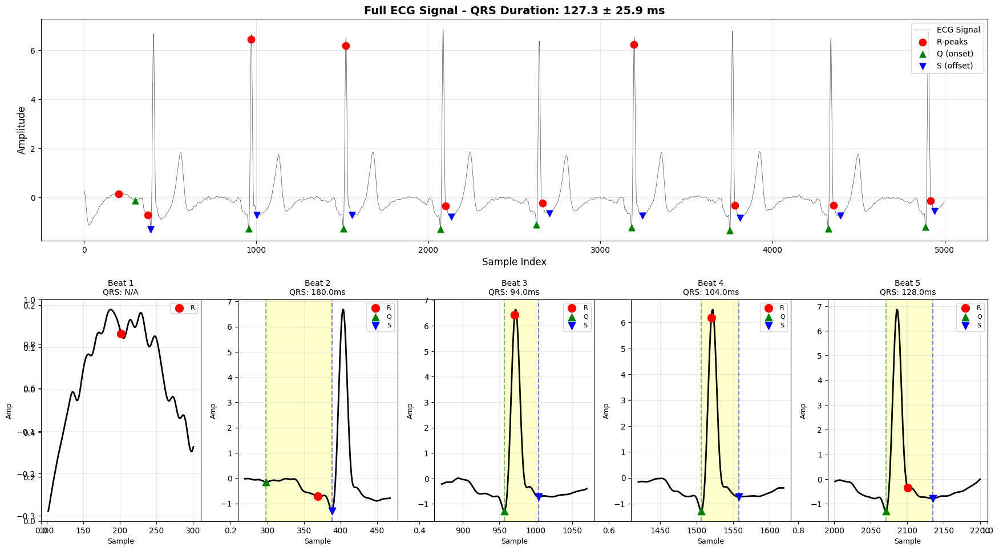


✅ Valid Q-peaks detected: 11
============================================================   Mean: 53.56 ms


✅ Valid S-peaks detected: 11   Std:  0.83 ms
📊 QRS DELINEATION STATISTICS

📏 QRS Duration:

✅ QRS duration is NORMAL (60-100ms expected)
   Mean: 184.91 ms============================================================


   Std:  140.73 ms✅ Total R-peaks detected: 10


⚠️  WARNING: QRS duration > 120ms

   ⚠️  High STD (140.7ms) → Possibly NOISE or detection error✅ Valid Q-peaks detected: 9

✅ Valid S-peaks detected: 10


📏 QRS Duration:
   Mean: 127.33 ms
   Std:  25.91 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (25.9ms) → Possibly NOISE or detection error

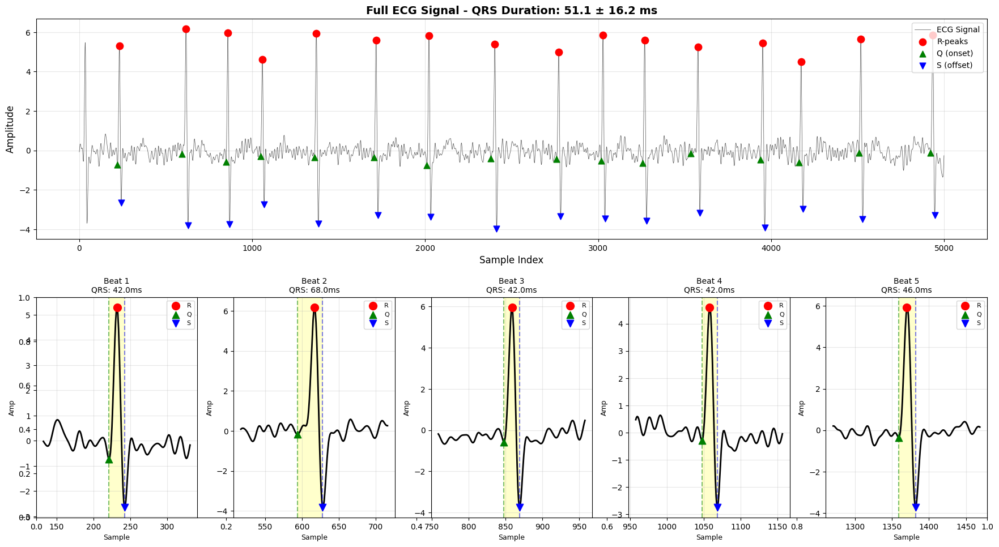

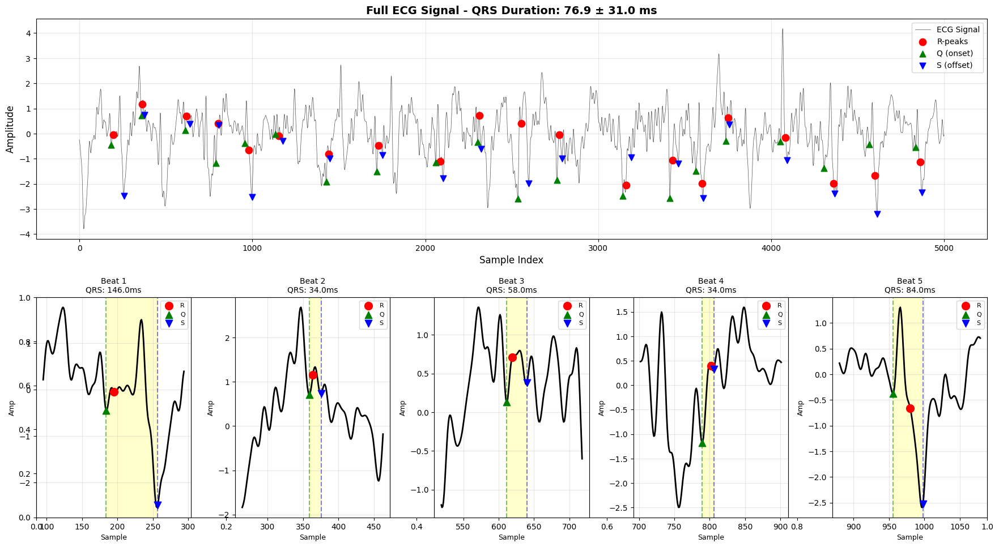

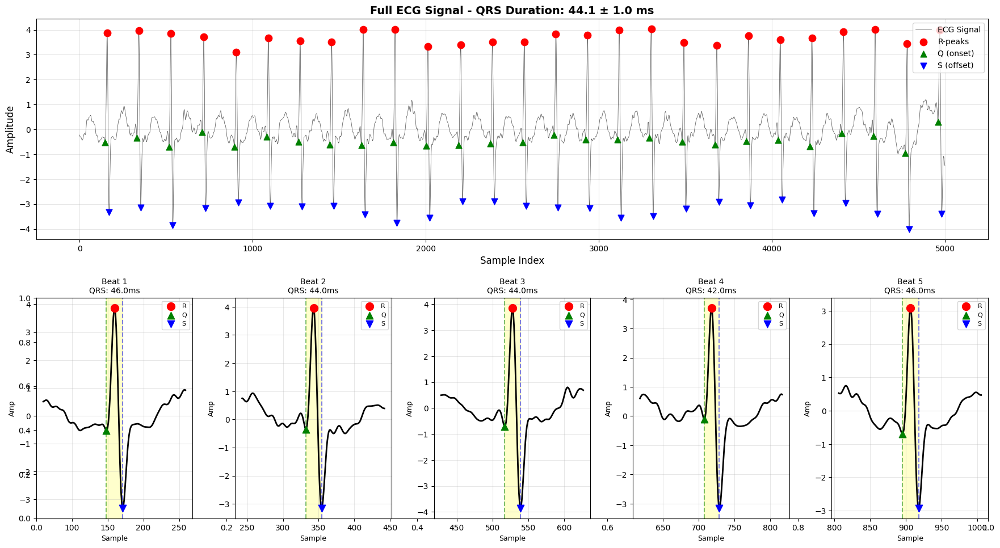


📊 QRS DELINEATION STATISTICS

📊 QRS DELINEATION STATISTICS============================================================


📊 QRS DELINEATION STATISTICS============================================================

✅ Total R-peaks detected: 16
============================================================✅ Total R-peaks detected: 20✅ Valid Q-peaks detected: 16


✅ Valid S-peaks detected: 16✅ Total R-peaks detected: 27✅ Valid Q-peaks detected: 20



📏 QRS Duration:✅ Valid S-peaks detected: 20✅ Valid Q-peaks detected: 27


✅ Valid S-peaks detected: 27   Mean: 51.12 ms
📏 QRS Duration:


   Std:  16.20 ms
📏 QRS Duration:   Mean: 76.90 ms


✅ QRS duration is NORMAL (60-100ms expected)   Mean: 44.07 ms


   Std:  31.04 ms============================================================
   Std:  1.02 ms



✅ QRS duration is NORMAL (60-100ms expected)

✅ QRS duration is NORMAL (60-100ms expected)============================================================



II
II
II
II
II
II


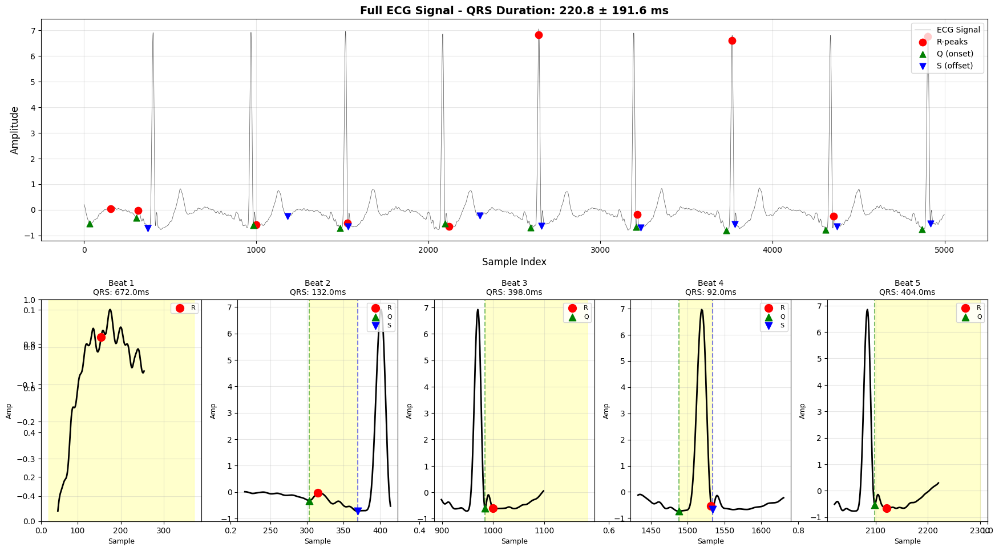


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 220.80 ms
   Std:  191.60 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (191.6ms) → Possibly NOISE or detection error



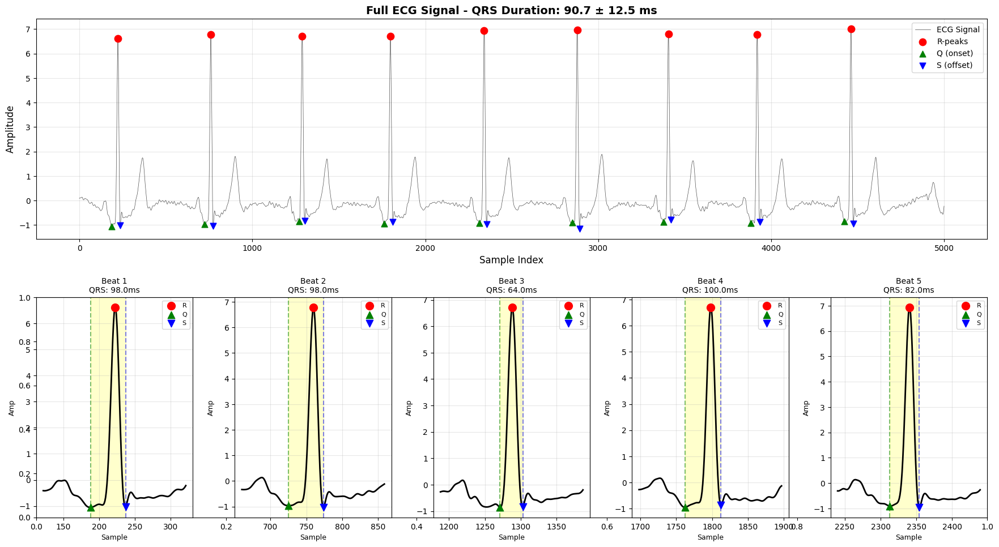


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 90.67 ms
   Std:  12.47 ms

✅ QRS duration is NORMAL (60-100ms expected)



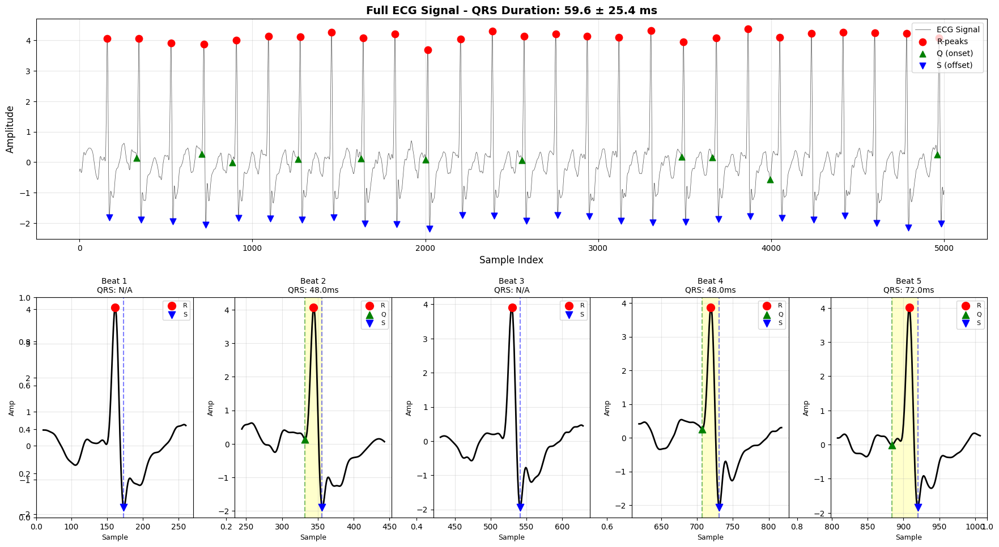


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 59.64 ms
   Std:  25.38 ms

✅ QRS duration is NORMAL (60-100ms expected)



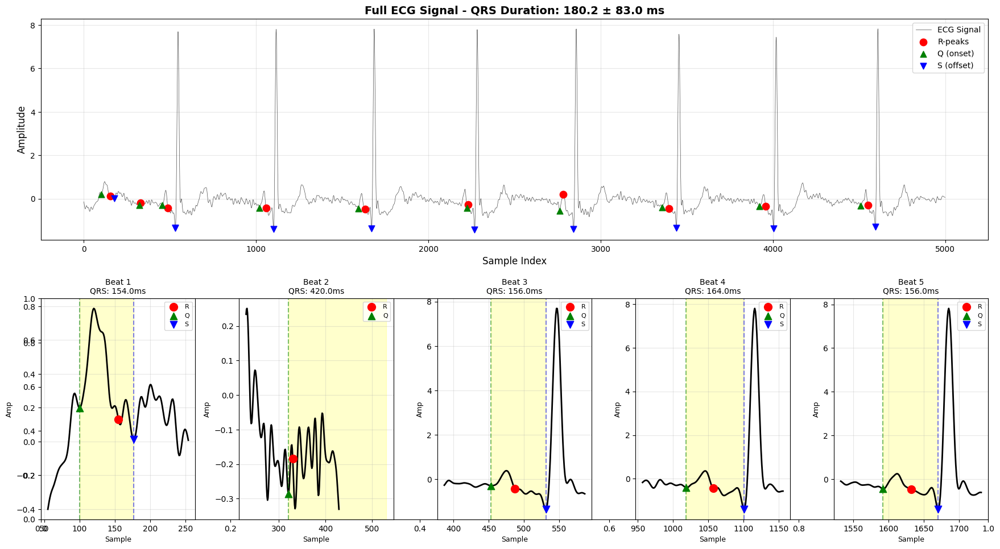


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 180.20 ms
   Std:  83.04 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (83.0ms) → Possibly NOISE or detection error



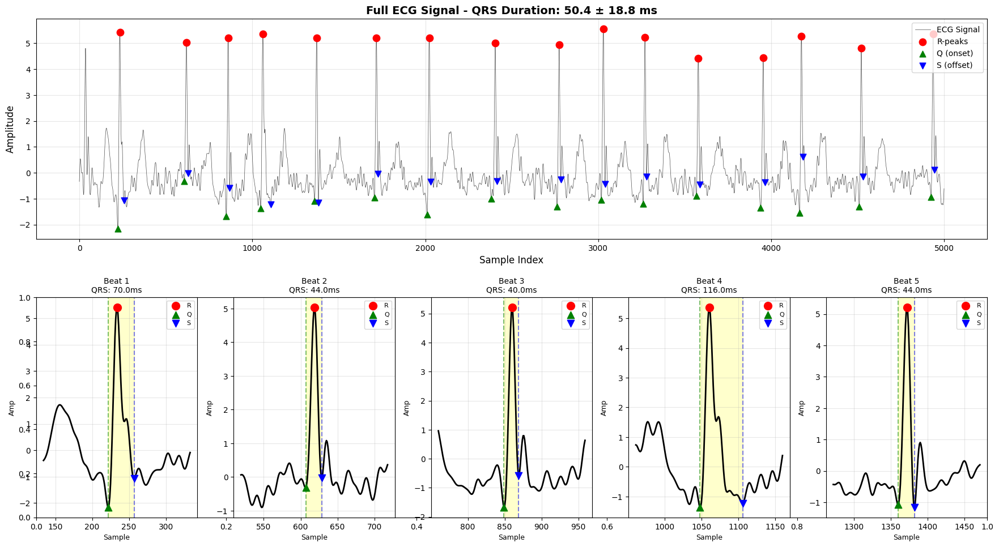

III

📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 16


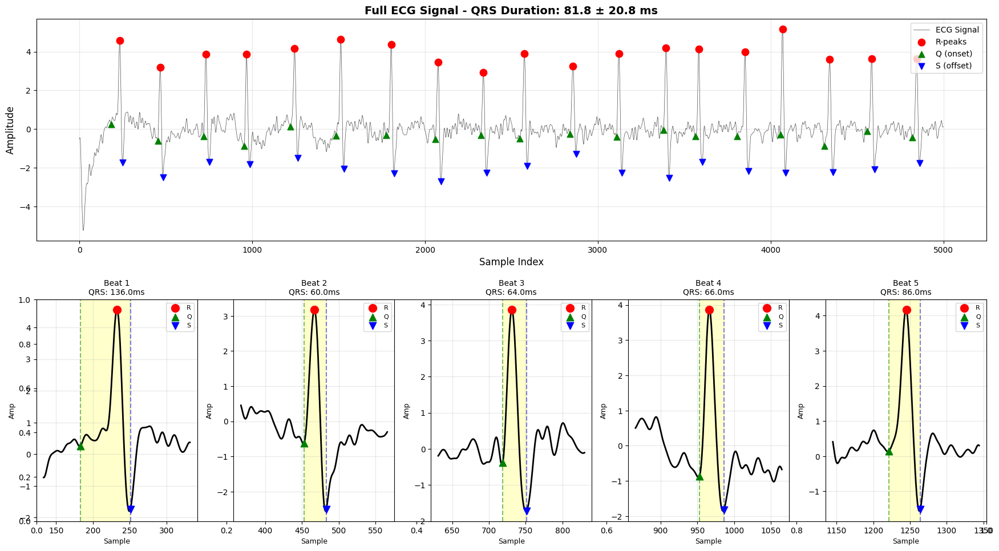

✅ Valid Q-peaks detected: 16
✅ Valid S-peaks detected: 16

📊 QRS DELINEATION STATISTICS
📏 QRS Duration:

✅ Total R-peaks detected: 19
   Mean: 50.38 ms✅ Valid Q-peaks detected: 19

✅ Valid S-peaks detected: 19   Std:  18.84 ms


📏 QRS Duration:
✅ QRS duration is NORMAL (60-100ms expected)

   Mean: 81.79 ms

   Std:  20.79 ms

✅ QRS duration is NORMAL (60-100ms expected)

III
IIIIII

III
III


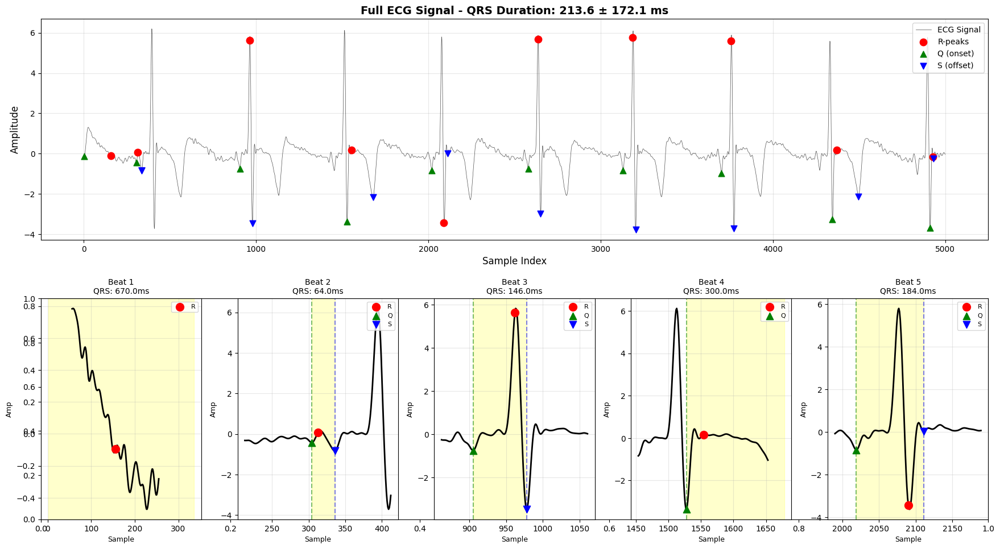


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 213.60 ms
   Std:  172.09 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (172.1ms) → Possibly NOISE or detection error

aVR


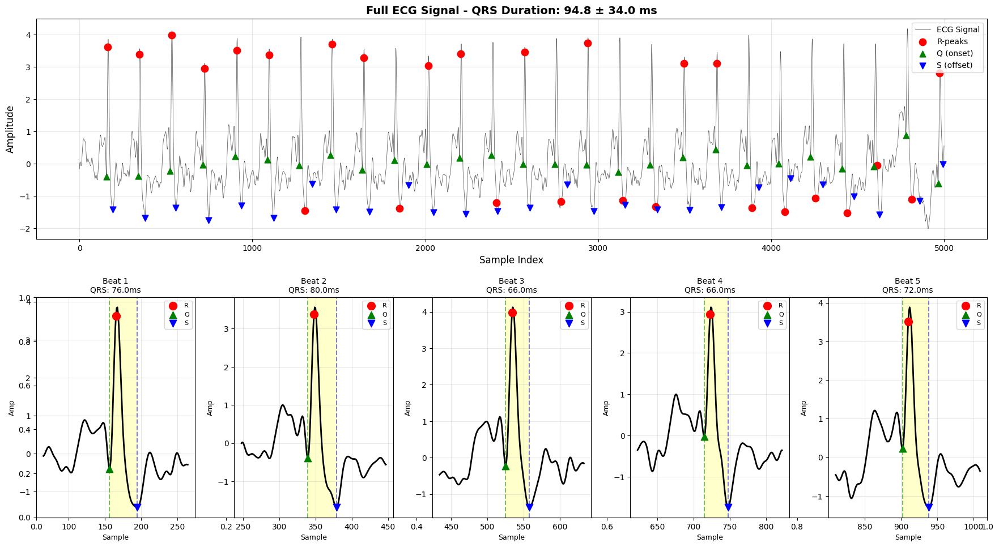

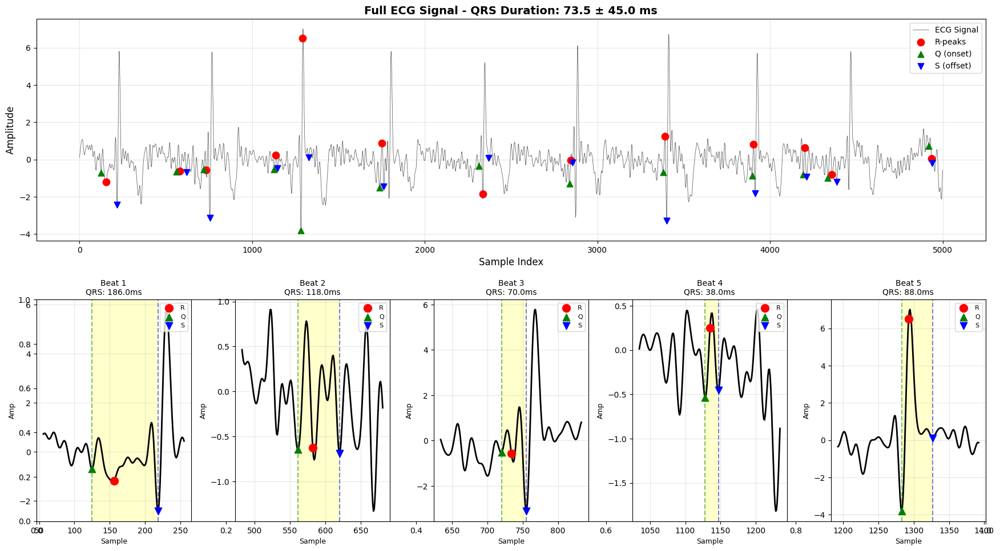


📊 QRS DELINEATION STATISTICS

📊 QRS DELINEATION STATISTICS============================================================

============================================================✅ Total R-peaks detected: 27

✅ Total R-peaks detected: 13✅ Valid Q-peaks detected: 27
✅ Valid Q-peaks detected: 13

✅ Valid S-peaks detected: 27✅ Valid S-peaks detected: 13


📏 QRS Duration:
📏 QRS Duration:
   Mean: 94.81 ms


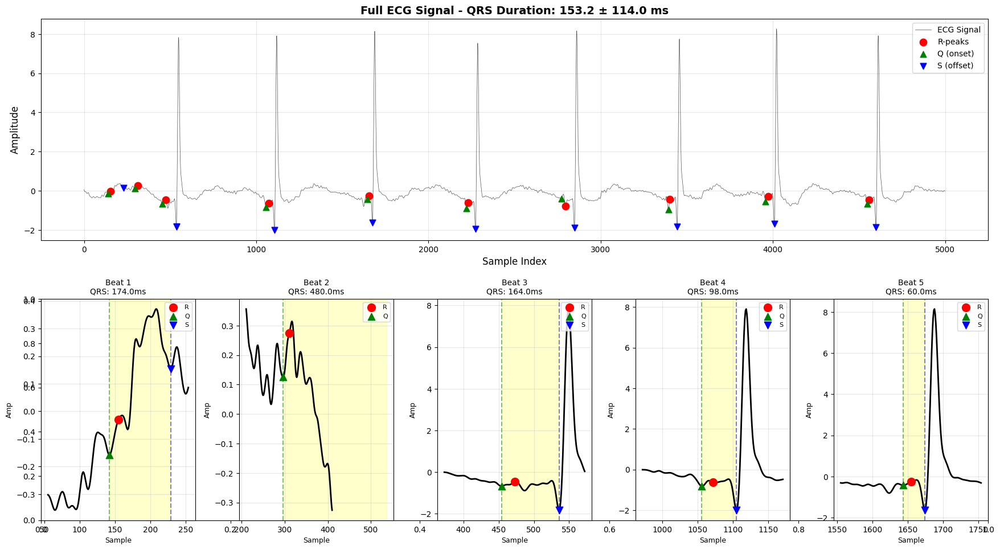


   Mean: 73.54 ms
============================================================   Std:  33.99 ms

   Std:  45.03 ms📊 QRS DELINEATION STATISTICS

✅ QRS duration is NORMAL (60-100ms expected)


✅ QRS duration is NORMAL (60-100ms expected)


✅ Total R-peaks detected: 10

✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 153.20 ms
   Std:  114.01 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (114.0ms) → Possibly NOISE or detection error



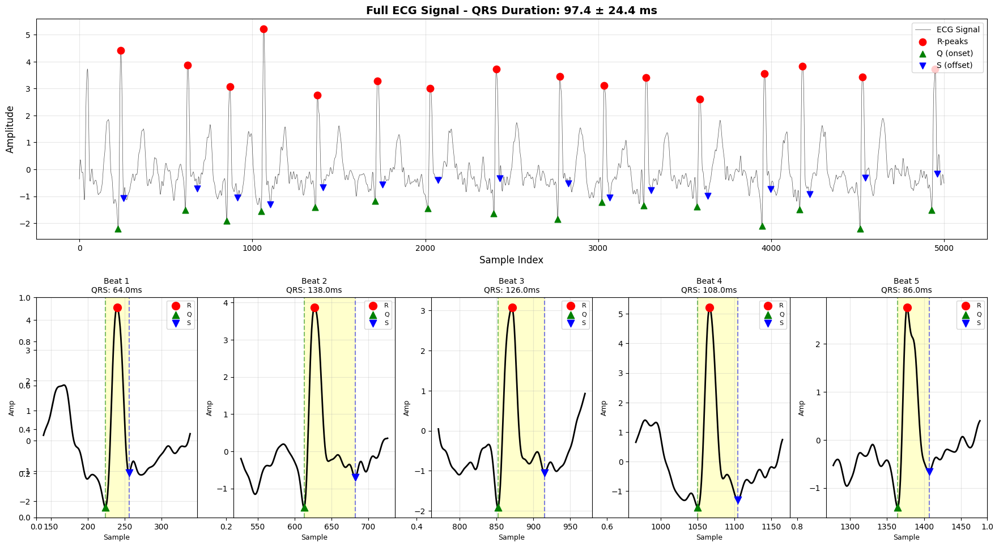


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 16
✅ Valid Q-peaks detected: 16
✅ Valid S-peaks detected: 16

📏 QRS Duration:aVR
   Mean: 97.38 ms

   Std:  24.41 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVR
aVR


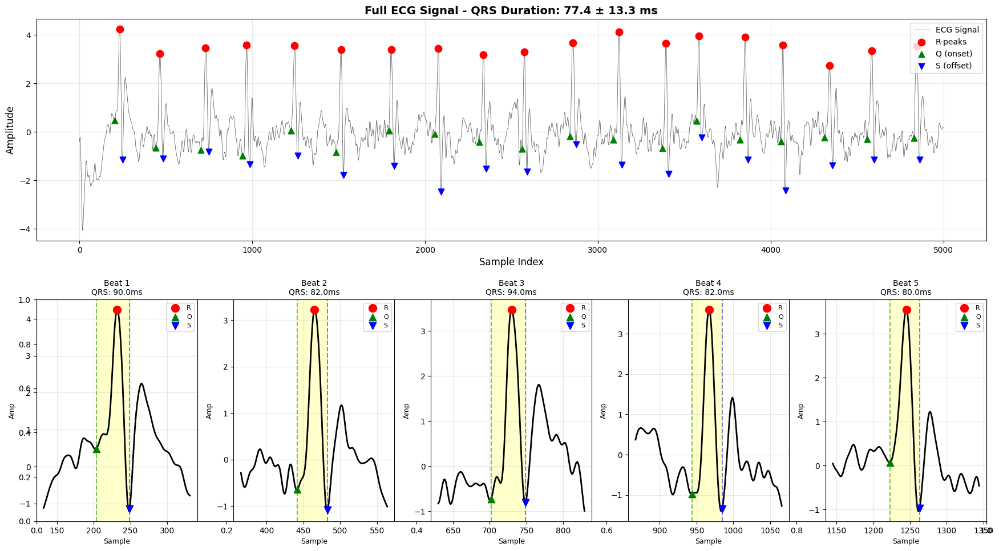


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 19
✅ Valid Q-peaks detected: 19
✅ Valid S-peaks detected: 19

📏 QRS Duration:
   Mean: 77.37 ms
   Std:  13.30 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVR
aVR


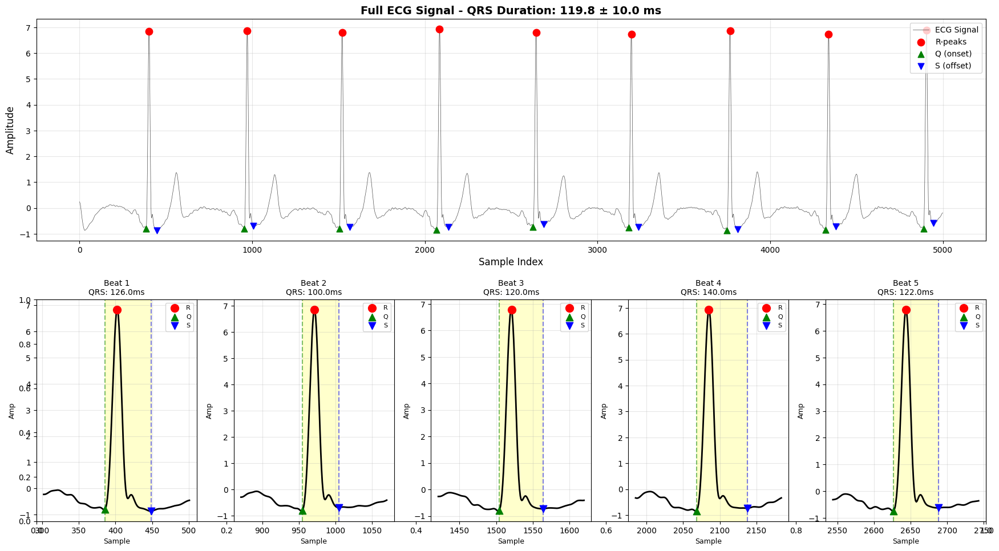


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 119.78 ms
   Std:  10.00 ms

✅ QRS duration is NORMAL (60-100ms expected)



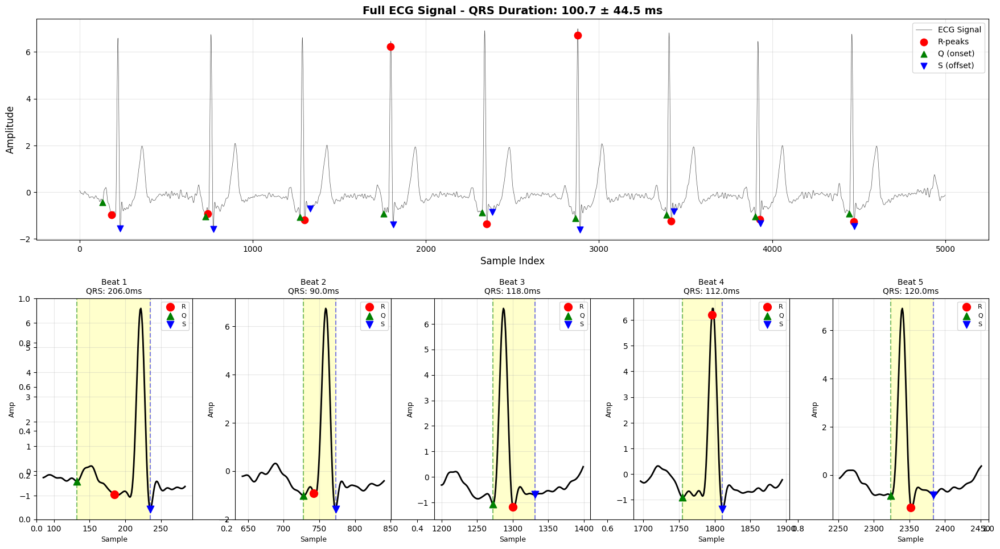


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 100.67 ms
   Std:  44.48 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVL


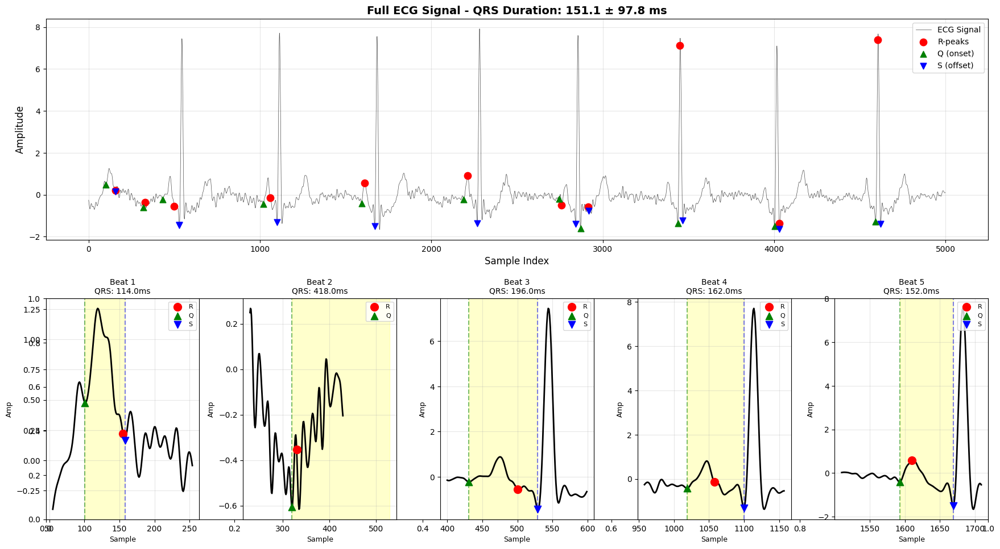


📊 QRS DELINEATION STATISTICS
✅ Valid Q-peaks detected: 11
✅ Total R-peaks detected: 11

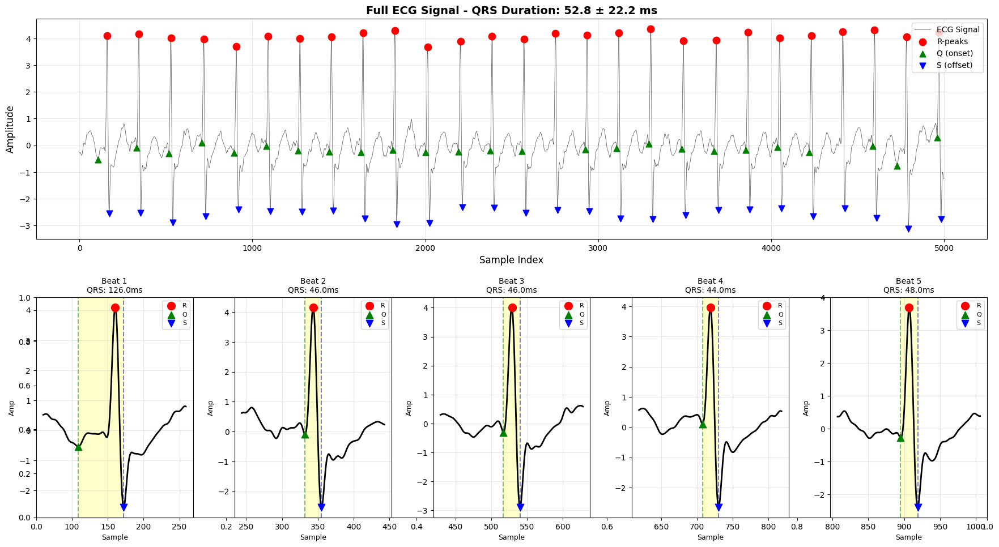


✅ Valid S-peaks detected: 11


📏 QRS Duration:📊 QRS DELINEATION STATISTICS


   Mean: 151.09 ms============================================================   Std:  97.82 ms


⚠️  WARNING: QRS duration > 120ms
✅ Total R-peaks detected: 27   ⚠️  High STD (97.8ms) → Possibly NOISE or detection error

✅ Valid Q-peaks detected: 25============================================================


✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 52.80 ms
   Std:  22.20 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVL


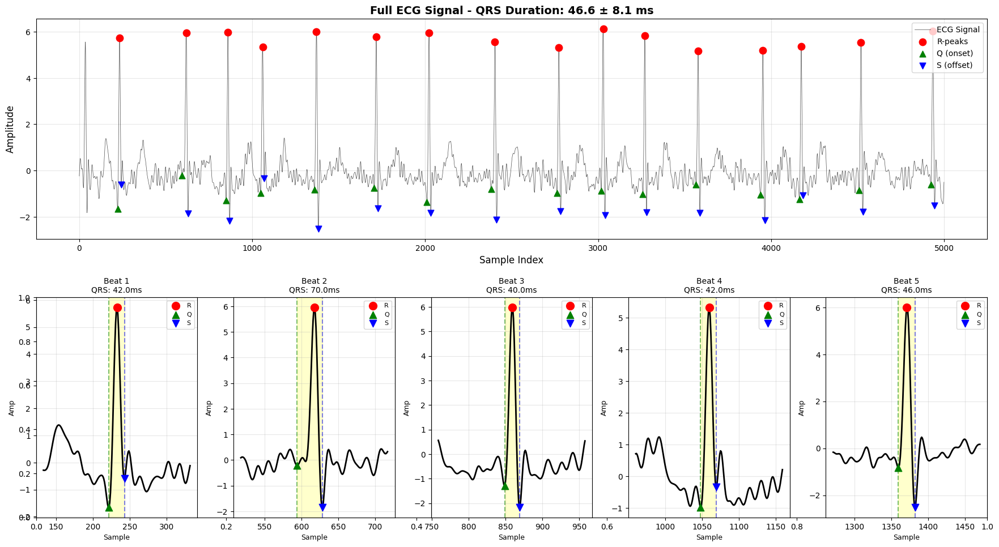


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 16
✅ Valid Q-peaks detected: 16
✅ Valid S-peaks detected: 16

📏 QRS Duration:
   Mean: 46.62 ms
   Std:  8.05 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVL
aVL


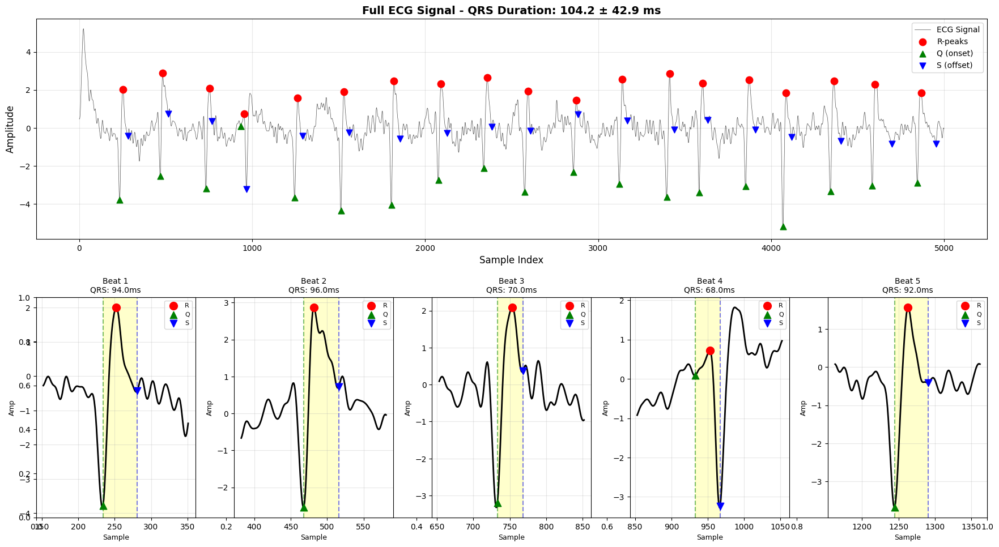


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 19
✅ Valid Q-peaks detected: 19
✅ Valid S-peaks detected: 19

📏 QRS Duration:
   Mean: 104.21 ms
   Std:  42.92 ms

✅ QRS duration is NORMAL (60-100ms expected)aVL


aVL


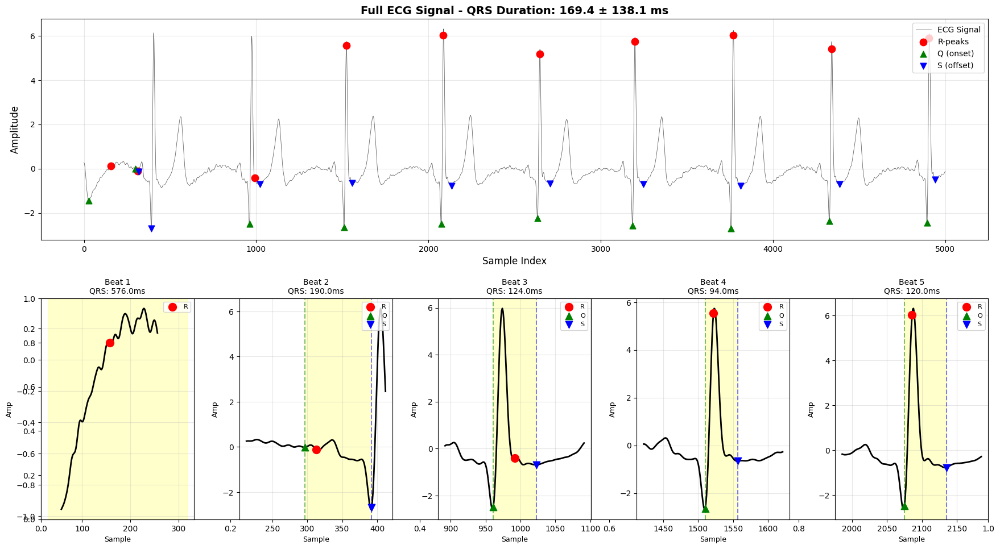


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 169.40 ms
   Std:  138.08 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (138.1ms) → Possibly NOISE or detection error

aVF

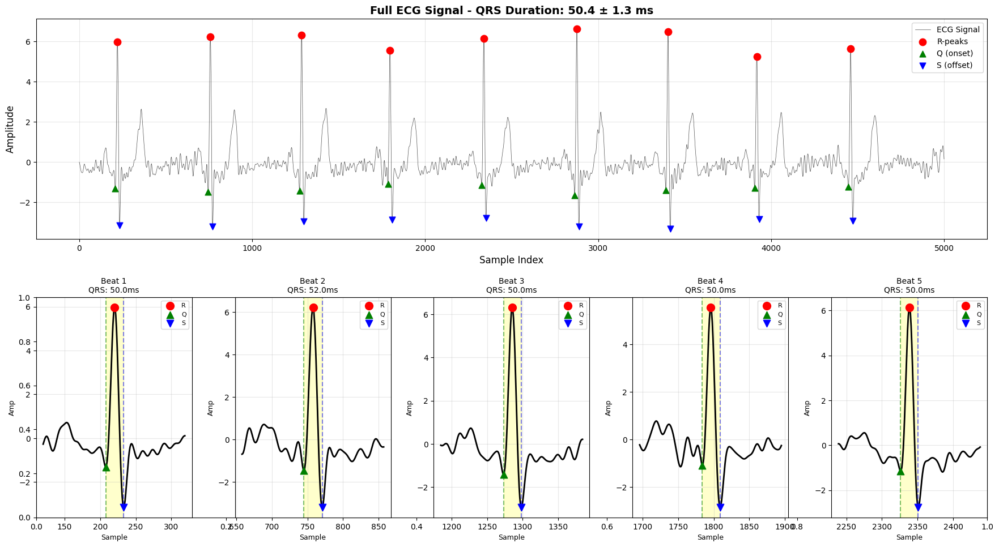



📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 50.44 ms
   Std:  1.26 ms

✅ QRS duration is NORMAL (60-100ms expected)



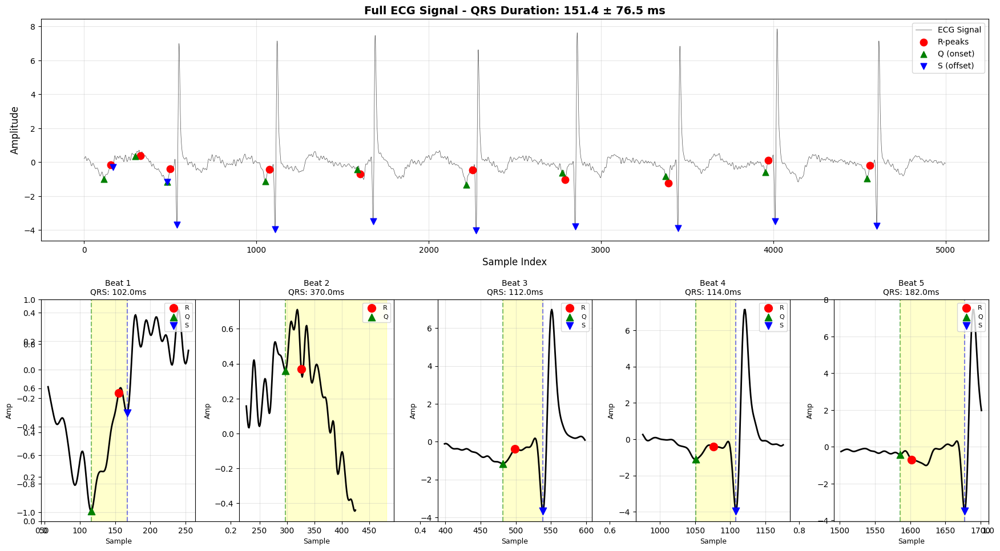


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 151.40 msaVF

   Std:  76.52 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (76.5ms) → Possibly NOISE or detection error



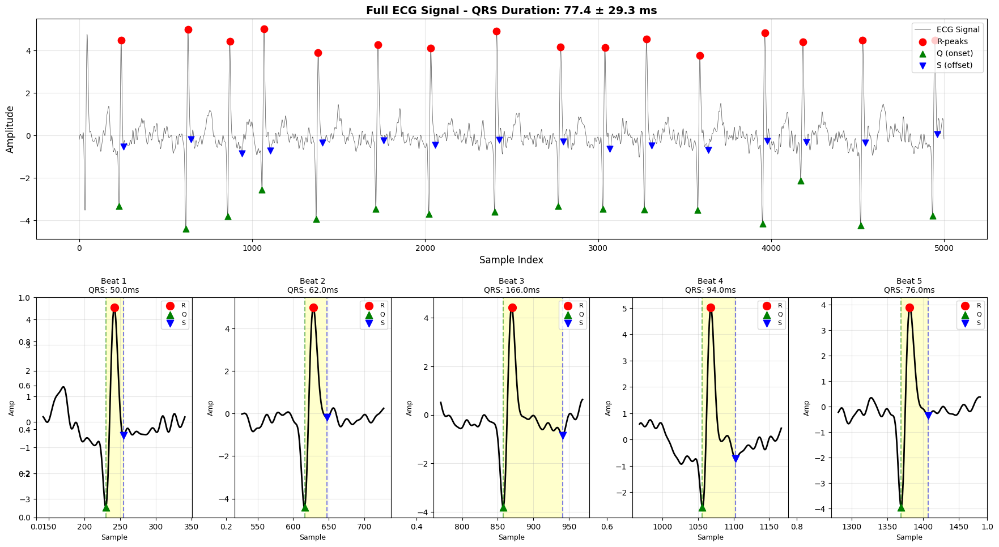


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 16
✅ Valid Q-peaks detected: 16
✅ Valid S-peaks detected: 16

📏 QRS Duration:
   Mean: 77.38 ms
   Std:  29.29 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVF


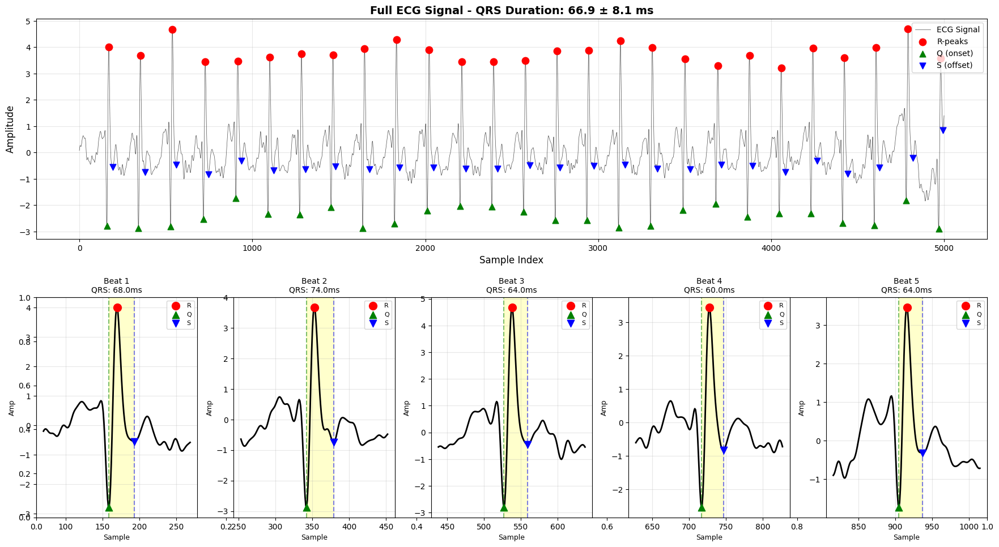


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 27
✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 66.89 ms
   Std:  8.10 ms

✅ QRS duration is NORMAL (60-100ms expected)



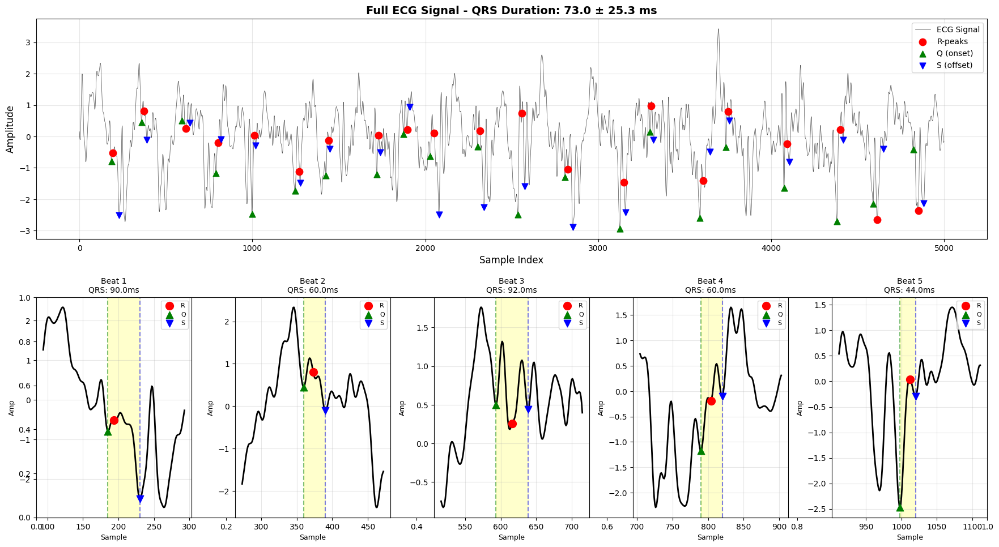


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 21
✅ Valid Q-peaks detected: 21
✅ Valid S-peaks detected: 21

📏 QRS Duration:
   Mean: 73.05 ms
   Std:  25.34 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVF
aVF
aVF


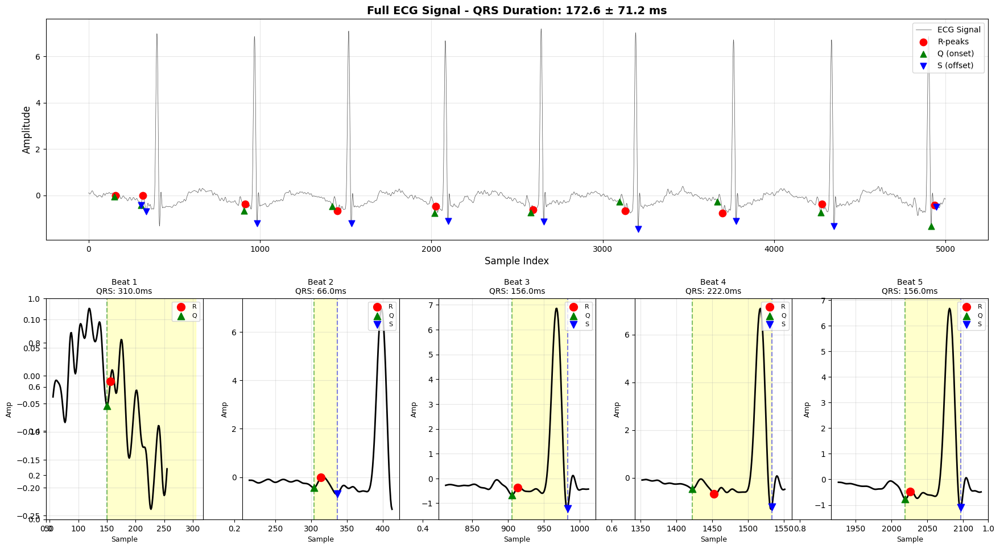


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 172.60 ms
   Std:  71.21 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (71.2ms) → Possibly NOISE or detection error

V1


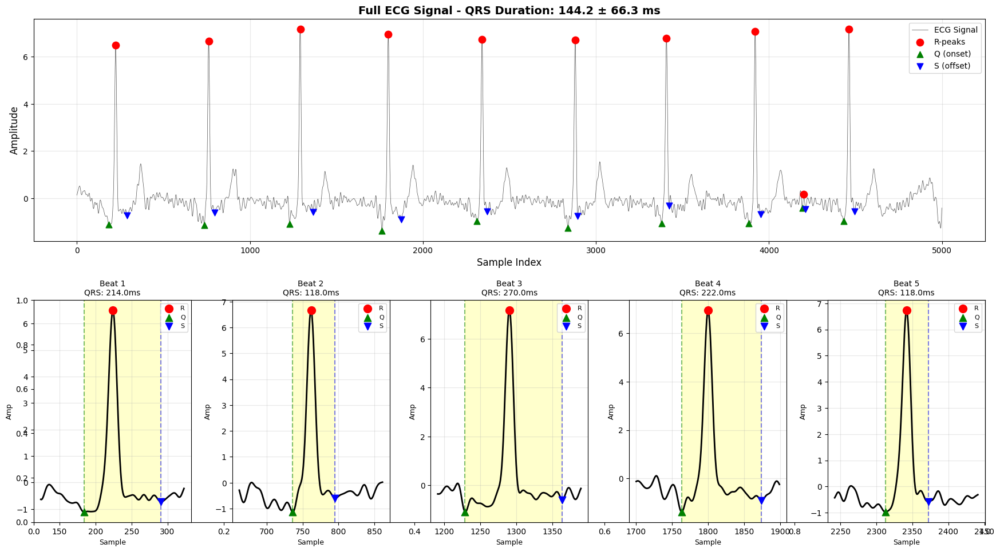


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 144.20 ms
   Std:  66.26 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (66.3ms) → Possibly NOISE or detection error

V1


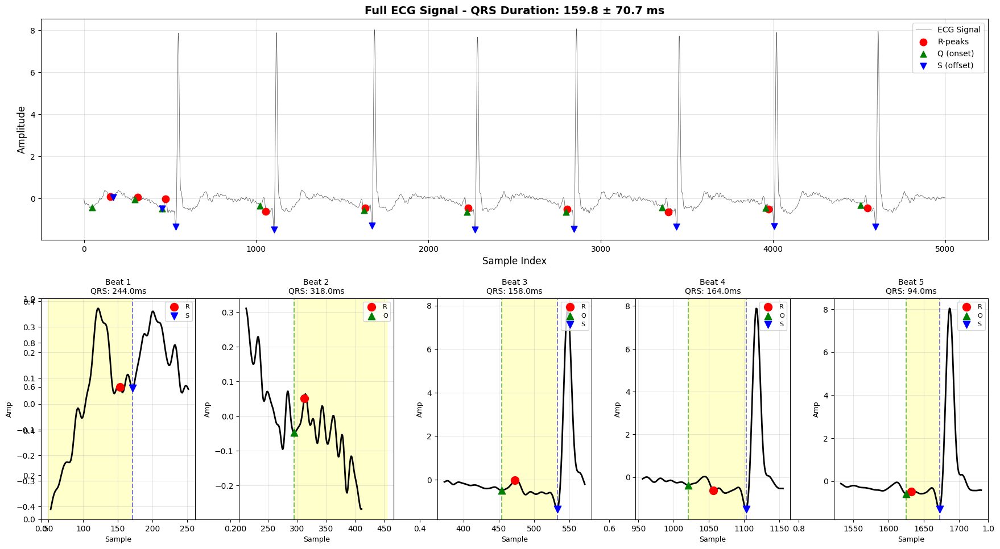


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 159.80 ms
   Std:  70.68 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (70.7ms) → Possibly NOISE or detection error

V1


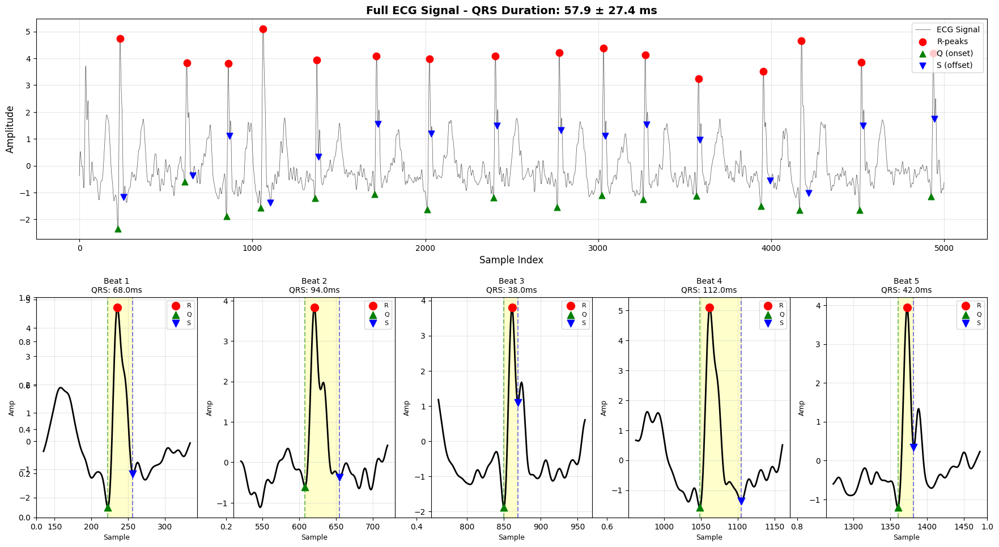


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 16
✅ Valid Q-peaks detected: 16
✅ Valid S-peaks detected: 16

📏 QRS Duration:
   Mean: 57.88 ms
   Std:  27.39 ms

✅ QRS duration is NORMAL (60-100ms expected)


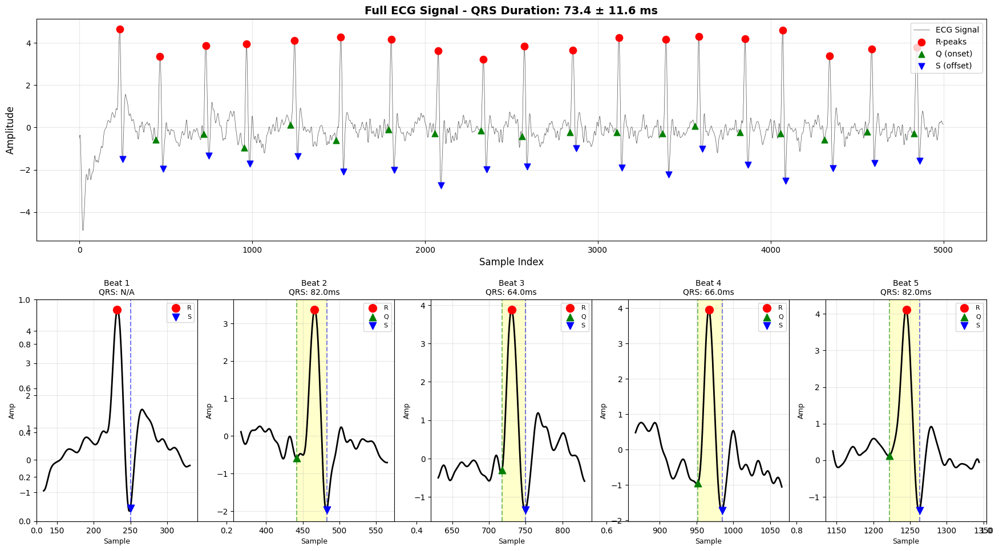



📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 19
✅ Valid Q-peaks detected: 18
✅ Valid S-peaks detected: 19

📏 QRS Duration:
   Mean: 73.44 ms
   Std:  11.62 ms

✅ QRS duration is NORMAL (60-100ms expected)



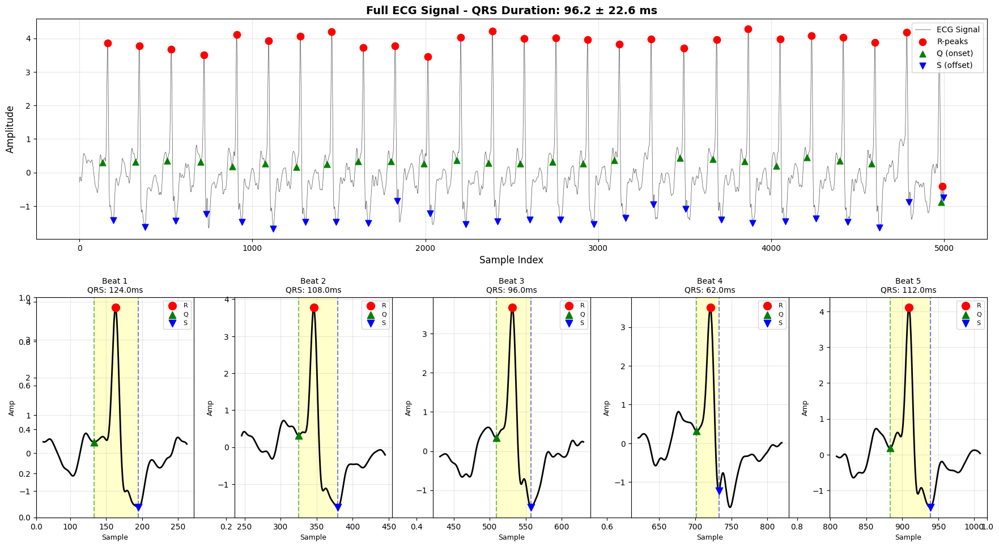


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 25
✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 96.16 ms
   Std:  22.59 ms

✅ QRS duration is NORMAL (60-100ms expected)

V1
V1
V1


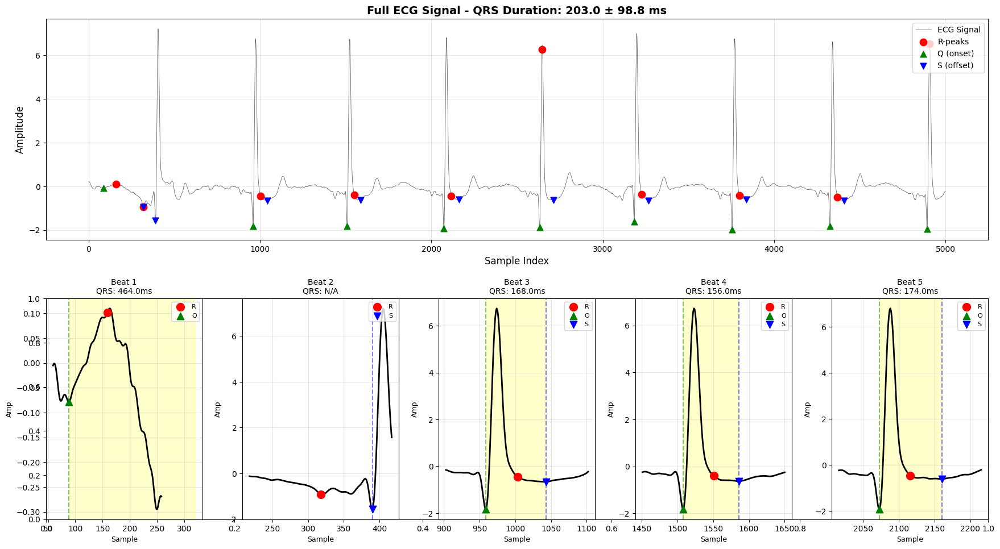


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 203.00 ms
   Std:  98.78 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (98.8ms) → Possibly NOISE or detection error

V2


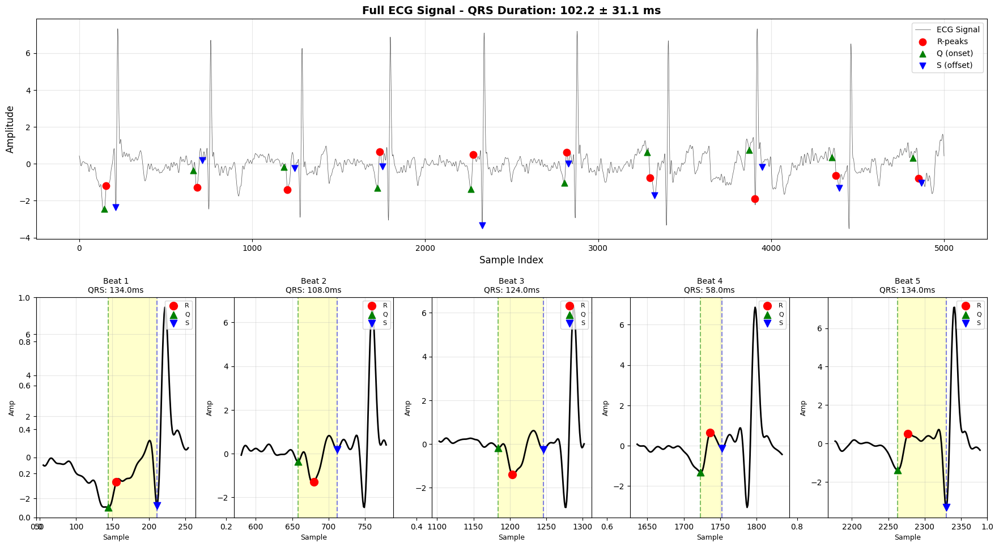


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 102.20 ms
   Std:  31.14 ms

✅ QRS duration is NORMAL (60-100ms expected)



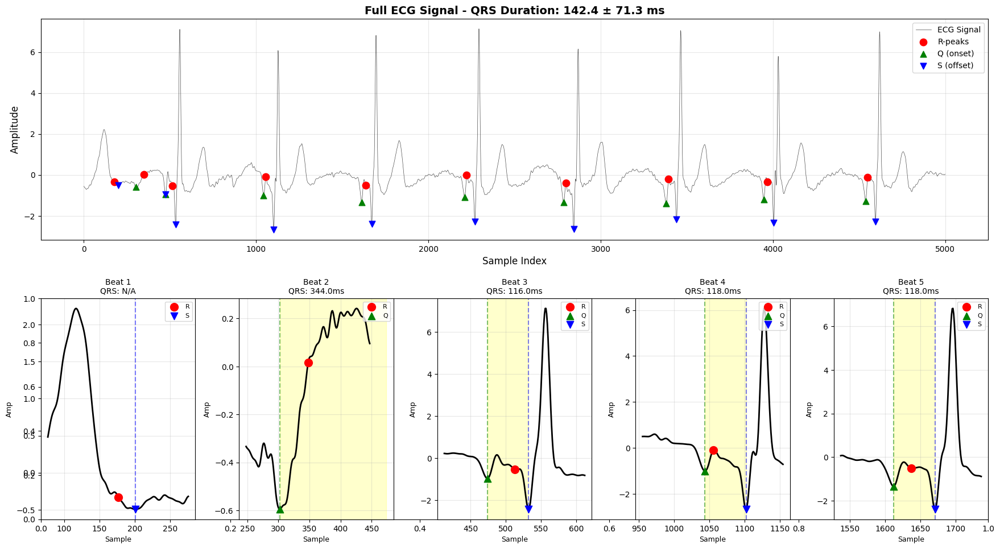


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 9
V2✅ Valid S-peaks detected: 10


📏 QRS Duration:
   Mean: 142.44 ms
   Std:  71.28 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (71.3ms) → Possibly NOISE or detection error

V2


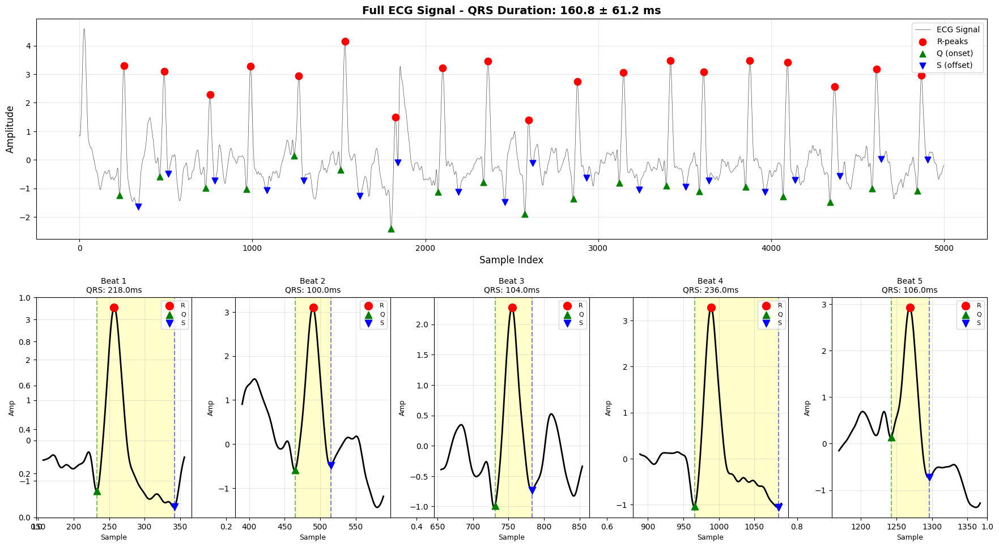


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 19
✅ Valid Q-peaks detected: 19
✅ Valid S-peaks detected: 19

📏 QRS Duration:
   Mean: 160.84 ms
   Std:  61.17 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (61.2ms) → Possibly NOISE or detection error



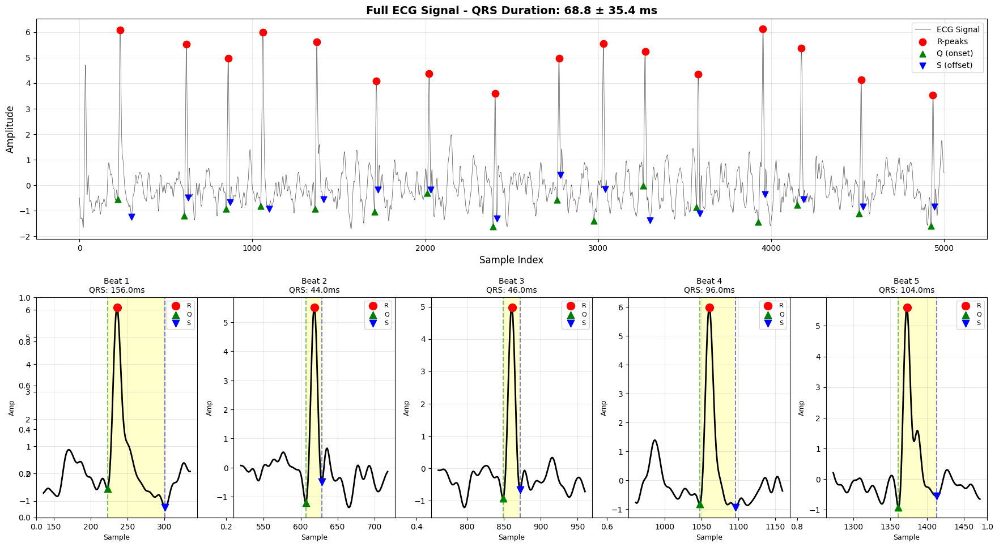


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 16
✅ Valid Q-peaks detected: 16
✅ Valid S-peaks detected: 16

📏 QRS Duration:
   Mean: 68.75 ms
   Std:  35.39 ms

✅ QRS duration is NORMAL (60-100ms expected)

V2


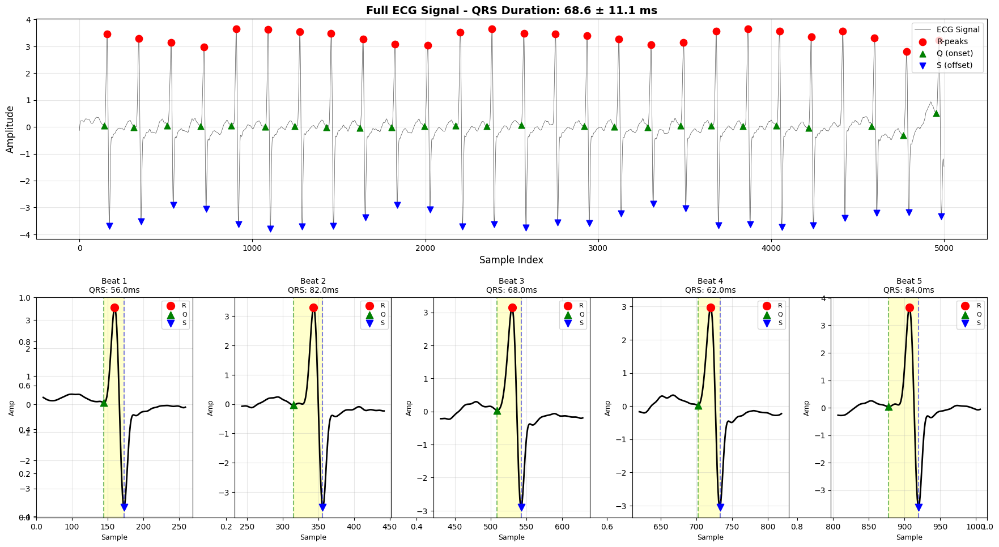


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 25
✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 68.56 ms
   Std:  11.06 ms

✅ QRS duration is NORMAL (60-100ms expected)

V2


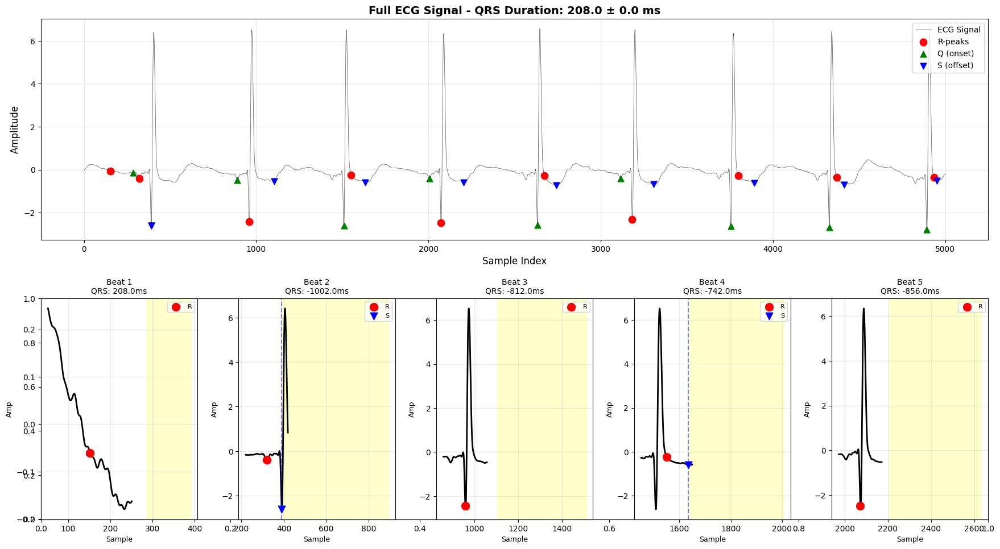


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 208.00 ms
   Std:  0.00 ms

⚠️  WARNING: QRS duration > 120ms
   ✅ Low STD (0.0ms) → Possibly real Bundle Branch Block

V2
V3


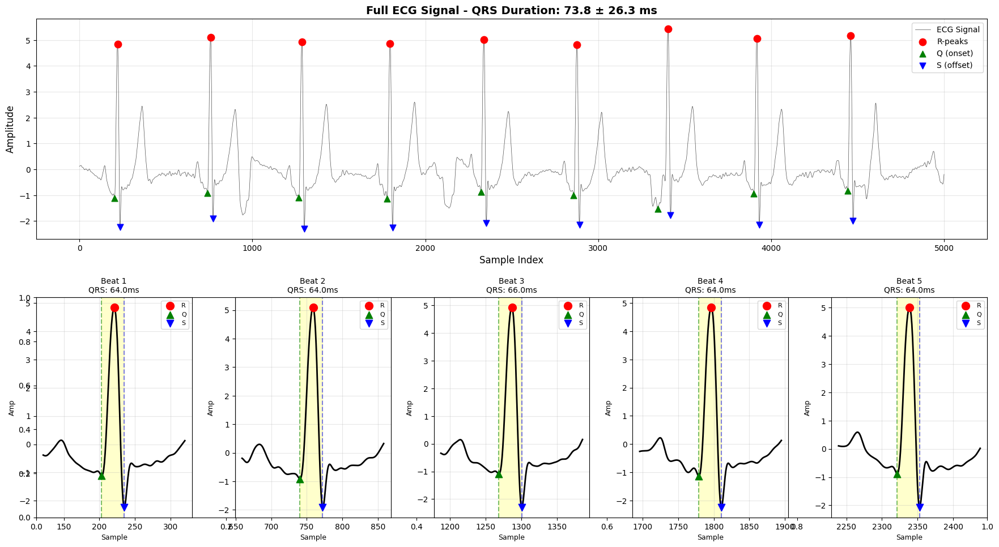


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 73.78 ms
   Std:  26.27 ms

✅ QRS duration is NORMAL (60-100ms expected)

V3


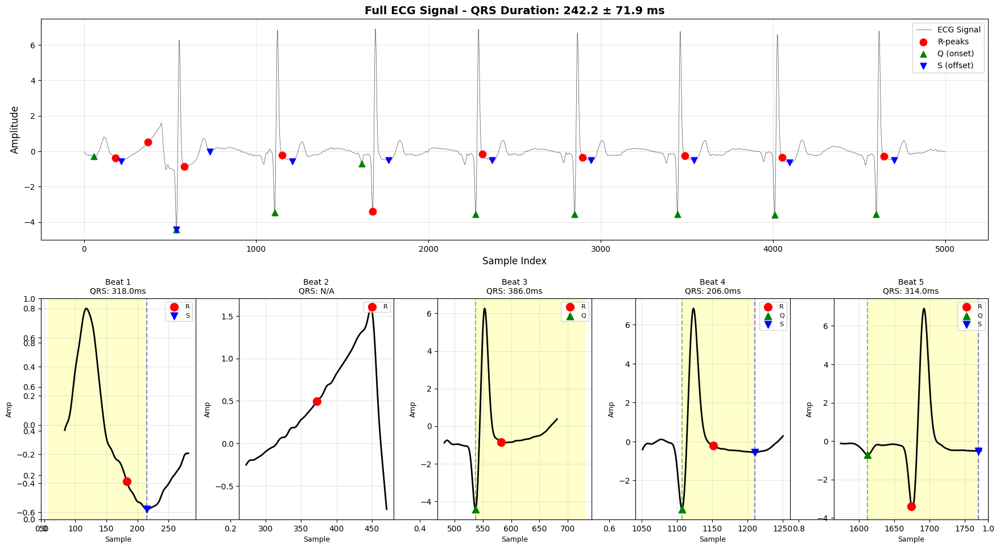


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 242.22 ms
   Std:  71.93 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (71.9ms) → Possibly NOISE or detection error

V3


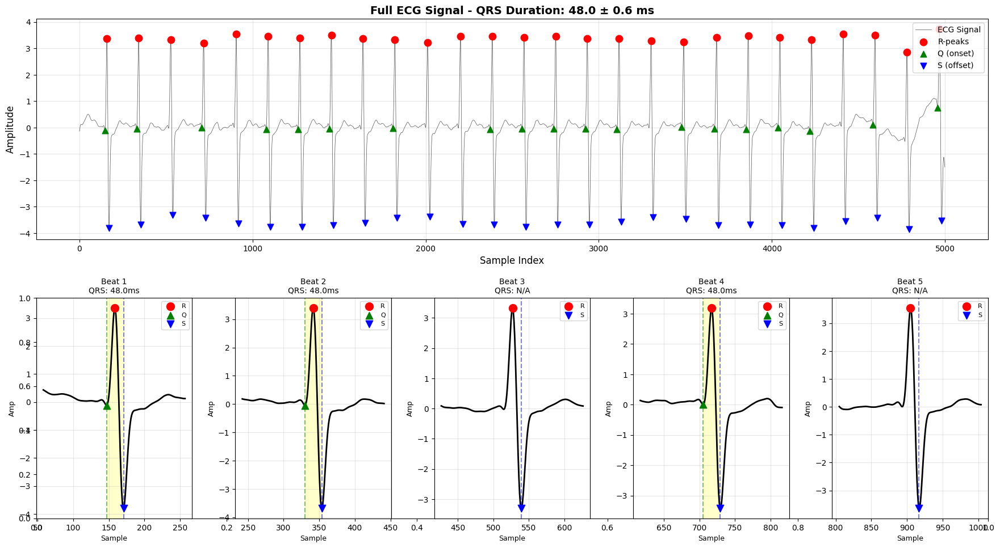

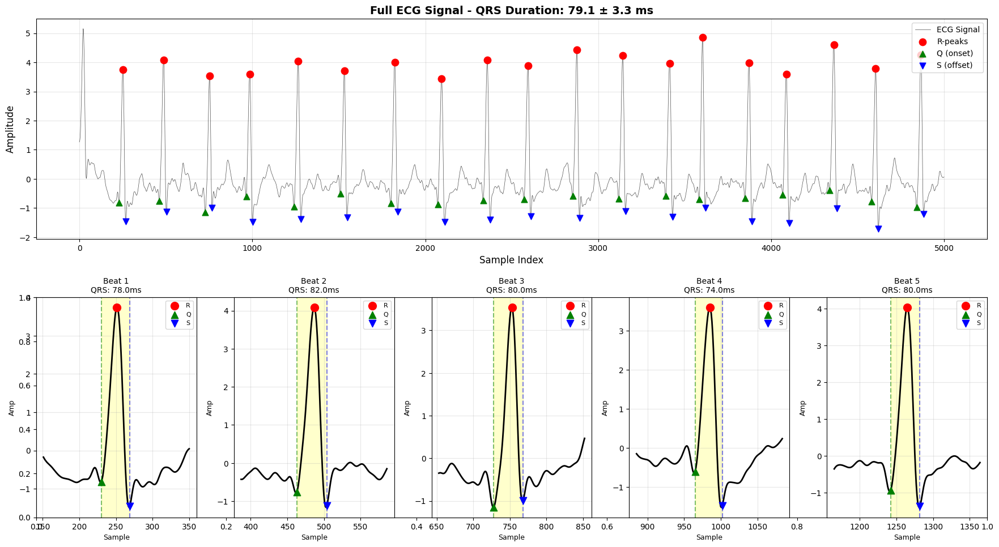


============================================================📊 QRS DELINEATION STATISTICS
📊 QRS DELINEATION STATISTICS

============================================================✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 19
✅ Total R-peaks detected: 19
✅ Valid S-peaks detected: 27

✅ Valid Q-peaks detected: 19
📏 QRS Duration:

✅ Valid S-peaks detected: 19   Mean: 48.00 ms



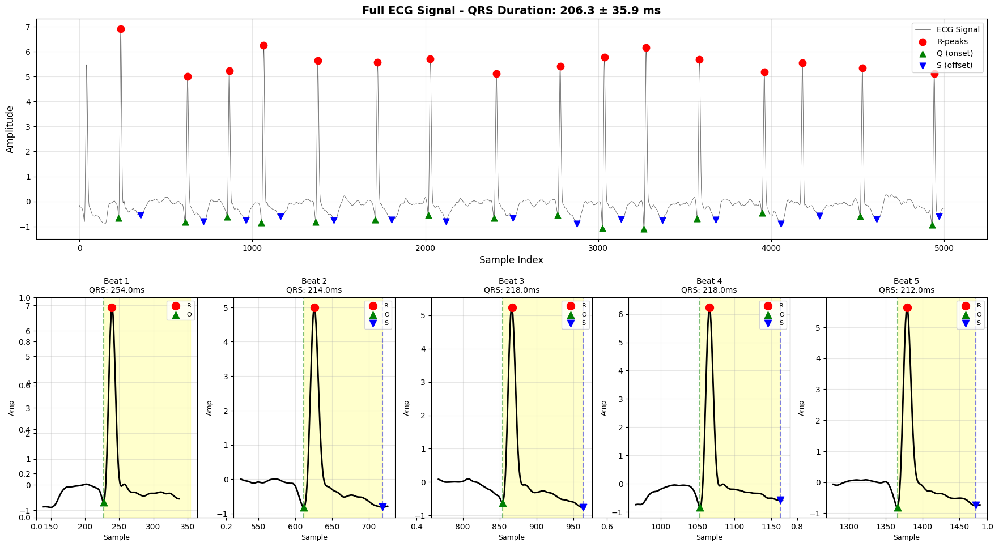


📏 QRS Duration:   Std:  0.65 ms


   Mean: 79.05 ms📊 QRS DELINEATION STATISTICS
✅ QRS duration is NORMAL (60-100ms expected)


   Std:  3.27 ms

✅ Total R-peaks detected: 16
✅ QRS duration is NORMAL (60-100ms expected)

✅ Valid Q-peaks detected: 15

✅ Valid S-peaks detected: 16

📏 QRS Duration:
   Mean: 206.27 ms
   Std:  35.92 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (35.9ms) → Possibly NOISE or detection error



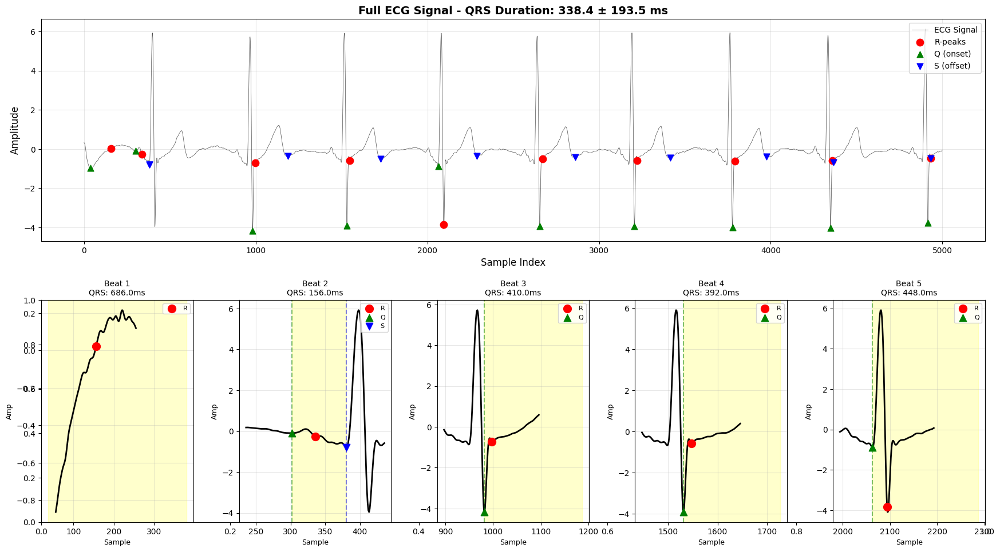


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 338.40 ms
   Std:  193.46 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (193.5ms) → Possibly NOISE or detection error

V4
V3
V3
V3


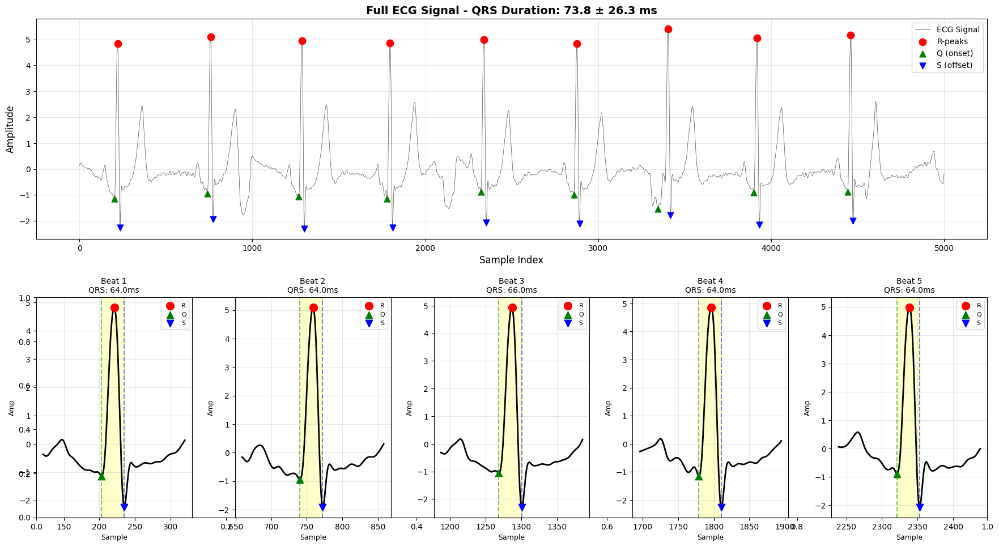


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 73.78 ms
   Std:  26.25 ms

✅ QRS duration is NORMAL (60-100ms expected)

V4


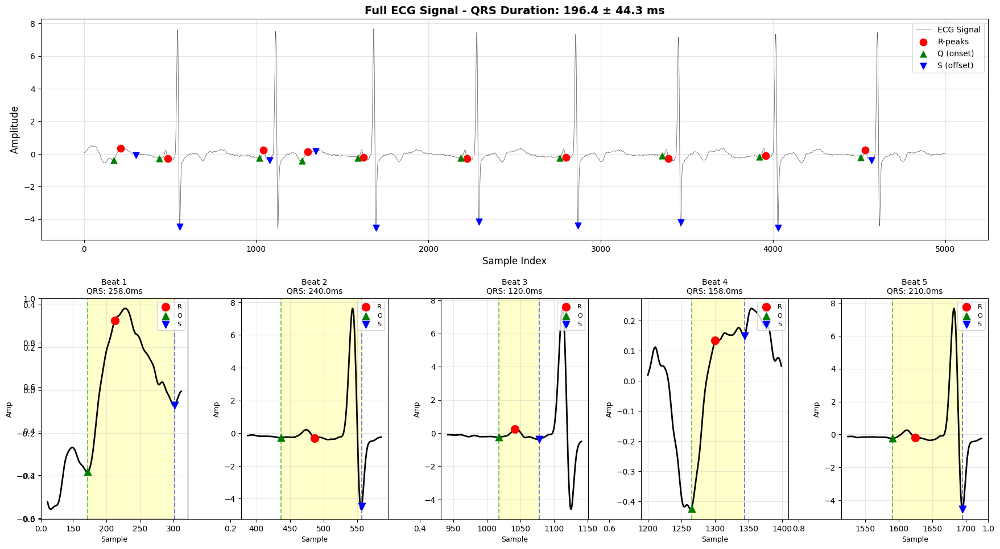


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 196.40 ms
   Std:  44.31 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (44.3ms) → Possibly NOISE or detection error

V4


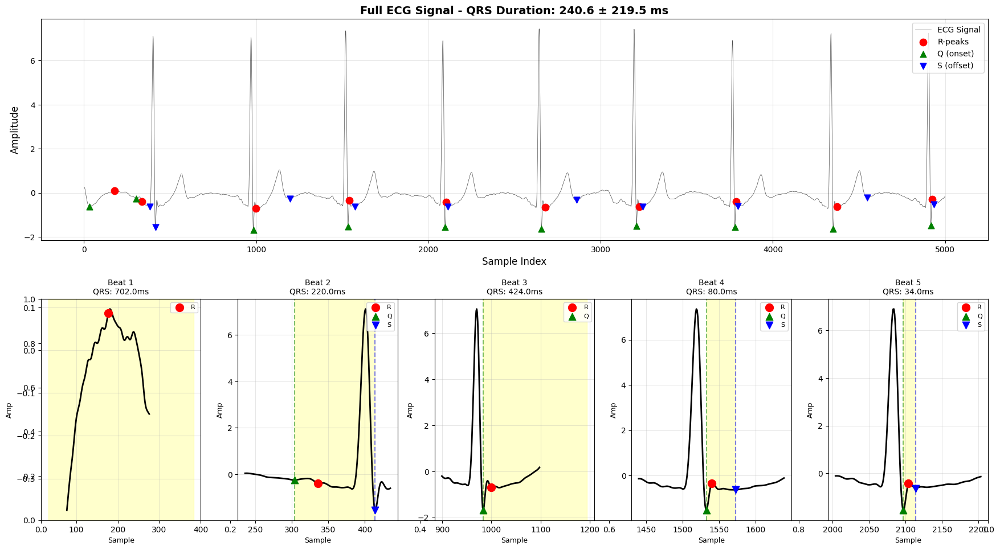

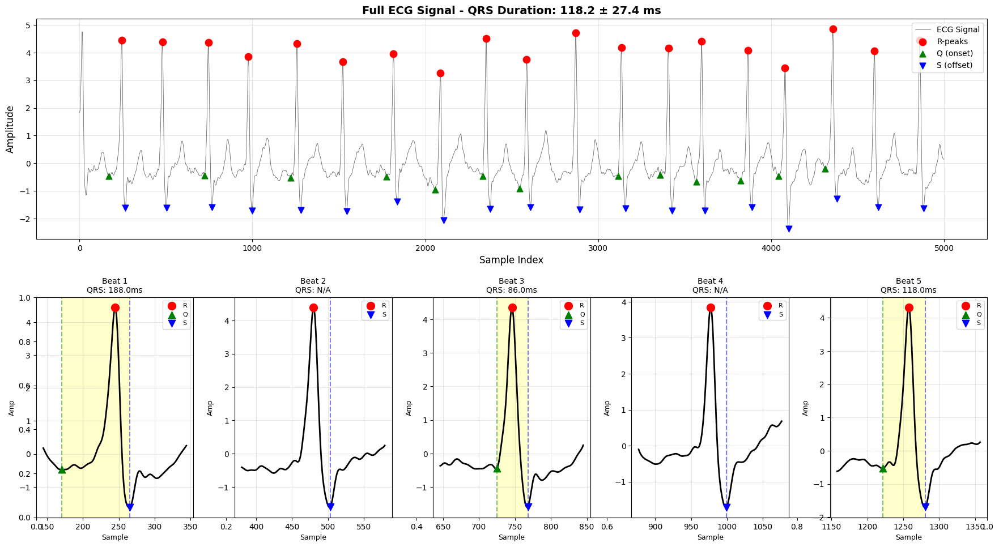



============================================================📊 QRS DELINEATION STATISTICS
📊 QRS DELINEATION STATISTICS

✅ Total R-peaks detected: 19

✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 13✅ Valid Q-peaks detected: 10

✅ Valid S-peaks detected: 10✅ Valid S-peaks detected: 19


📏 QRS Duration:
📏 QRS Duration:

   Mean: 240.60 ms
   Mean: 118.15 ms

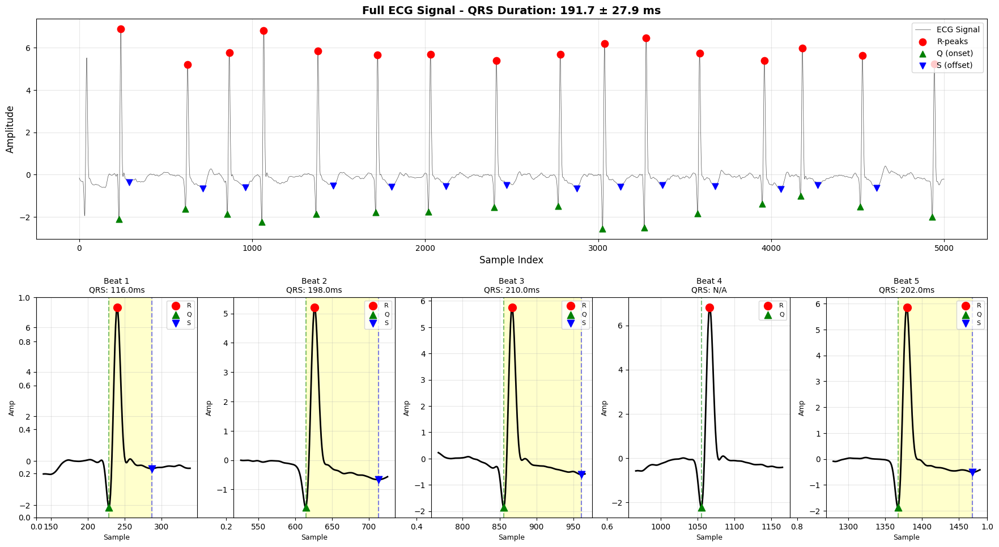

   Std:  219.55 ms


   Std:  27.36 ms
⚠️  WARNING: QRS duration > 120ms📊 QRS DELINEATION STATISTICS


   ⚠️  High STD (219.5ms) → Possibly NOISE or detection error============================================================
✅ QRS duration is NORMAL (60-100ms expected)


✅ Total R-peaks detected: 16============================================================



✅ Valid Q-peaks detected: 16
✅ Valid S-peaks detected: 14

📏 QRS Duration:
   Mean: 191.71 ms
   Std:  27.88 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (27.9ms) → Possibly NOISE or detection error



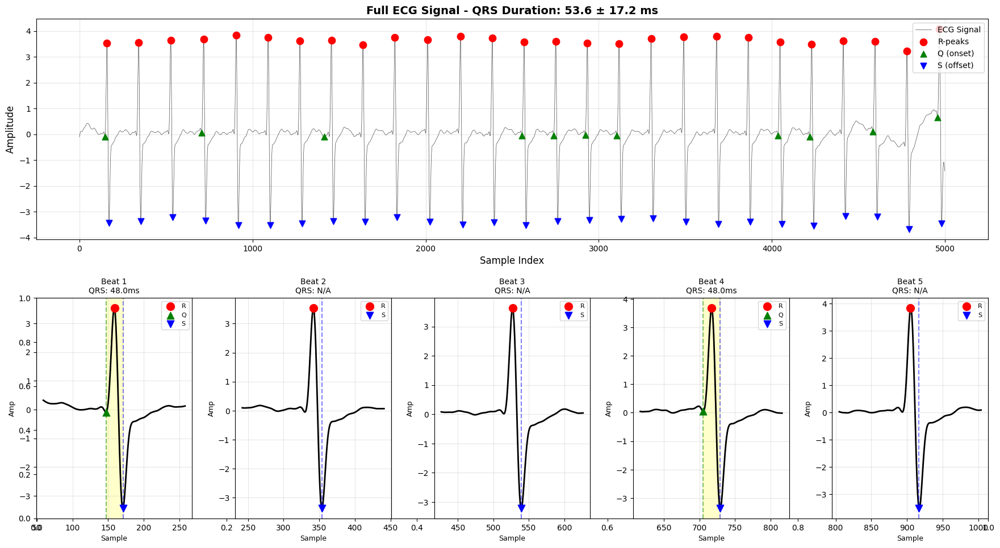


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 53.64 ms
   Std:  17.20 ms

✅ QRS duration is NORMAL (60-100ms expected)

V5
V4
V4
V4


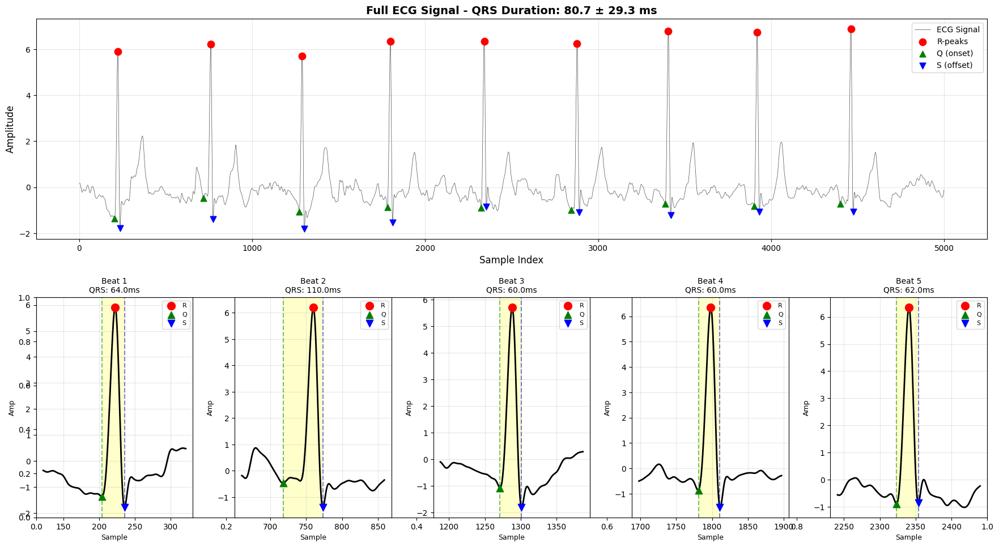


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 80.67 ms
   Std:  29.32 ms

✅ QRS duration is NORMAL (60-100ms expected)



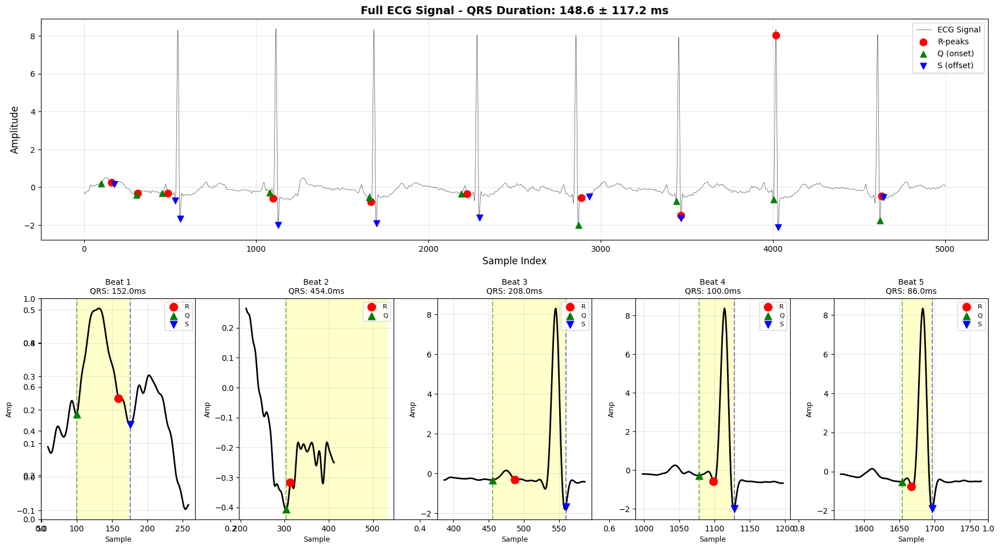


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 148.60 ms
   Std:  117.24 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (117.2ms) → Possibly NOISE or detection error

V5
V5


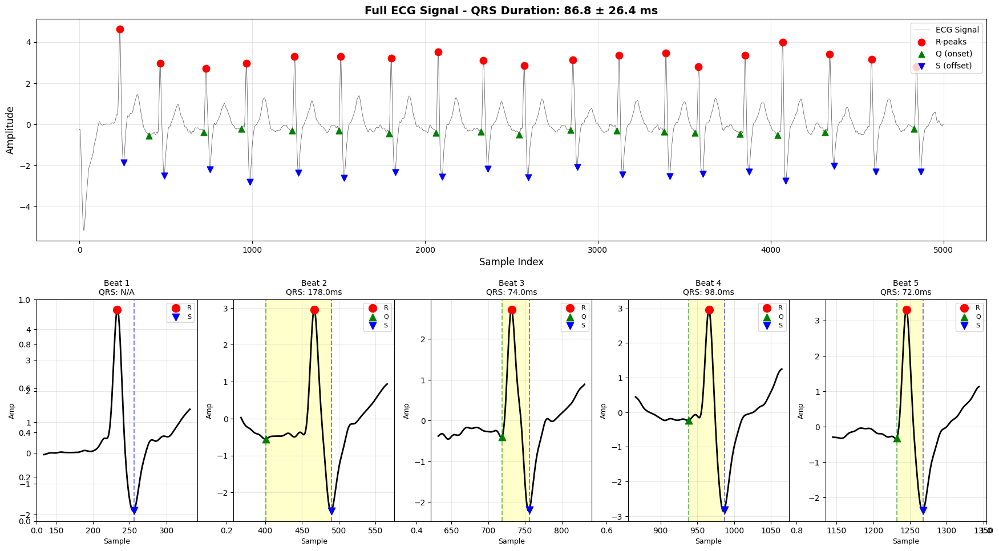


📊 QRS DELINEATION STATISTICS

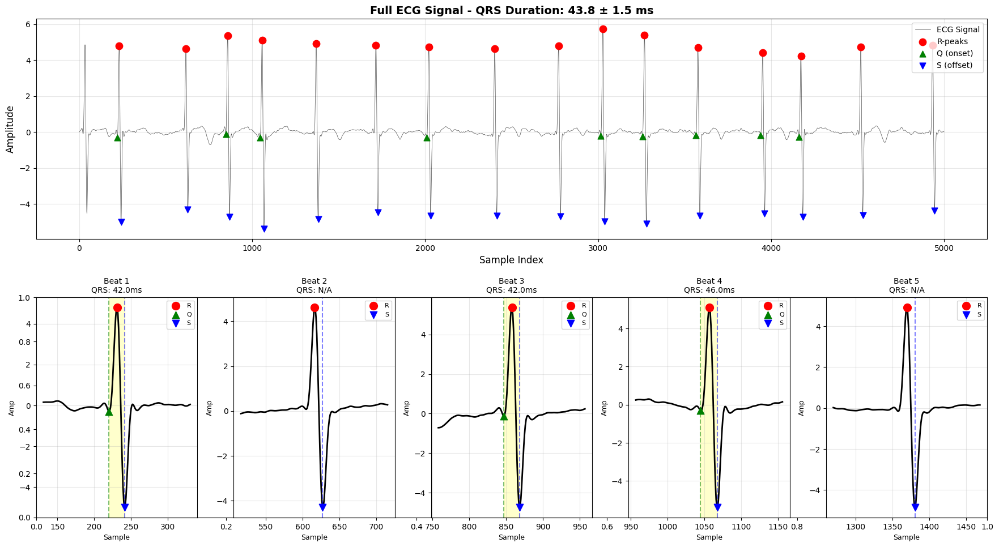



✅ Total R-peaks detected: 19
📊 QRS DELINEATION STATISTICS✅ Valid Q-peaks detected: 17

============================================================✅ Valid S-peaks detected: 19

✅ Total R-peaks detected: 16

📏 QRS Duration:✅ Valid Q-peaks detected: 9

   Mean: 86.82 ms✅ Valid S-peaks detected: 16

   Std:  26.36 ms
📏 QRS Duration:

✅ QRS duration is NORMAL (60-100ms expected)

   Mean: 43.78 ms============================================================


   Std:  1.47 ms

✅ QRS duration is NORMAL (60-100ms expected)



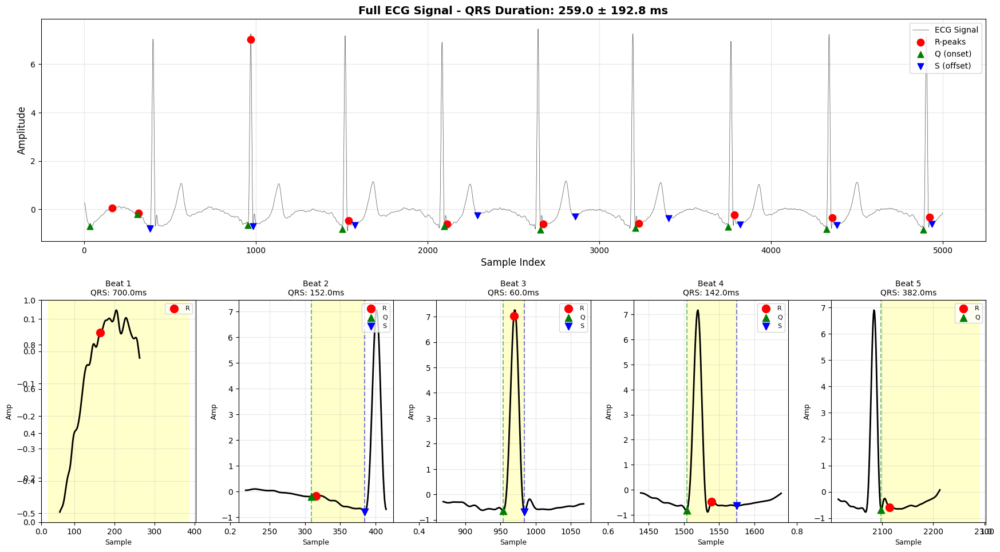


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 259.00 ms
   Std:  192.78 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (192.8ms) → Possibly NOISE or detection error

V5
V6
V5


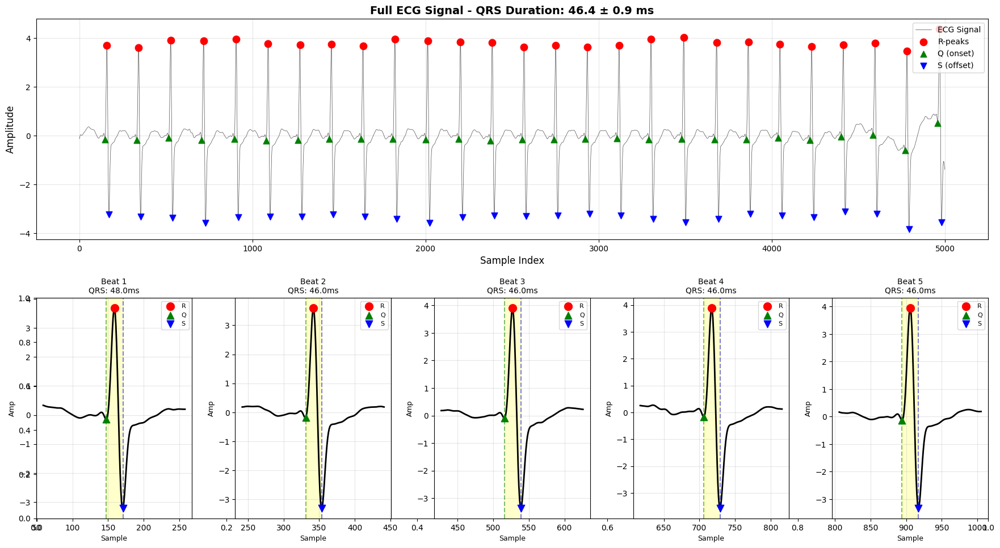


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 27
✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 46.37 ms
   Std:  0.95 ms

✅ QRS duration is NORMAL (60-100ms expected)



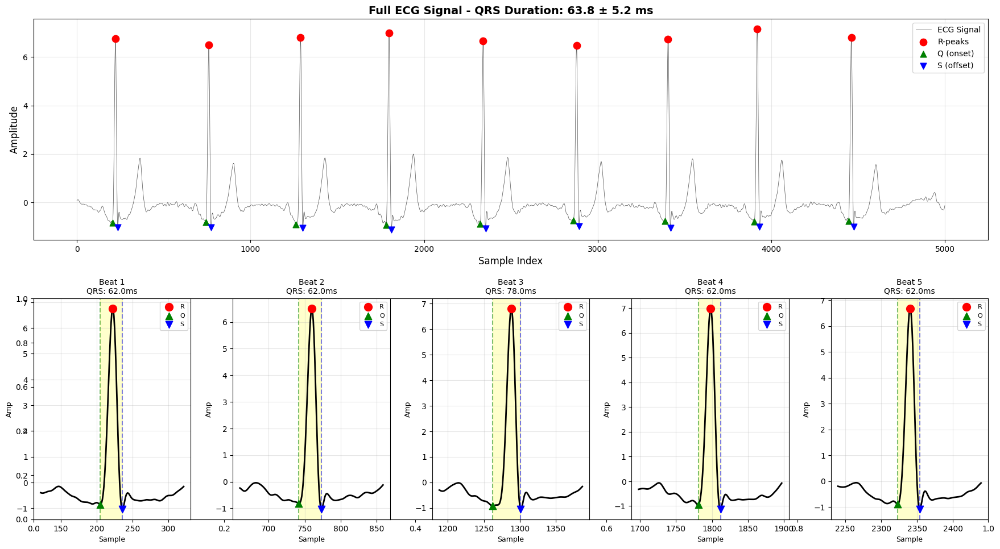


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 63.78 ms
   Std:  5.20 ms

✅ QRS duration is NORMAL (60-100ms expected)

V5


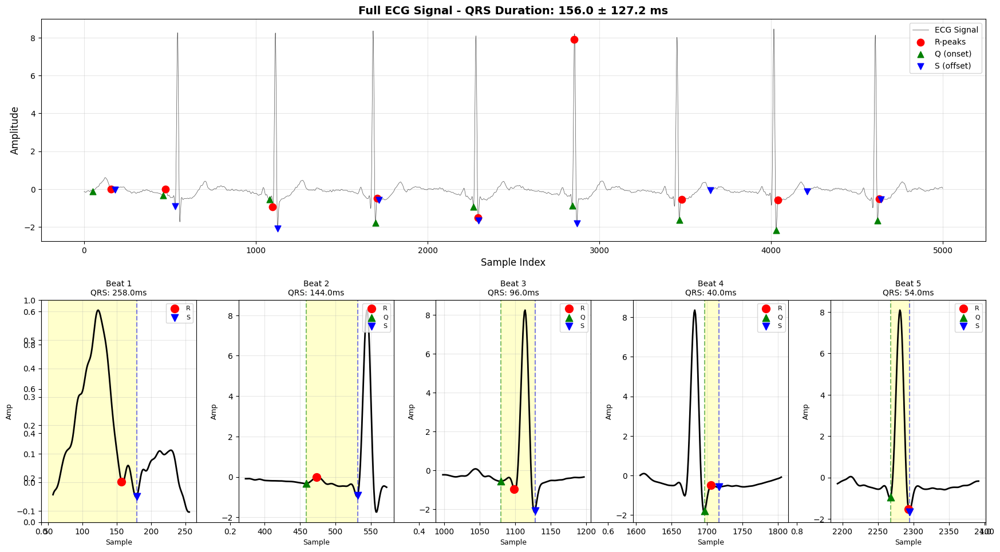


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 156.00 ms
   Std:  127.21 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (127.2ms) → Possibly NOISE or detection error

V6
V6


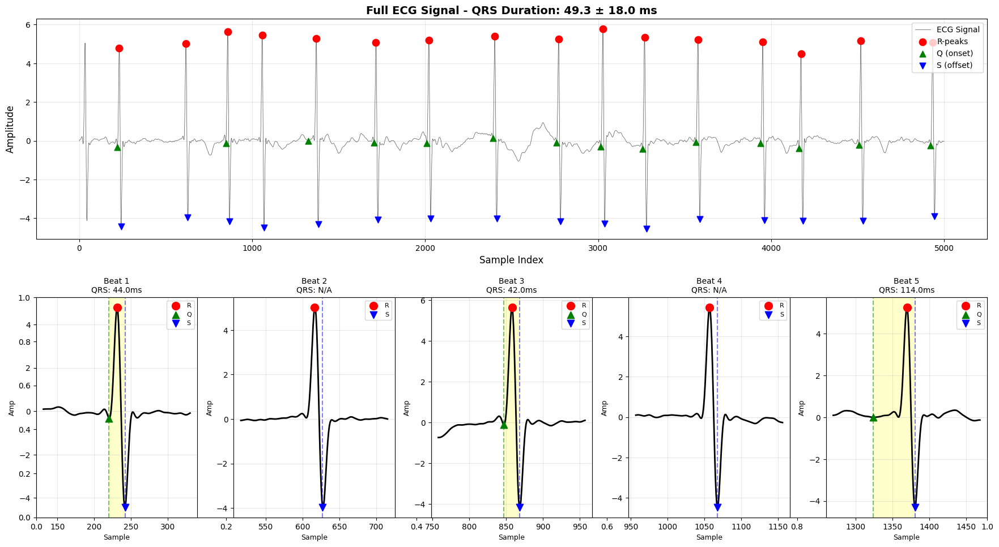


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 16
✅ Valid Q-peaks detected: 14
✅ Valid S-peaks detected: 16

📏 QRS Duration:
   Mean: 49.29 ms
   Std:  17.99 ms

✅ QRS duration is NORMAL (60-100ms expected)



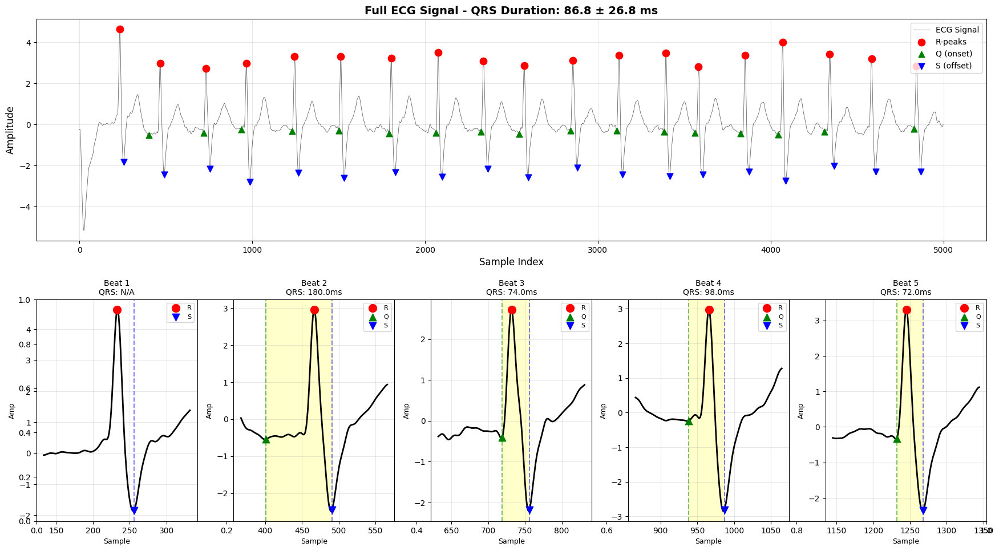


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 19
✅ Valid Q-peaks detected: 17
✅ Valid S-peaks detected: 19

📏 QRS Duration:
   Mean: 86.82 ms


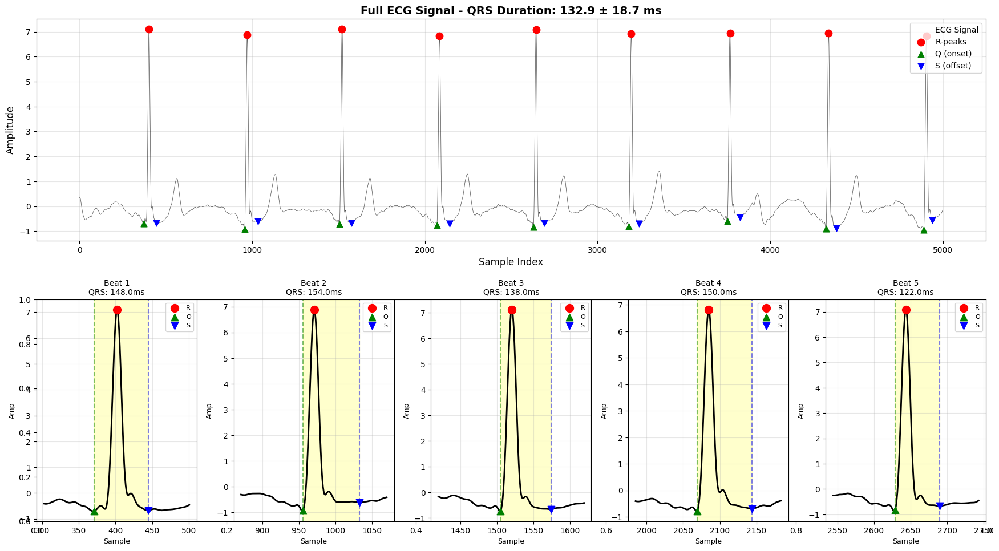

   Std:  26.78 ms


✅ QRS duration is NORMAL (60-100ms expected)📊 QRS DELINEATION STATISTICS


✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 132.89 ms
   Std:  18.72 ms

⚠️  WARNING: QRS duration > 120ms
   ✅ Low STD (18.7ms) → Possibly real Bundle Branch Block



Processing ECG:  10%|█         | 1/10 [00:28<04:12, 28.02s/it]

V6
I
V6


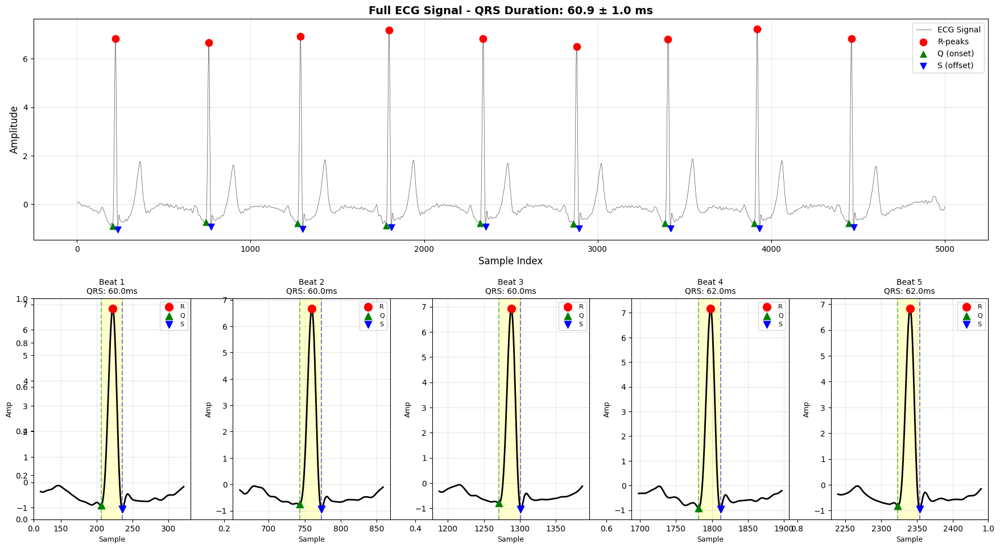


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 60.89 ms
   Std:  0.99 ms

✅ QRS duration is NORMAL (60-100ms expected)



Processing ECG:  20%|██        | 2/10 [00:28<01:36, 12.02s/it]

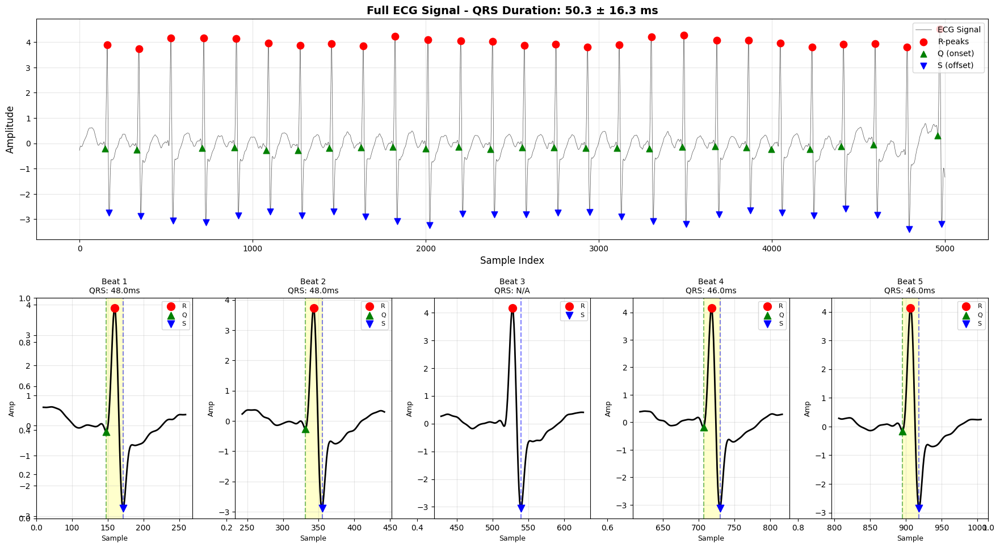


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 25
✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 50.32 ms
   Std:  16.29 ms

✅ QRS duration is NORMAL (60-100ms expected)



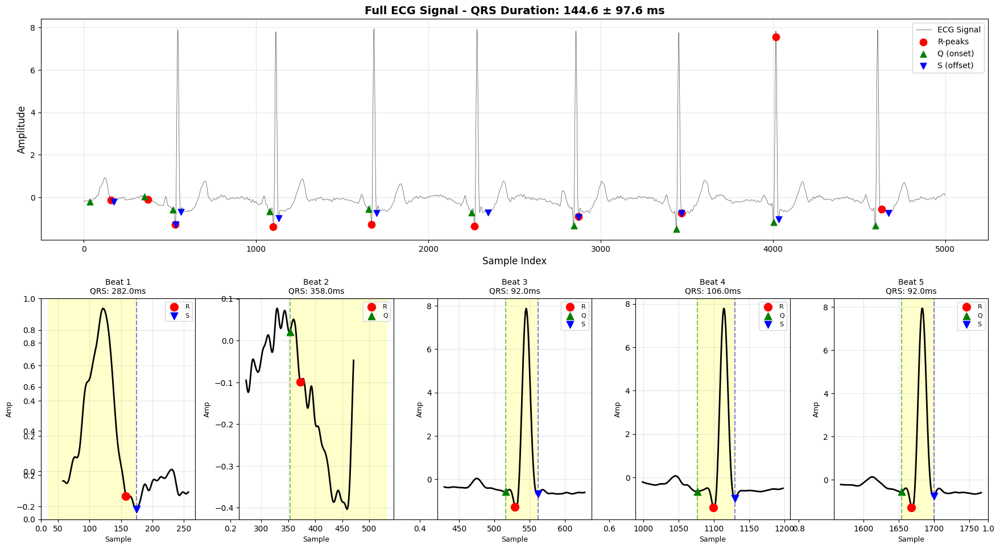


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 144.60 ms
   Std:  97.56 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (97.6ms) → Possibly NOISE or detection error



Processing ECG:  30%|███       | 3/10 [00:29<00:46,  6.65s/it]

I
I
V6


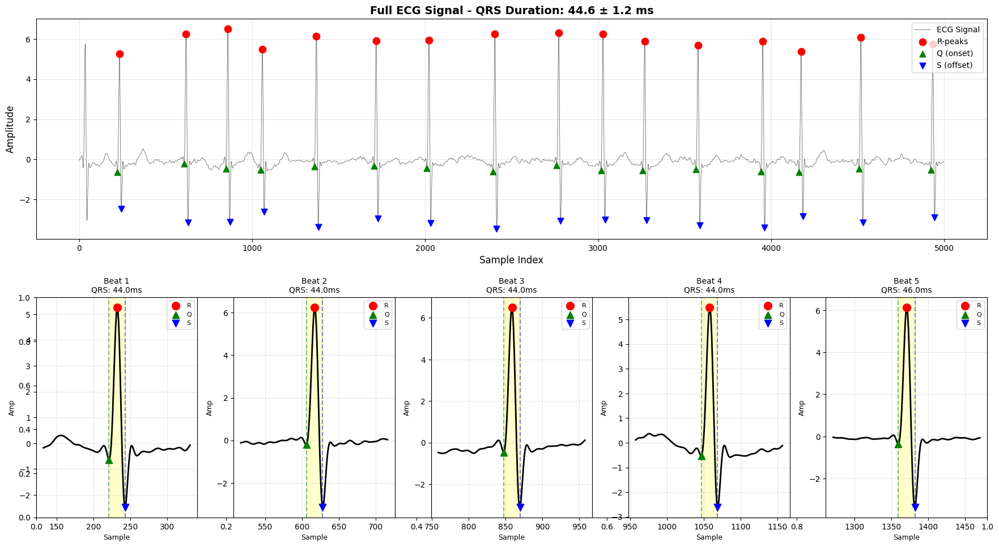


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 16
✅ Valid Q-peaks detected: 16
✅ Valid S-peaks detected: 16

📏 QRS Duration:
   Mean: 44.62 ms
   Std:  1.17 ms

✅ QRS duration is NORMAL (60-100ms expected)



Processing ECG:  40%|████      | 4/10 [00:30<00:26,  4.49s/it]

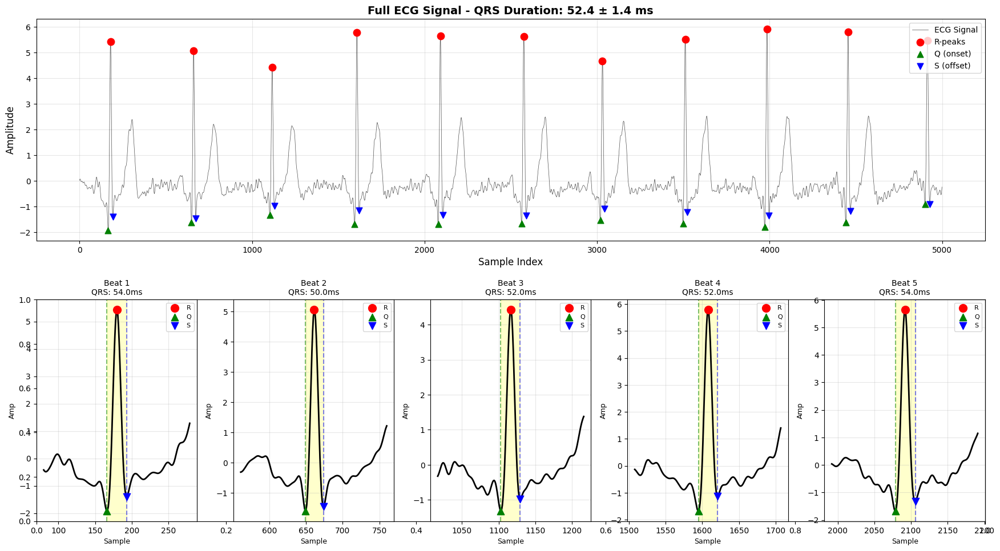


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11
I
📏 QRS Duration:

   Mean: 52.36 ms
   Std:  1.43 ms

✅ QRS duration is NORMAL (60-100ms expected)



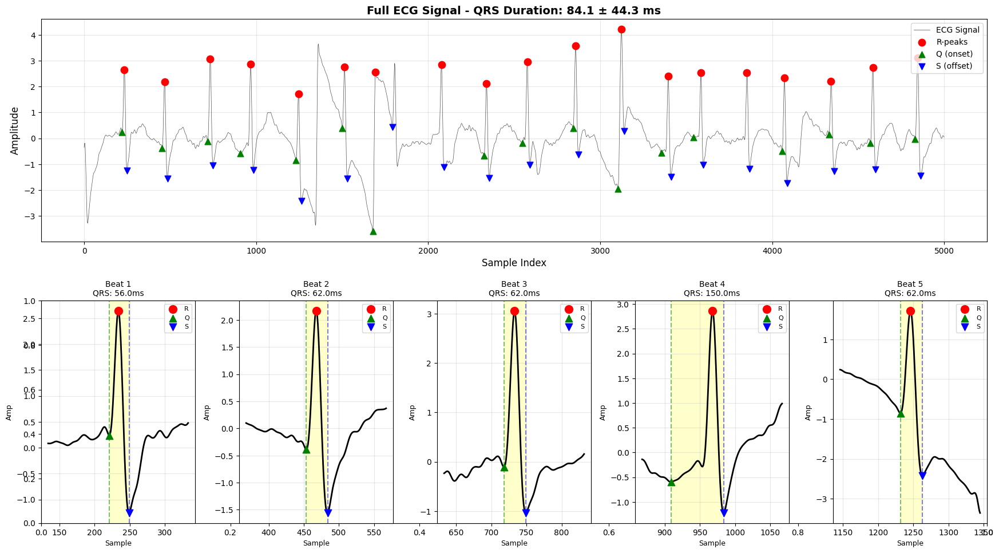


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 19
✅ Valid Q-peaks detected: 17
✅ Valid S-peaks detected: 19

📏 QRS Duration:
   Mean: 84.12 ms
   Std:  44.31 ms

✅ QRS duration is NORMAL (60-100ms expected)



Processing ECG:  50%|█████     | 5/10 [00:30<00:15,  3.10s/it]

II


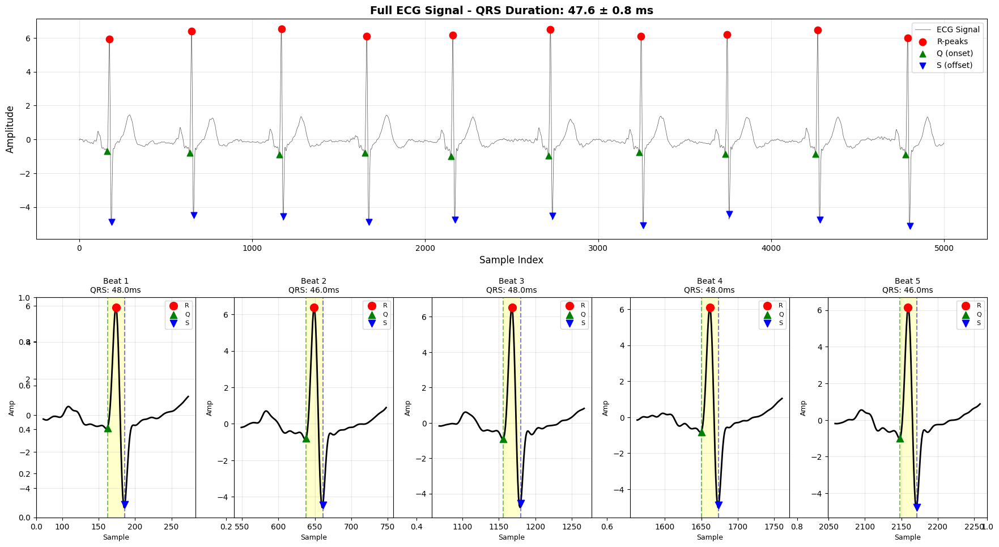


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 47.60 ms
   Std:  0.80 ms

✅ QRS duration is NORMAL (60-100ms expected)

II


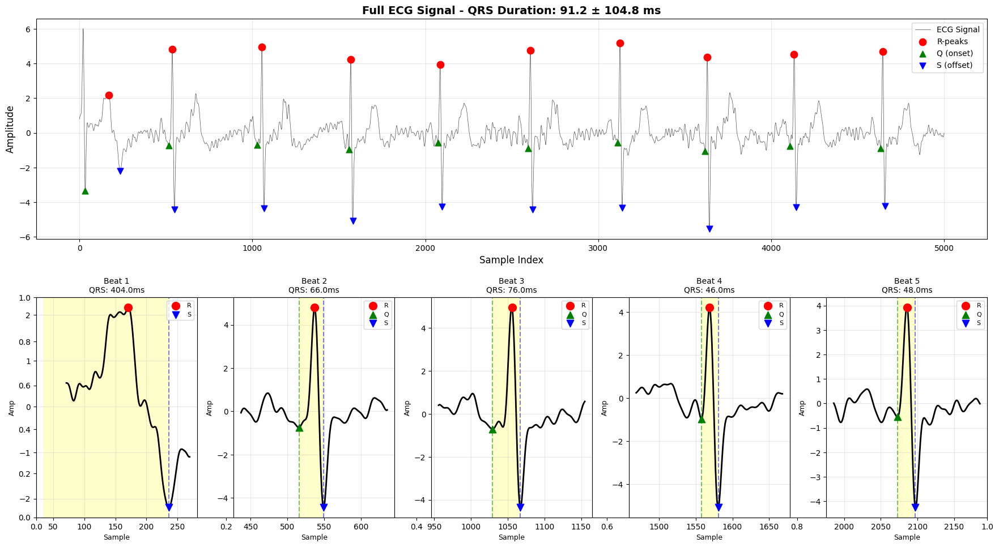


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 91.20 ms
   Std:  104.82 ms

✅ QRS duration is NORMAL (60-100ms expected)



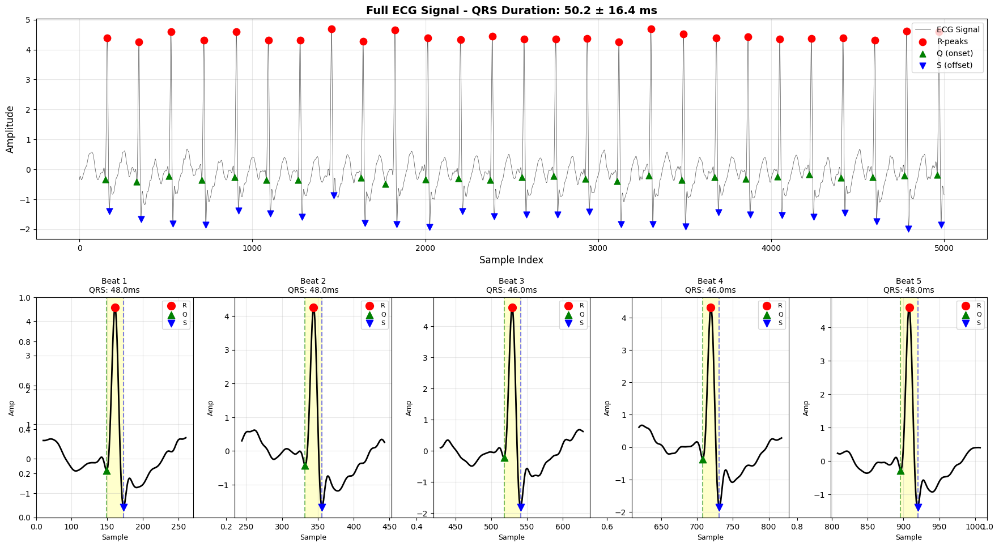


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 27
✅ Valid Q-peaks detected: 26
✅ Valid S-peaks detected: 27

📏 QRS Duration:
   Mean: 50.23 ms
   Std:  16.40 ms

✅ QRS duration is NORMAL (60-100ms expected)



Processing ECG:  60%|██████    | 6/10 [00:32<00:10,  2.61s/it]

II


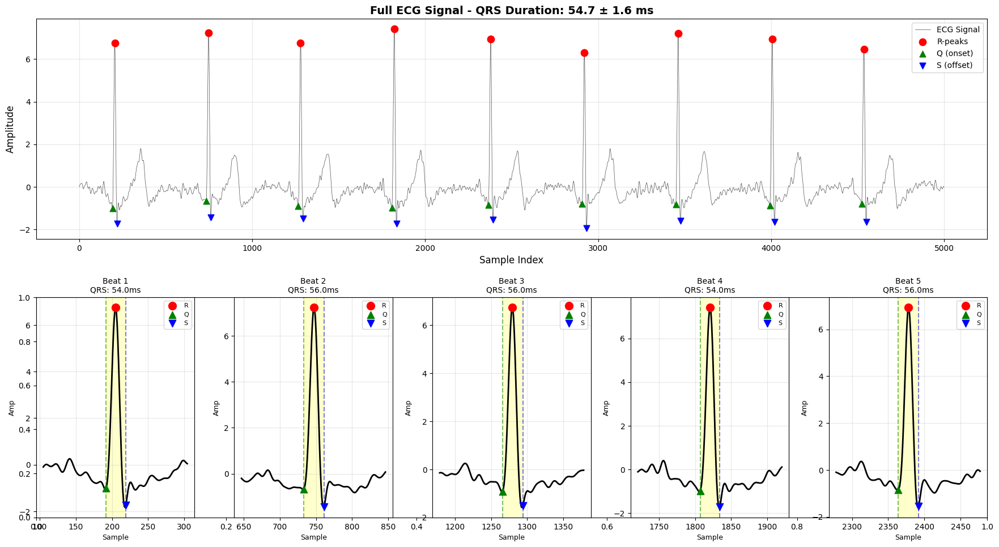


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 54.67 ms
   Std:  1.63 ms

✅ QRS duration is NORMAL (60-100ms expected)



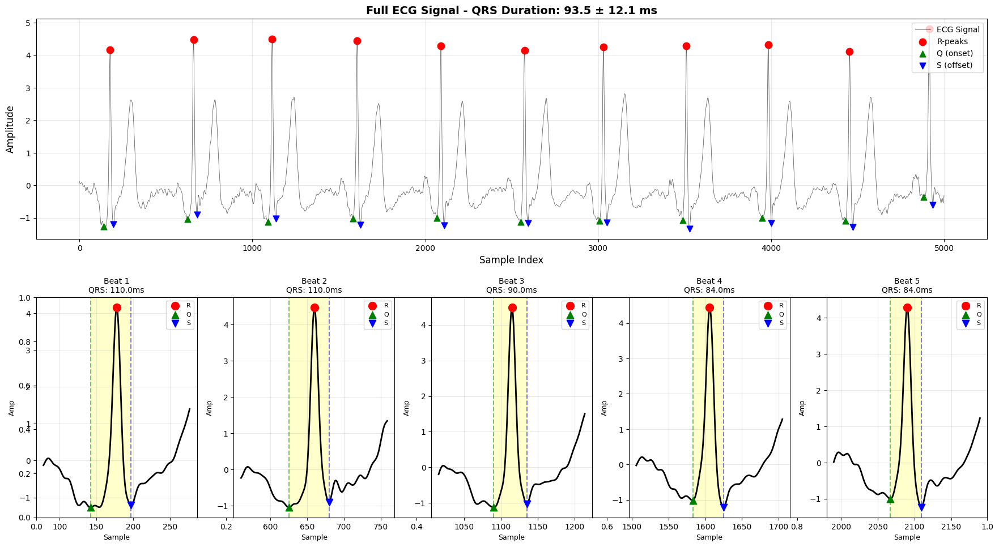


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 93.45 ms
   Std:  12.09 ms

✅ QRS duration is NORMAL (60-100ms expected)

II


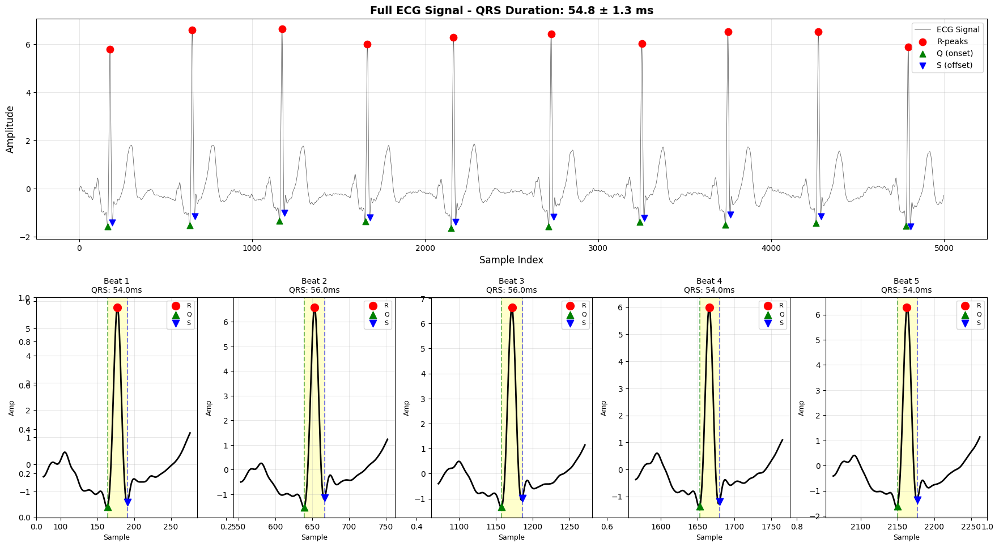


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 54.80 ms
   Std:  1.33 msIII

✅ QRS duration is NORMAL (60-100ms expected)


III


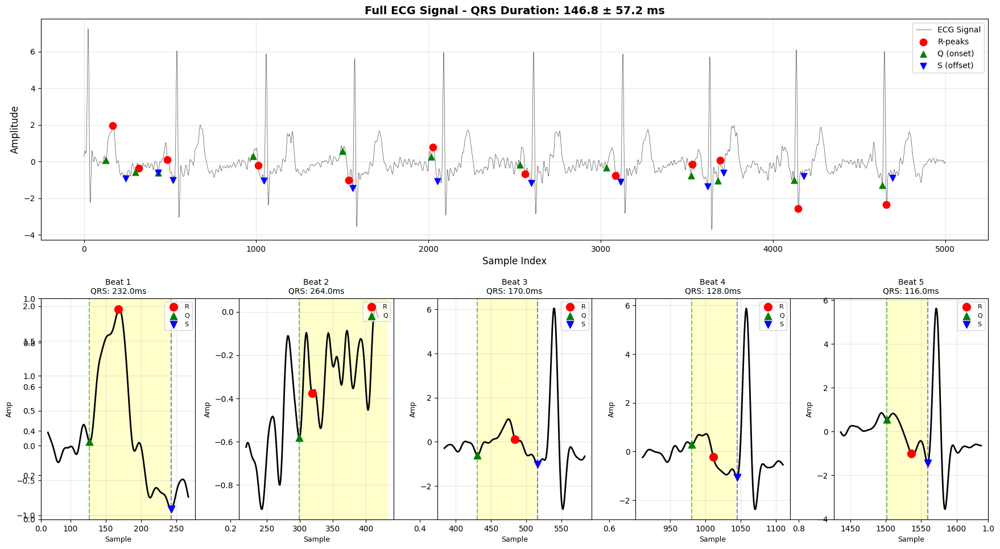


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 12
✅ Valid Q-peaks detected: 12
✅ Valid S-peaks detected: 12

📏 QRS Duration:
   Mean: 146.83 ms
   Std:  57.16 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (57.2ms) → Possibly NOISE or detection error

III


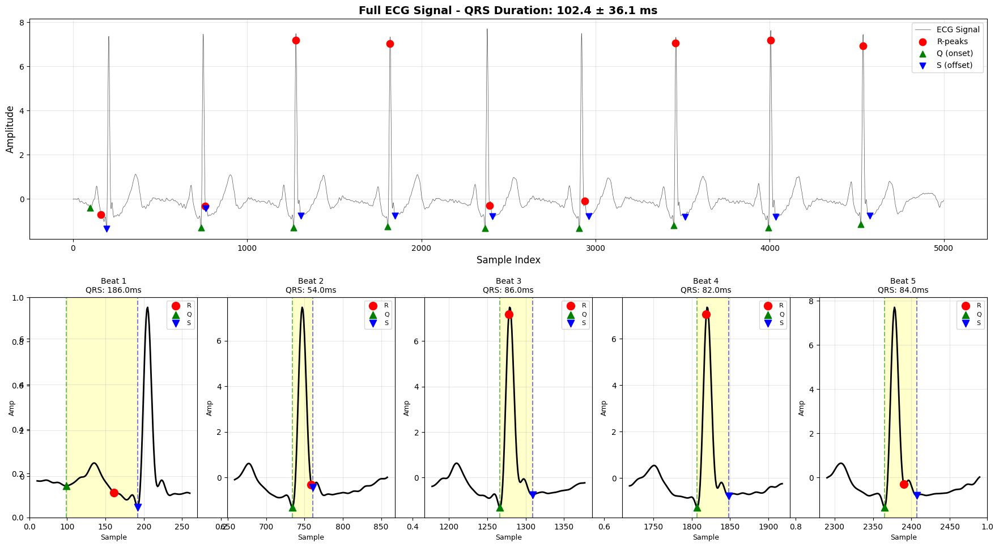


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 102.44 ms
   Std:  36.10 ms

✅ QRS duration is NORMAL (60-100ms expected)

III


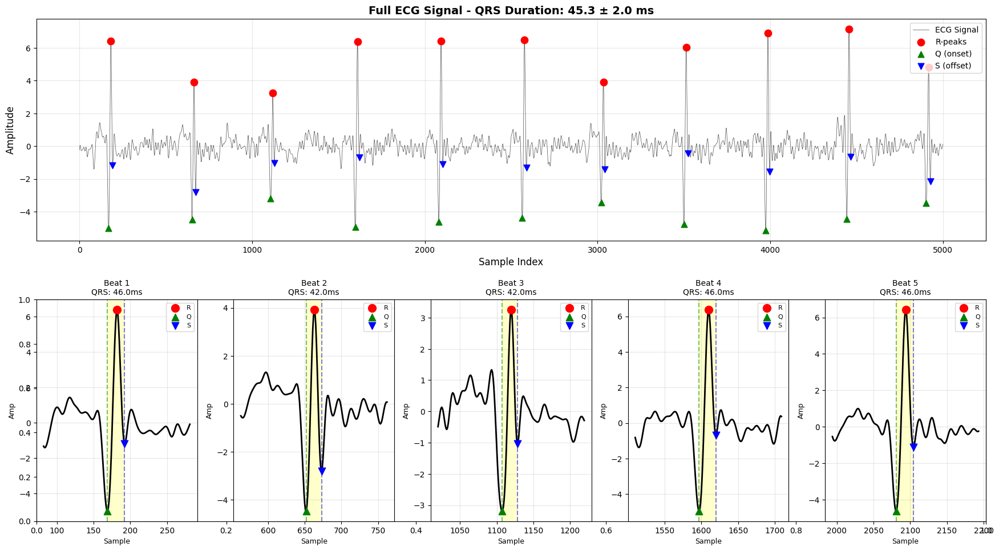


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 45.27 ms
   Std:  1.96 ms

✅ QRS duration is NORMAL (60-100ms expected)



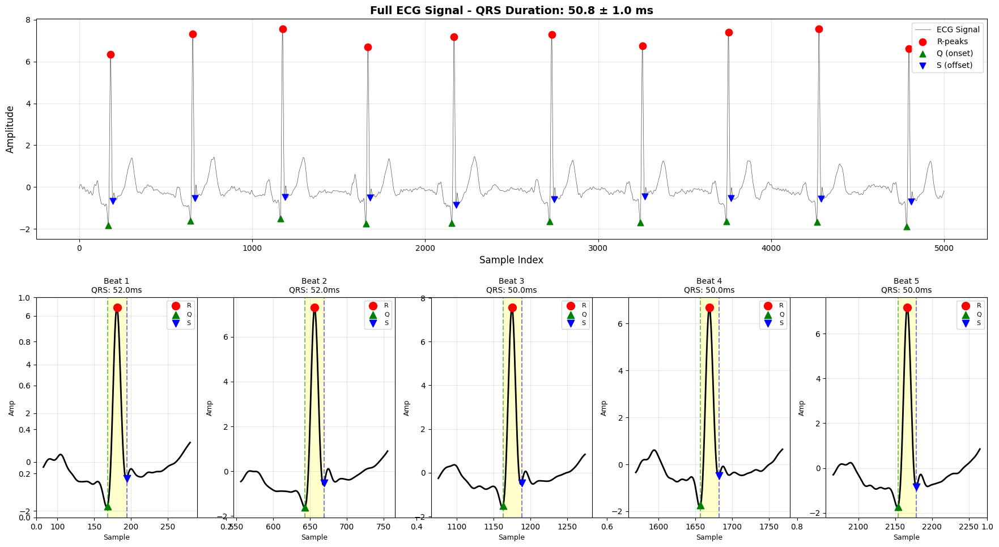


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 50.80 ms
   Std:  0.98 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVR
aVR


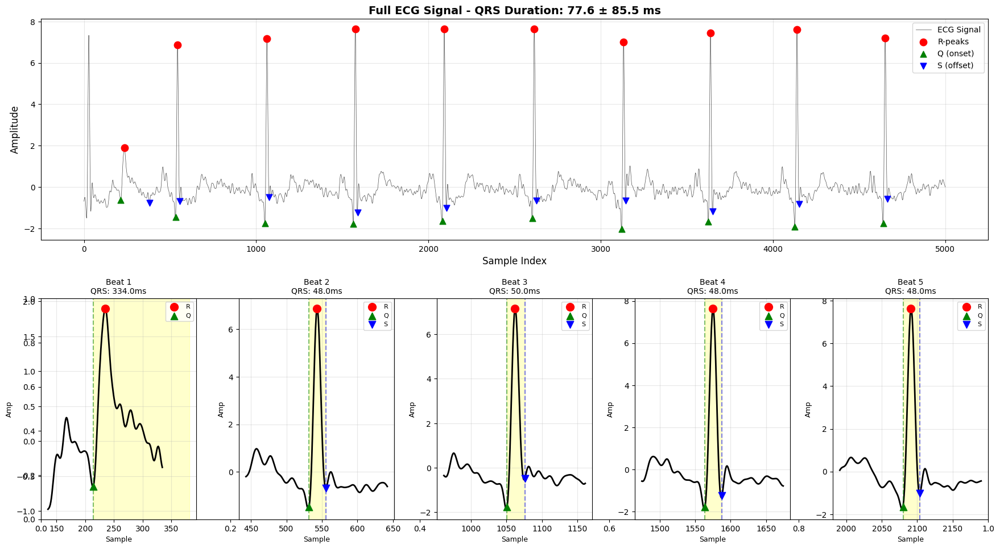


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Std:  85.48 ms   Mean: 77.60 ms


✅ QRS duration is NORMAL (60-100ms expected)

aVR


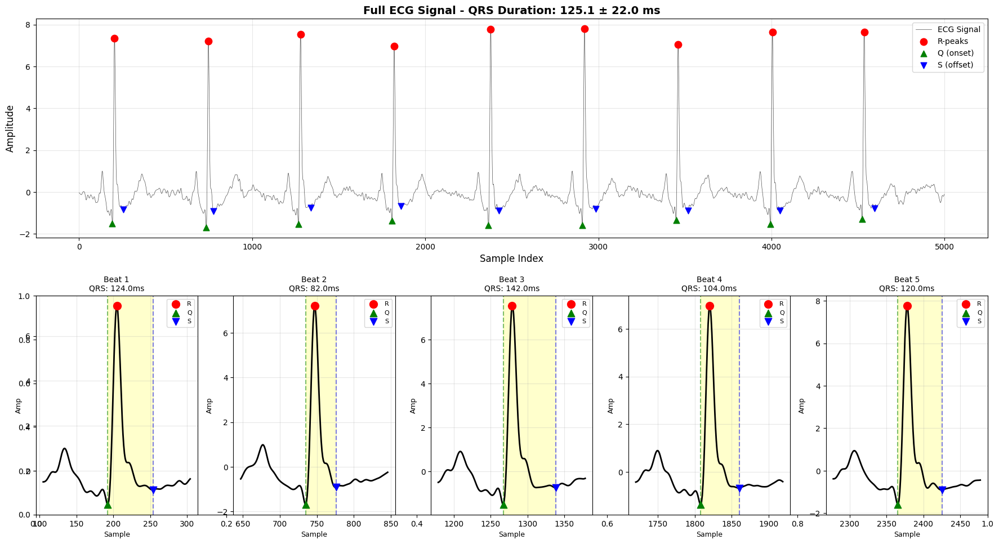


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 125.11 ms
   Std:  21.97 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (22.0ms) → Possibly NOISE or detection error

aVR


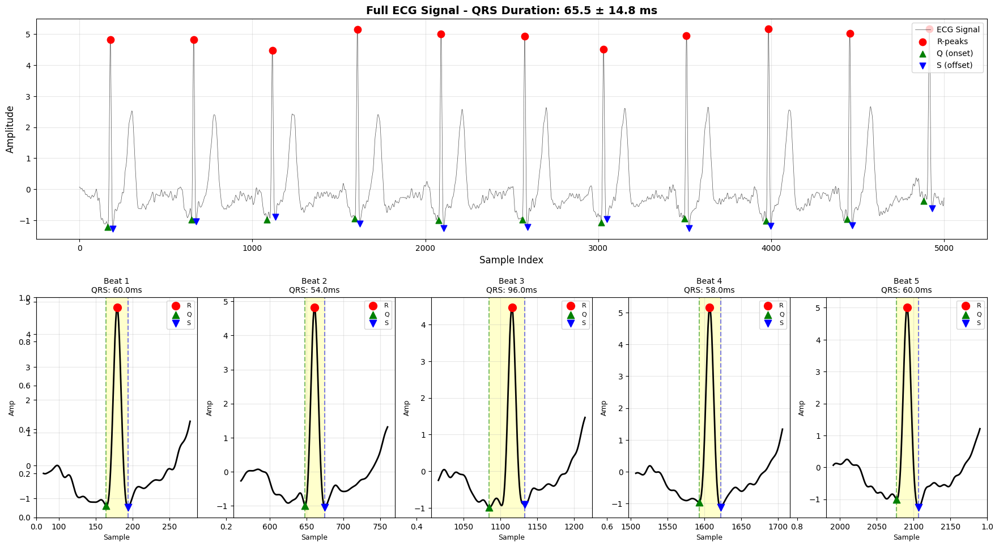


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 65.45 ms
   Std:  14.80 ms

✅ QRS duration is NORMAL (60-100ms expected)



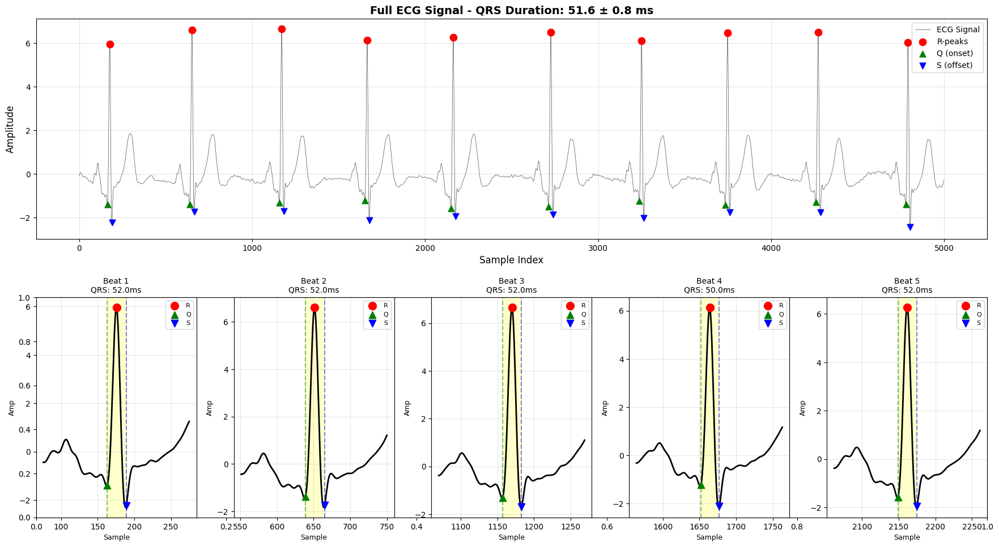


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 51.60 ms
   Std:  0.80 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVL
aVL


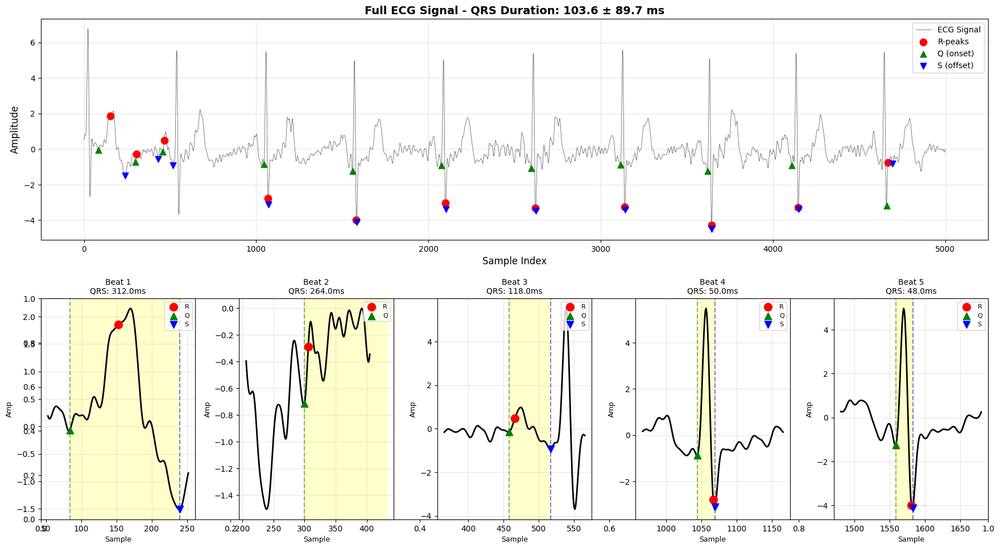


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 103.64 ms
   Std:  89.70 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVL


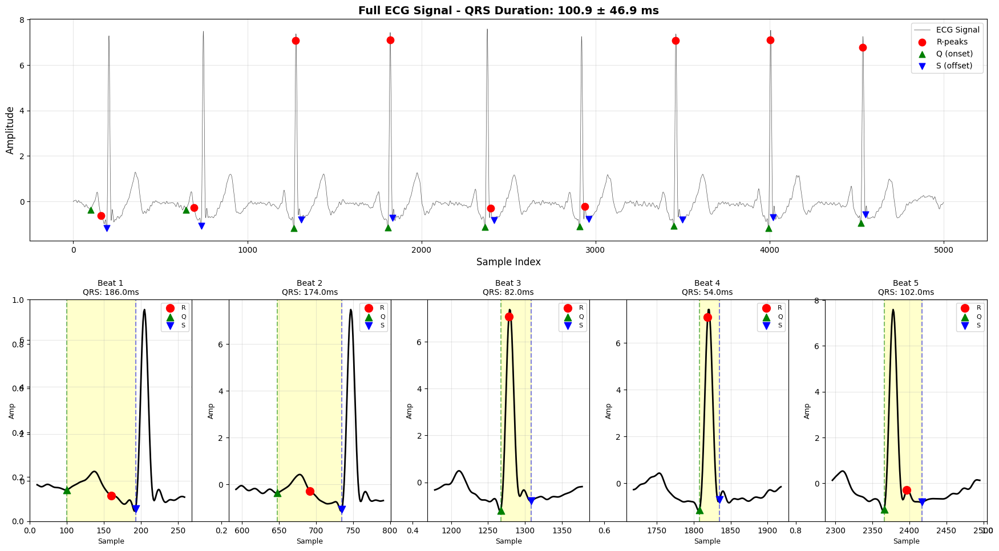


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 100.89 ms
   Std:  46.87 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVL


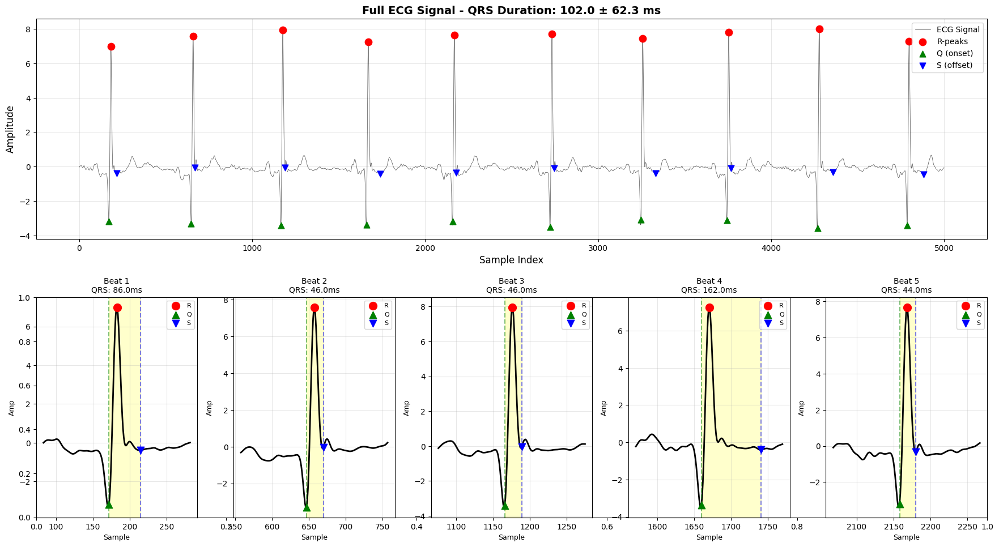


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 102.00 ms
   Std:  62.30 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVF


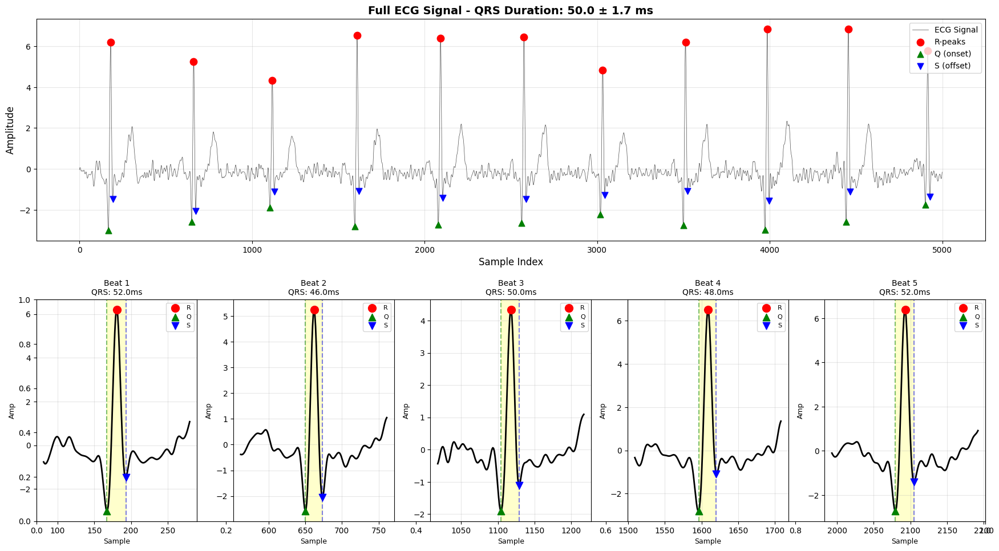


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 50.00 ms
   Std:  1.71 ms

✅ QRS duration is NORMAL (60-100ms expected)



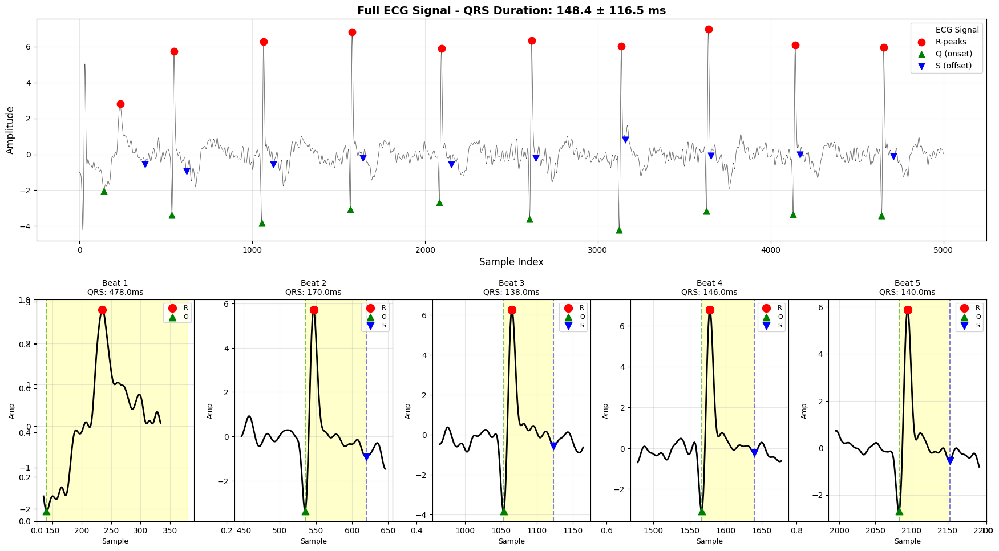


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
aVF✅ Valid S-peaks detected: 10


📏 QRS Duration:
   Mean: 148.40 ms
   Std:  116.48 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (116.5ms) → Possibly NOISE or detection error



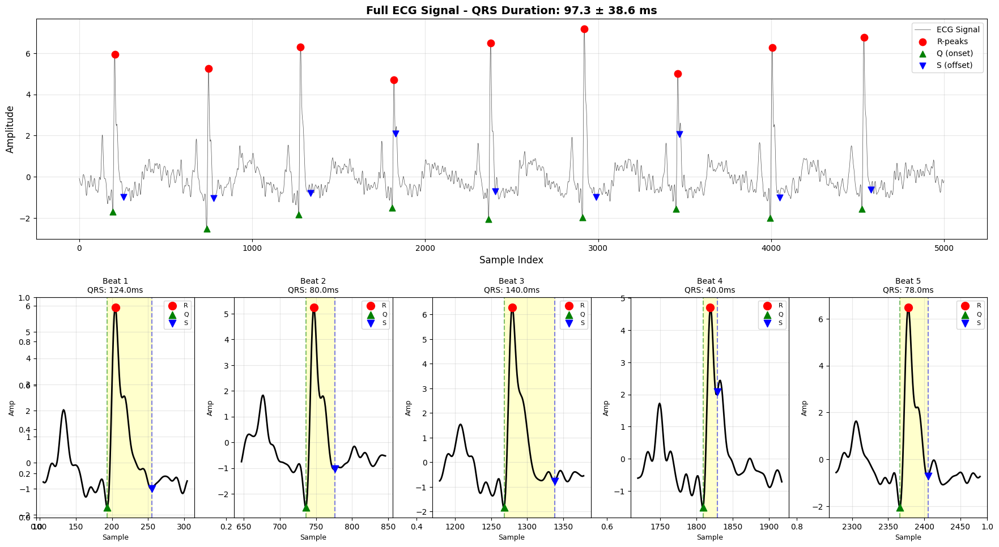


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9
aVF
📏 QRS Duration:

   Mean: 97.33 ms
   Std:  38.64 ms

✅ QRS duration is NORMAL (60-100ms expected)

aVF


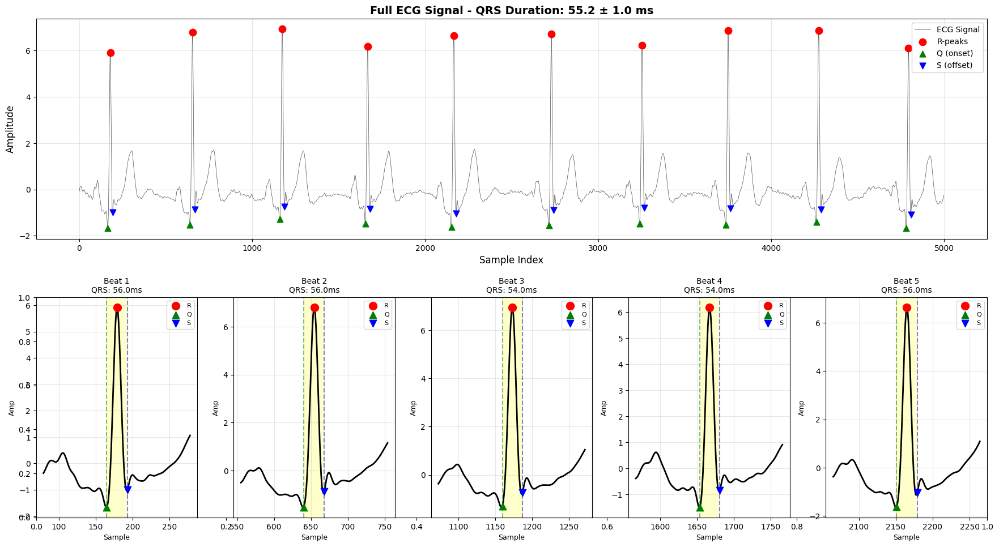


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 55.20 ms
   Std:  0.98 ms

✅ QRS duration is NORMAL (60-100ms expected)

V1


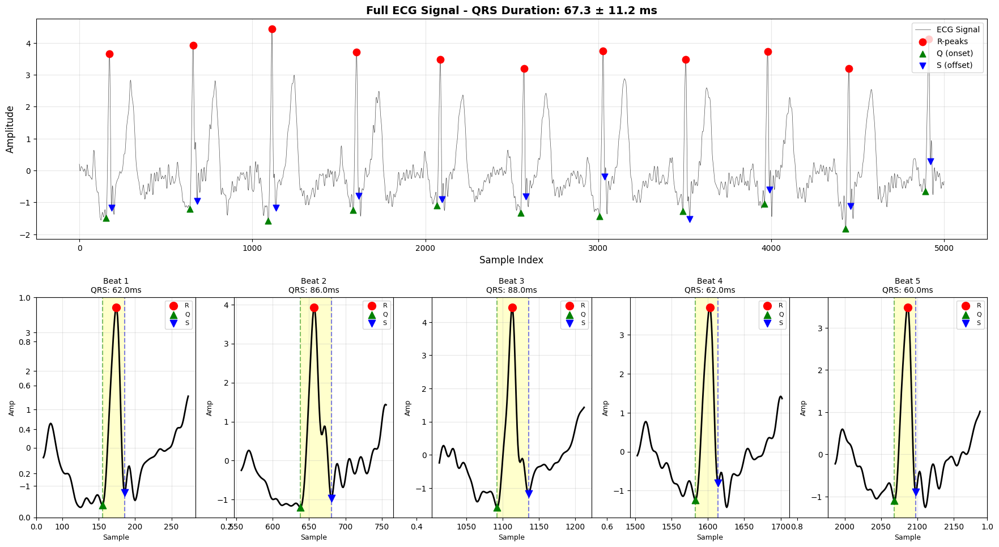


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 67.27 ms
   Std:  11.19 ms

✅ QRS duration is NORMAL (60-100ms expected)



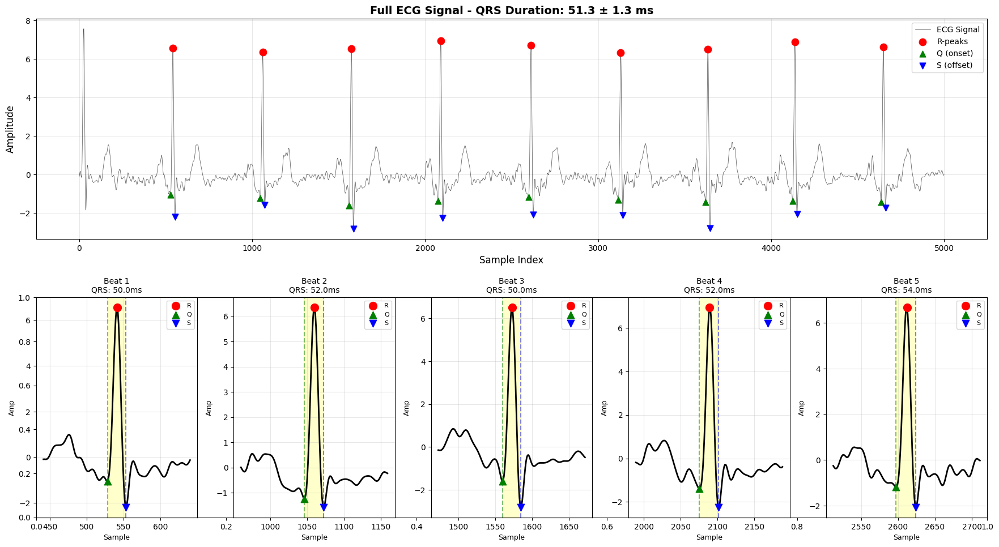


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 51.33 ms
   Std:  1.33 ms

✅ QRS duration is NORMAL (60-100ms expected)

V1


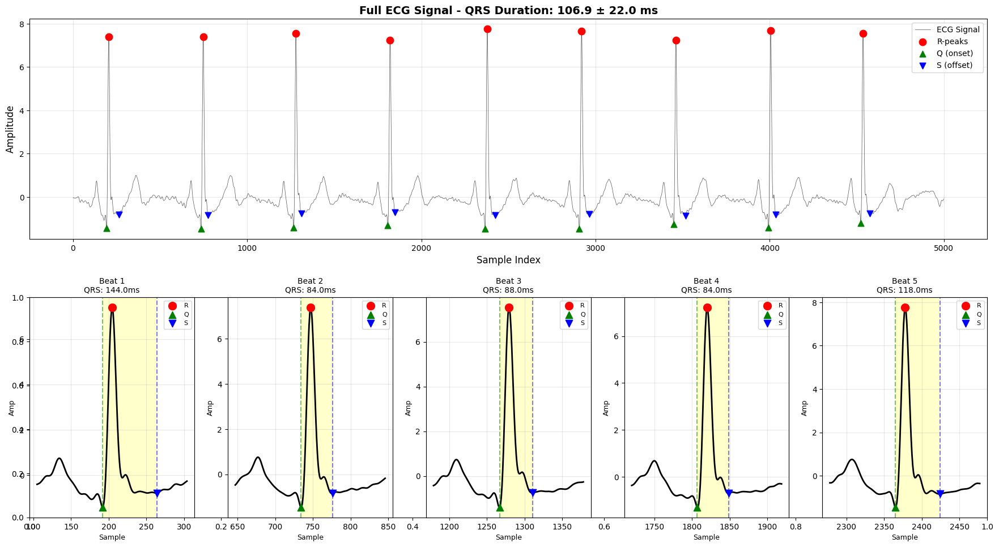


============================================================V1

📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 106.89 ms
   Std:  22.01 ms

✅ QRS duration is NORMAL (60-100ms expected)

V1


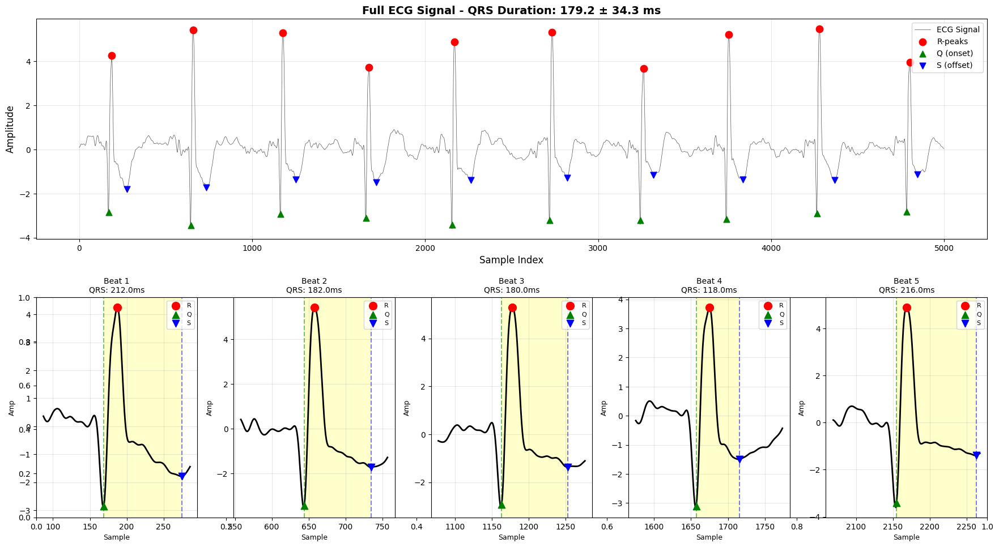


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 179.20 ms
   Std:  34.26 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (34.3ms) → Possibly NOISE or detection error



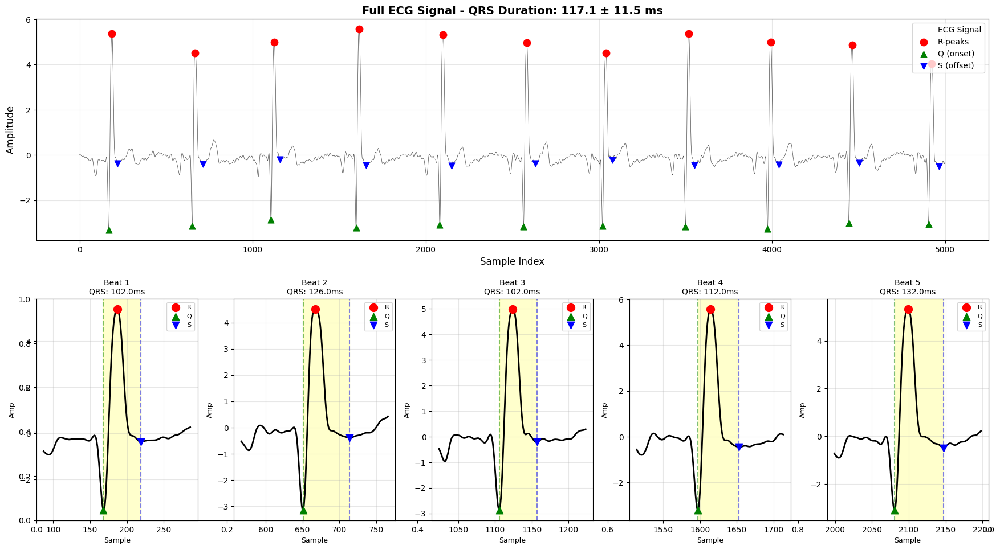


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 117.09 ms
   Std:  11.52 ms

✅ QRS duration is NORMAL (60-100ms expected)

V2


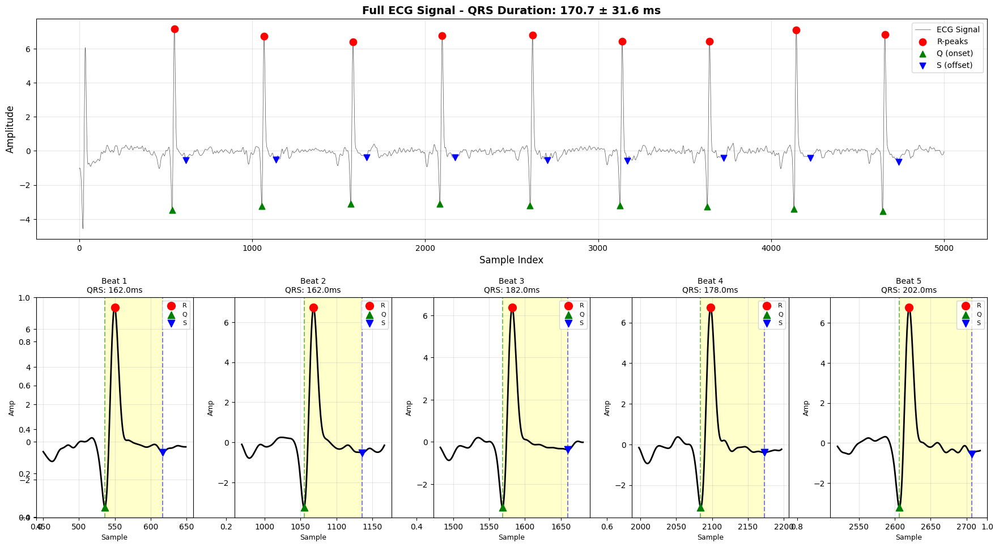


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 170.67 ms
   Std:  31.59 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (31.6ms) → Possibly NOISE or detection error

V2
V2


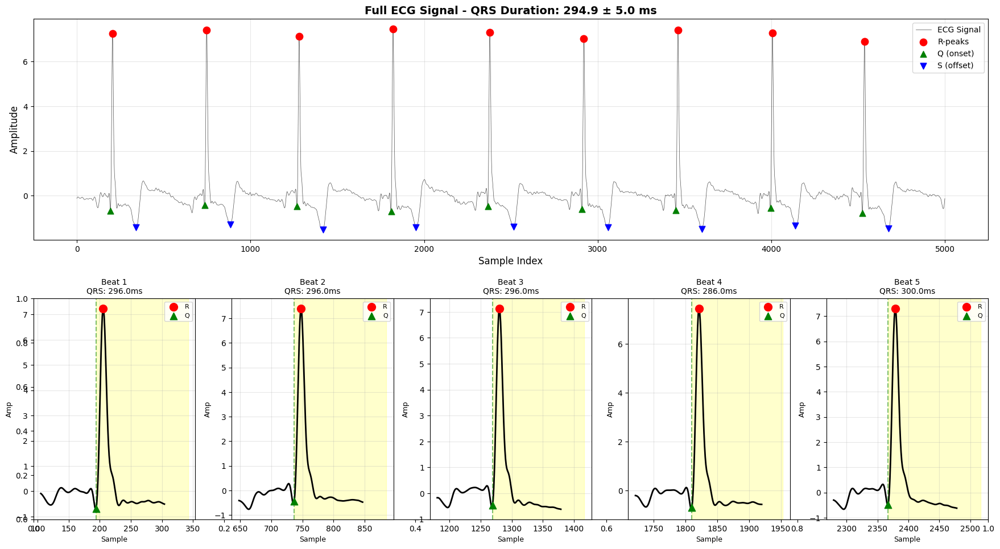


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 294.89 ms
   Std:  5.00 ms

⚠️  WARNING: QRS duration > 120ms
   ✅ Low STD (5.0ms) → Possibly real Bundle Branch Block

V2


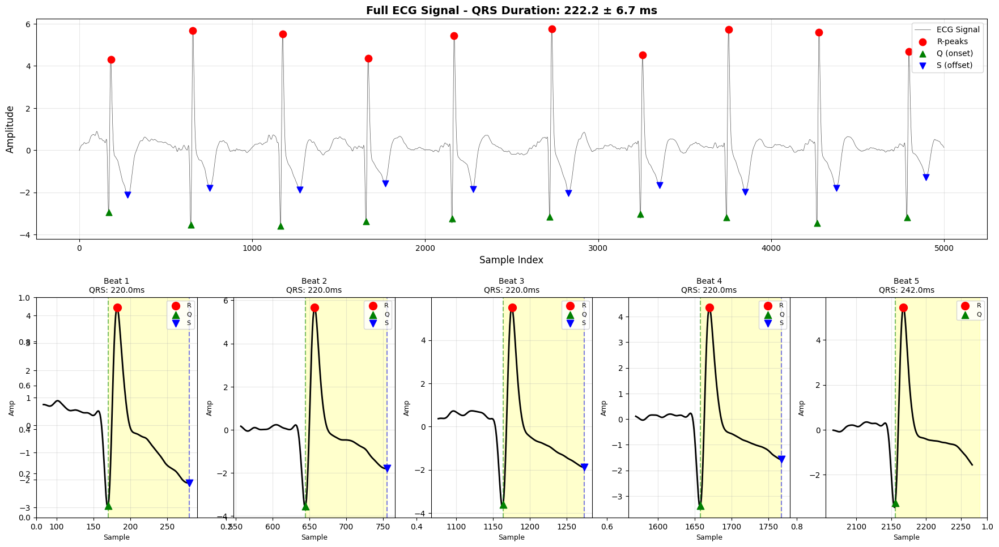


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 222.20 ms
   Std:  6.72 ms

⚠️  WARNING: QRS duration > 120ms
   ✅ Low STD (6.7ms) → Possibly real Bundle Branch Block

V3


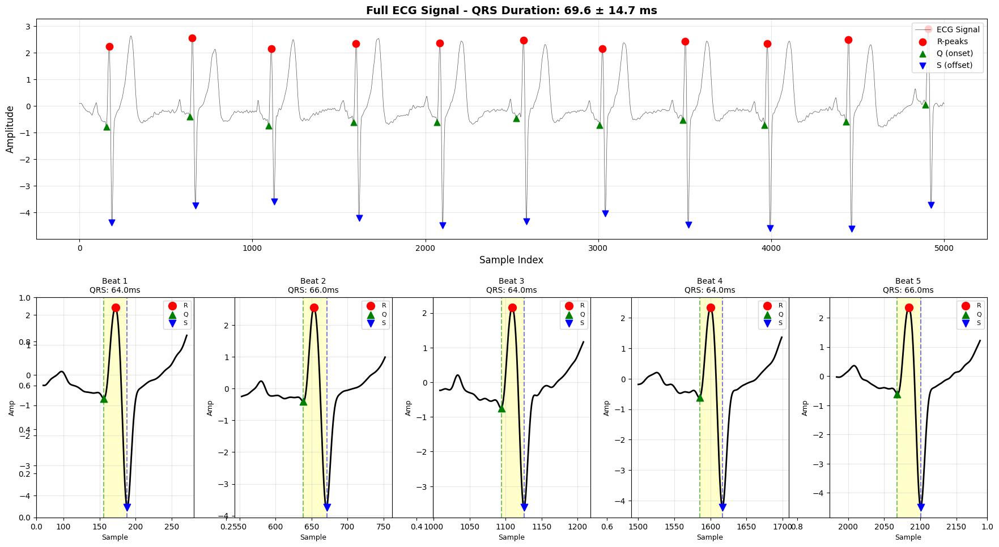


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 69.64 ms
   Std:  14.69 ms

✅ QRS duration is NORMAL (60-100ms expected)


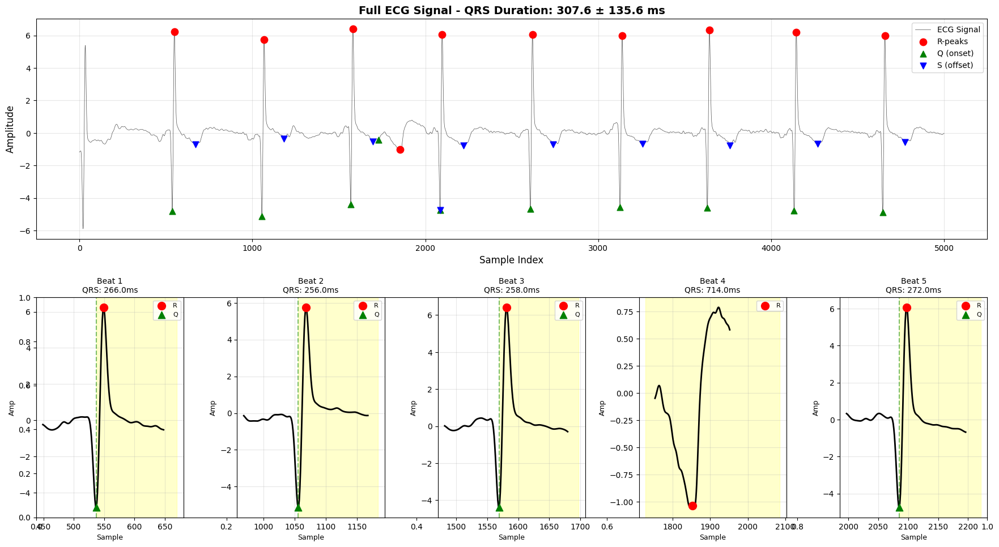




📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 307.60 ms
   Std:  135.60 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (135.6ms) → Possibly NOISE or detection error

V3
V3


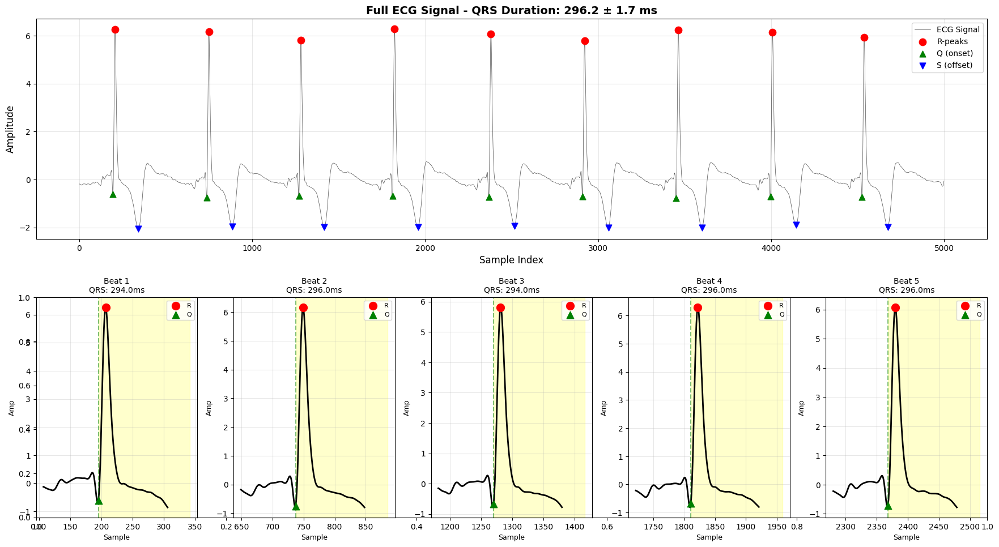


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 296.22 ms
   Std:  1.75 ms

⚠️  WARNING: QRS duration > 120ms
   ✅ Low STD (1.7ms) → Possibly real Bundle Branch Block

V3


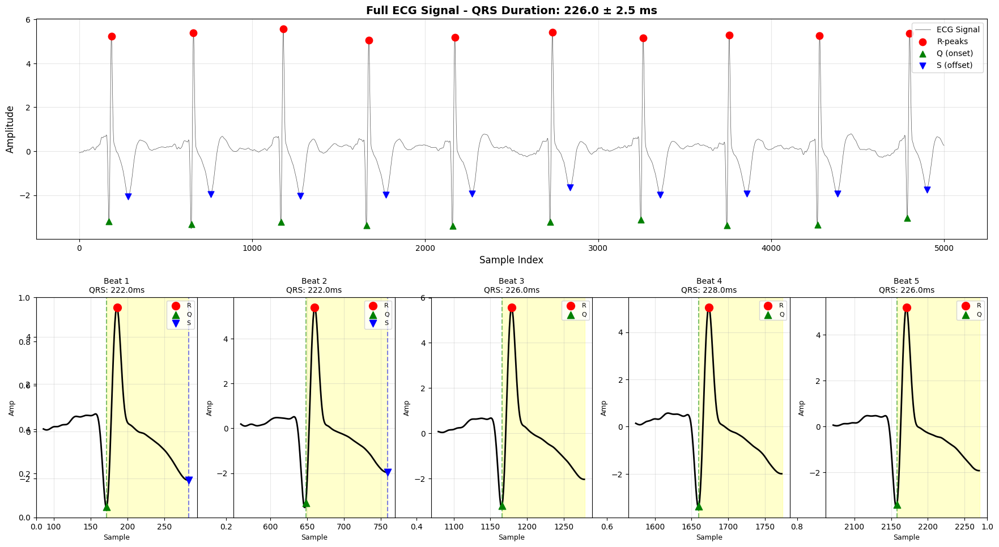


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 226.00 ms
   Std:  2.53 ms

⚠️  WARNING: QRS duration > 120ms
   ✅ Low STD (2.5ms) → Possibly real Bundle Branch Block

V4


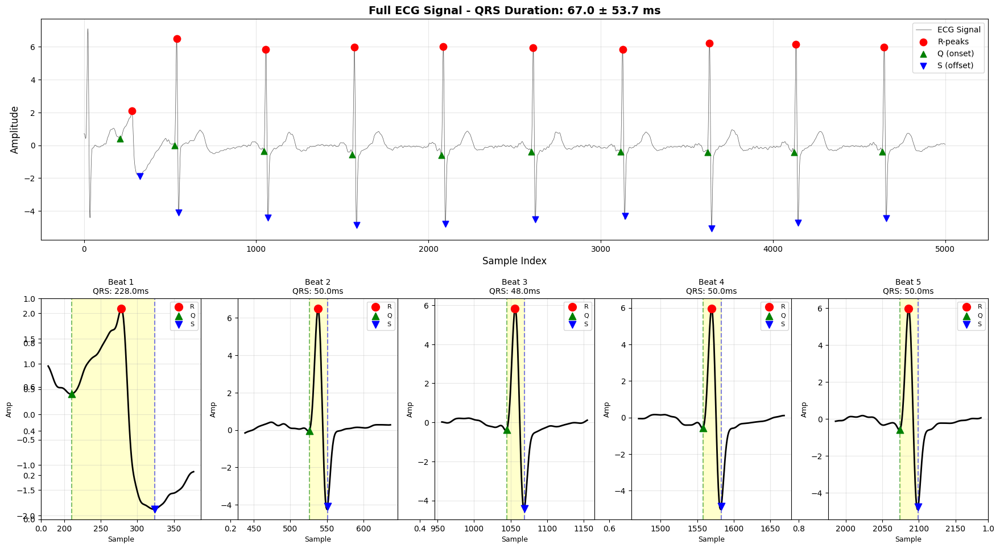


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 67.00 ms
   Std:  53.67 ms

✅ QRS duration is NORMAL (60-100ms expected)


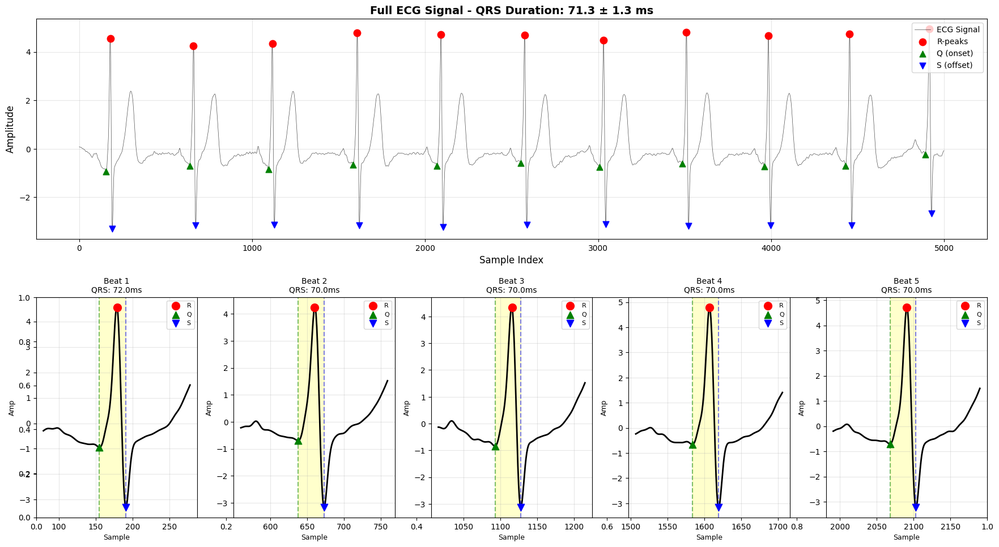



📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 71.27 ms
   Std:  1.29 ms

✅ QRS duration is NORMAL (60-100ms expected)

V4
V4


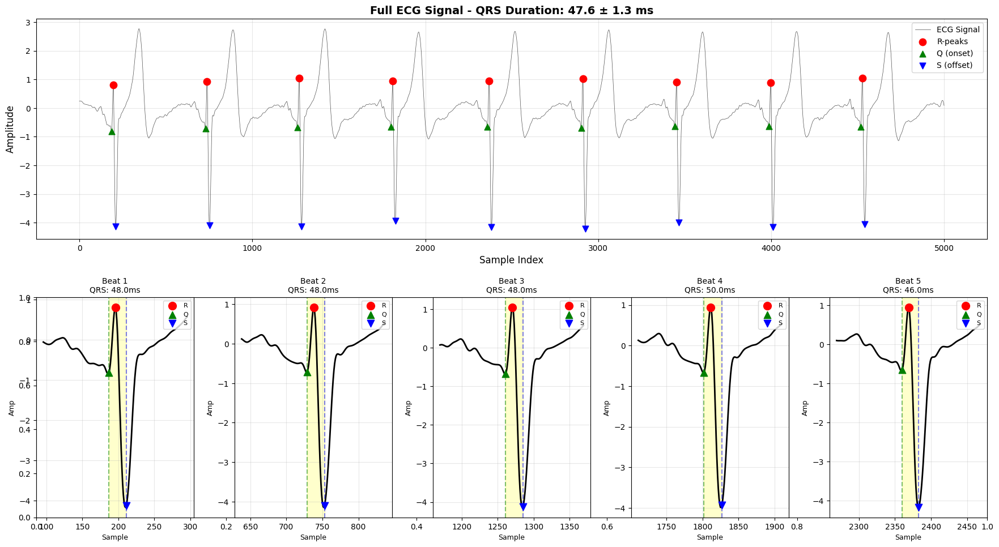


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 47.56 ms
   Std:  1.26 ms

✅ QRS duration is NORMAL (60-100ms expected)

V4


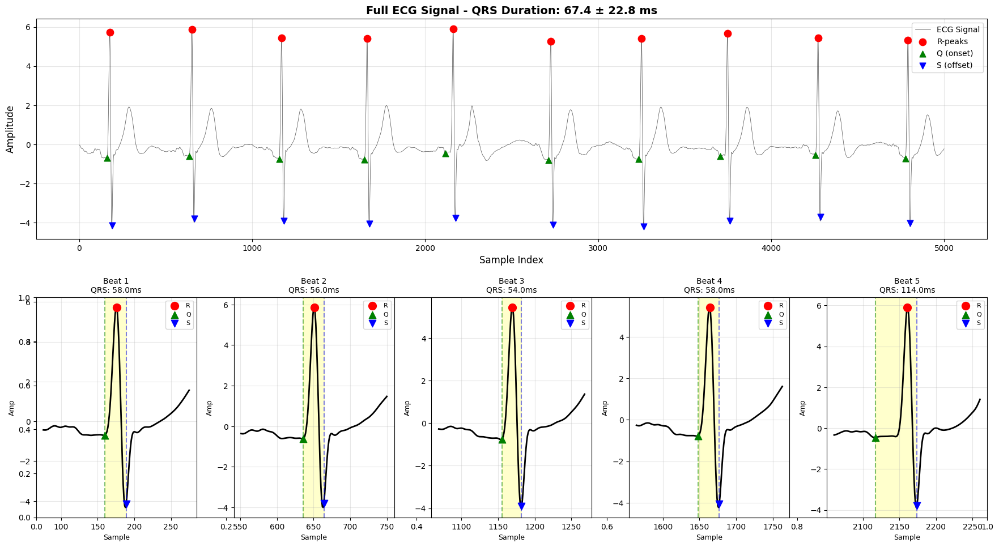


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 67.40 ms
   Std:  22.84 ms

✅ QRS duration is NORMAL (60-100ms expected)

V5


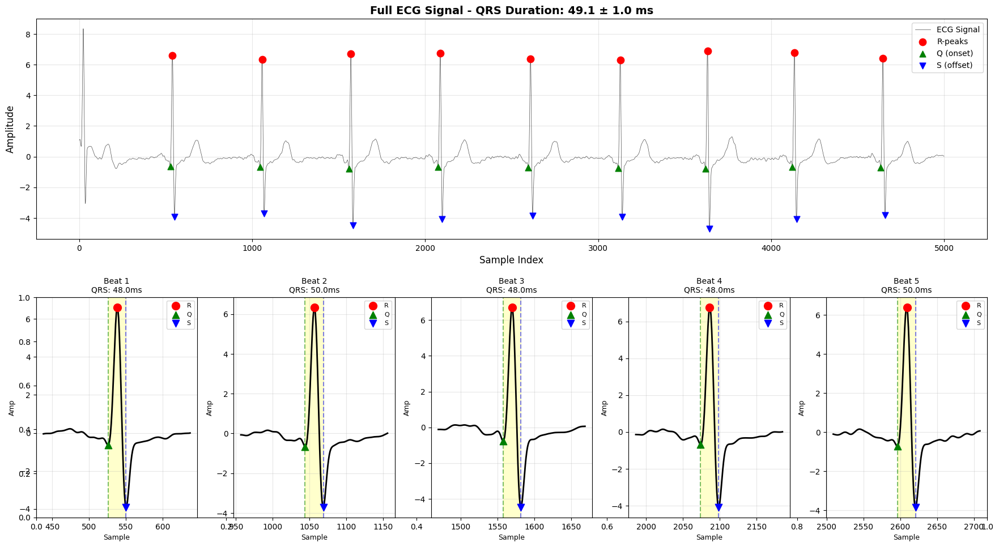


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 49.11 ms
   Std:  0.99 ms

✅ QRS duration is NORMAL (60-100ms expected)

V5


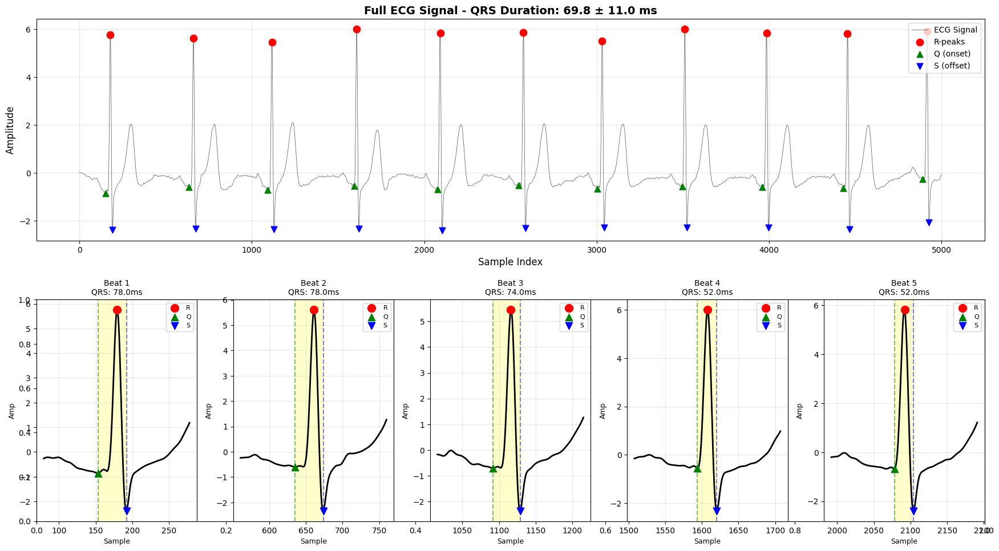


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 69.82 ms
   Std:  11.00 ms

✅ QRS duration is NORMAL (60-100ms expected)

V5


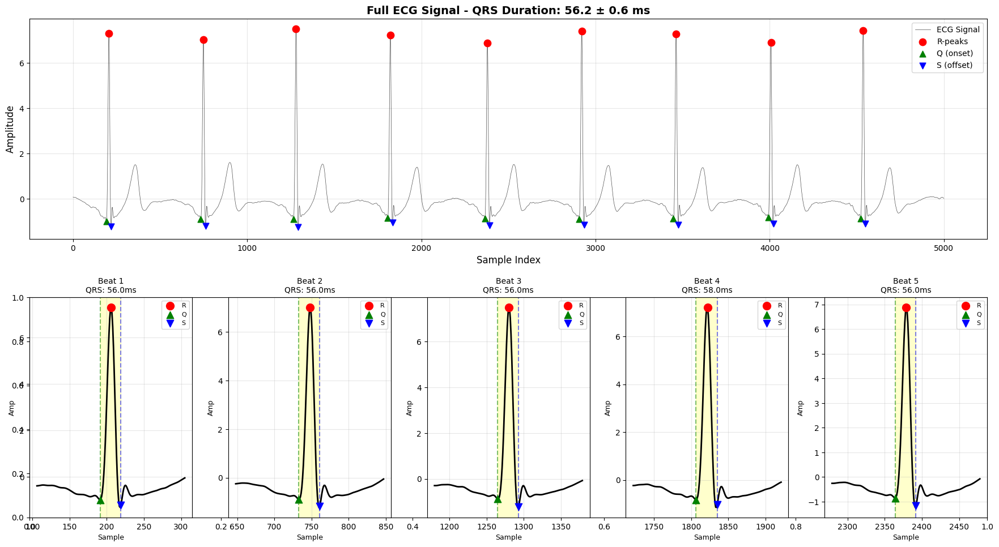


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 56.22 ms
   Std:  0.63 ms

✅ QRS duration is NORMAL (60-100ms expected)



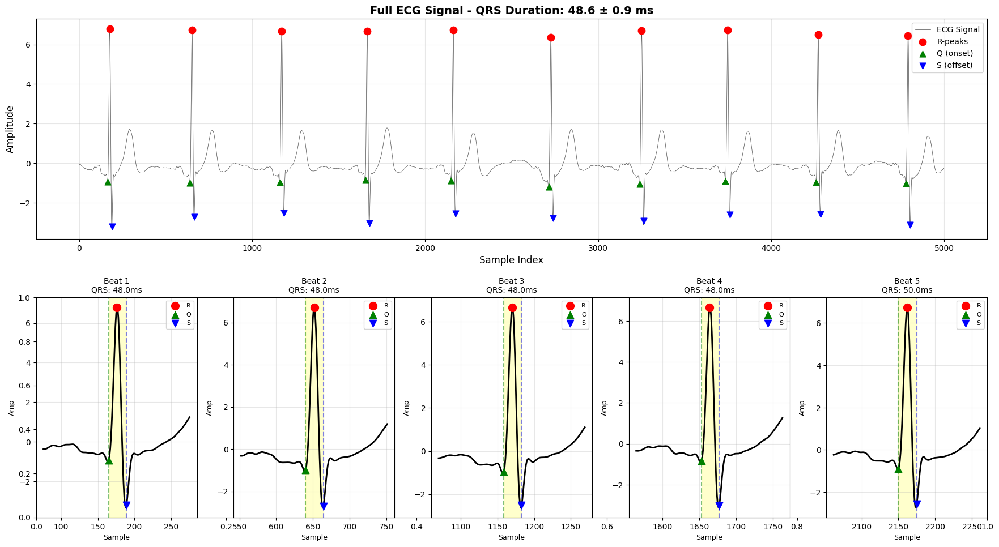


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 48.60 msV5

   Std:  0.92 ms

✅ QRS duration is NORMAL (60-100ms expected)

V6


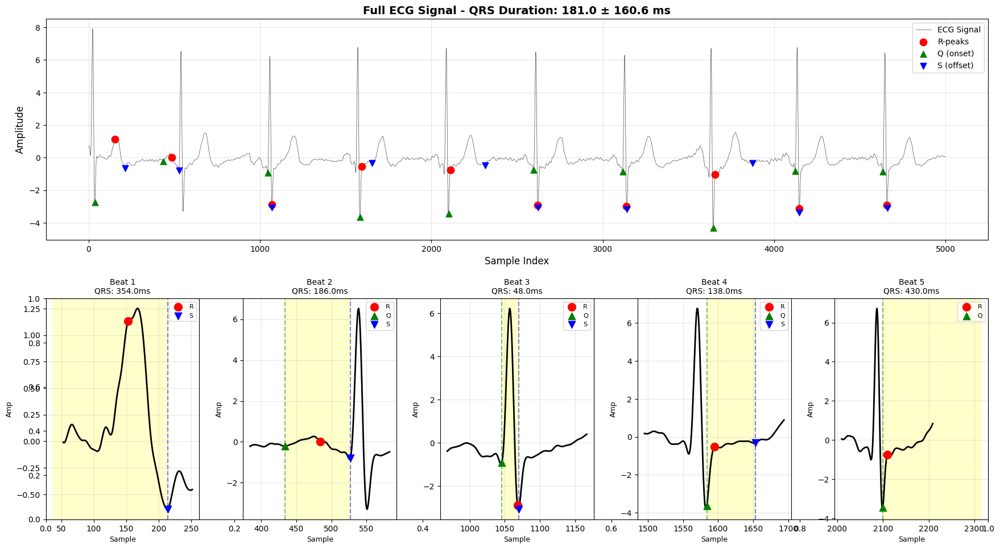


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 181.00 ms
   Std:  160.60 ms

⚠️  WARNING: QRS duration > 120ms
   ⚠️  High STD (160.6ms) → Possibly NOISE or detection error



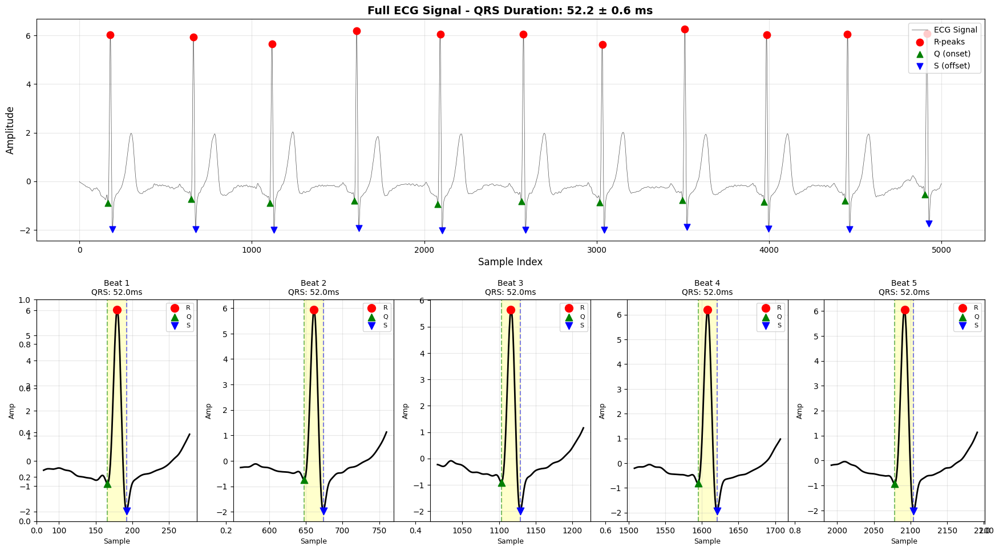


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 11
✅ Valid Q-peaks detected: 11
✅ Valid S-peaks detected: 11

📏 QRS Duration:
   Mean: 52.18 ms
   Std:  0.57 ms

✅ QRS duration is NORMAL (60-100ms expected)

V6


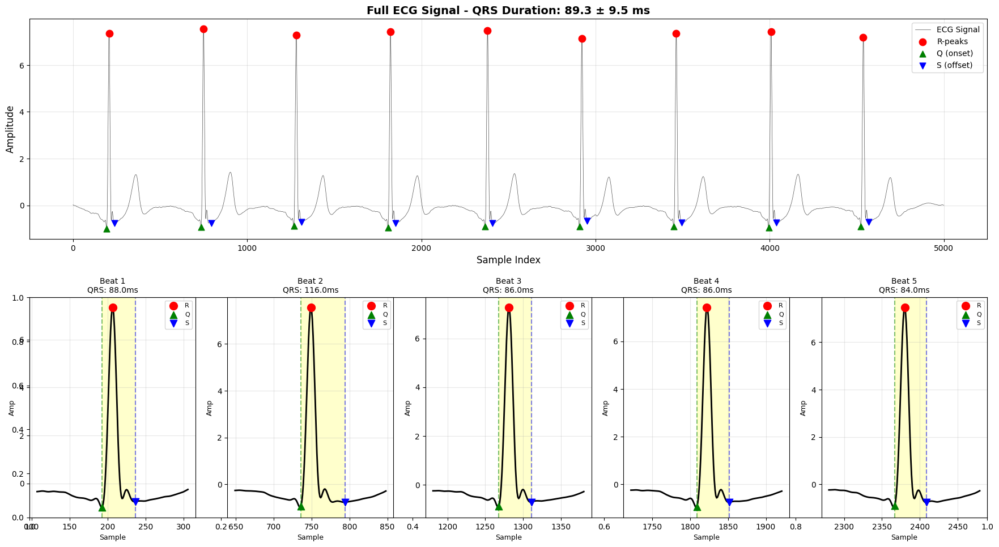


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:V6

   Mean: 89.33 ms
   Std:  9.48 ms

✅ QRS duration is NORMAL (60-100ms expected)

V6

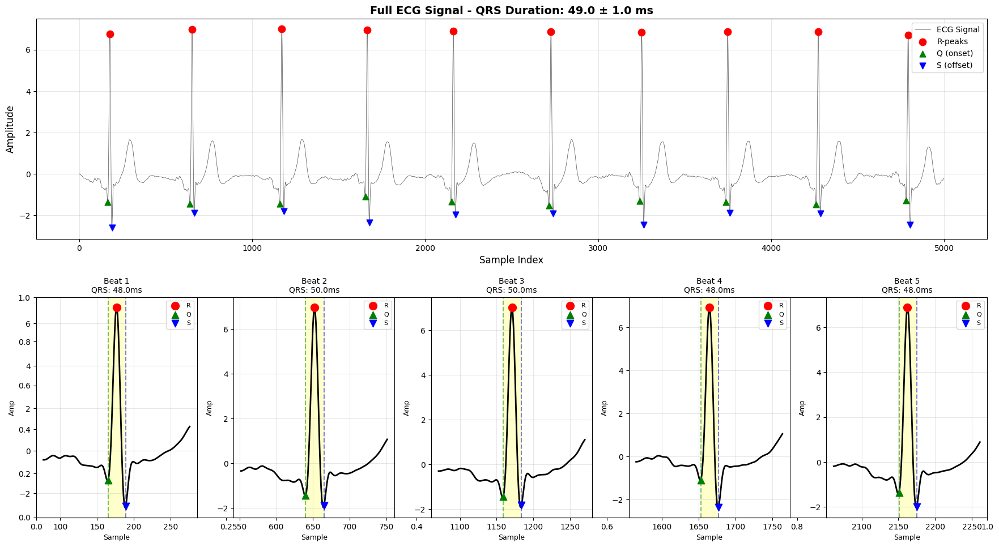



📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 10
✅ Valid Q-peaks detected: 10
✅ Valid S-peaks detected: 10

📏 QRS Duration:
   Mean: 49.00 ms
   Std:  1.00 ms

✅ QRS duration is NORMAL (60-100ms expected)



Processing ECG:  70%|███████   | 7/10 [00:55<00:28,  9.34s/it]

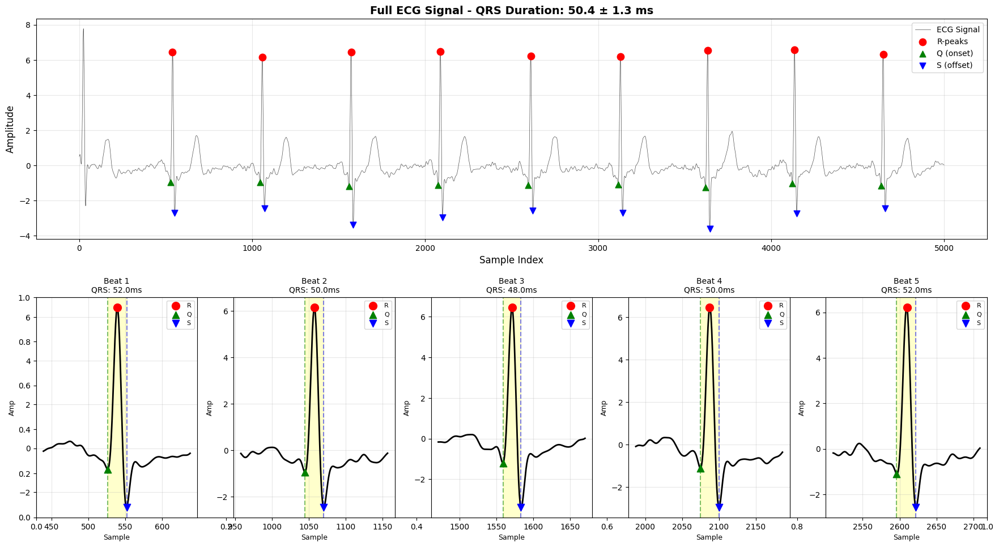


📊 QRS DELINEATION STATISTICS
✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Valid S-peaks detected: 9

📏 QRS Duration:
   Mean: 50.44 ms
   Std:  1.26 ms

✅ QRS duration is NORMAL (60-100ms expected)



Processing ECG:  80%|████████  | 8/10 [00:57<00:13,  6.76s/it]

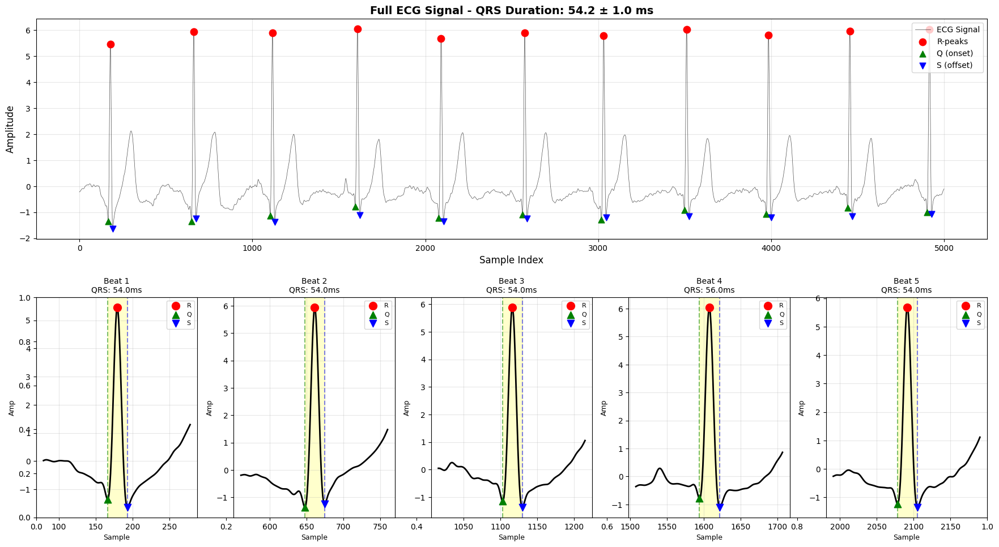

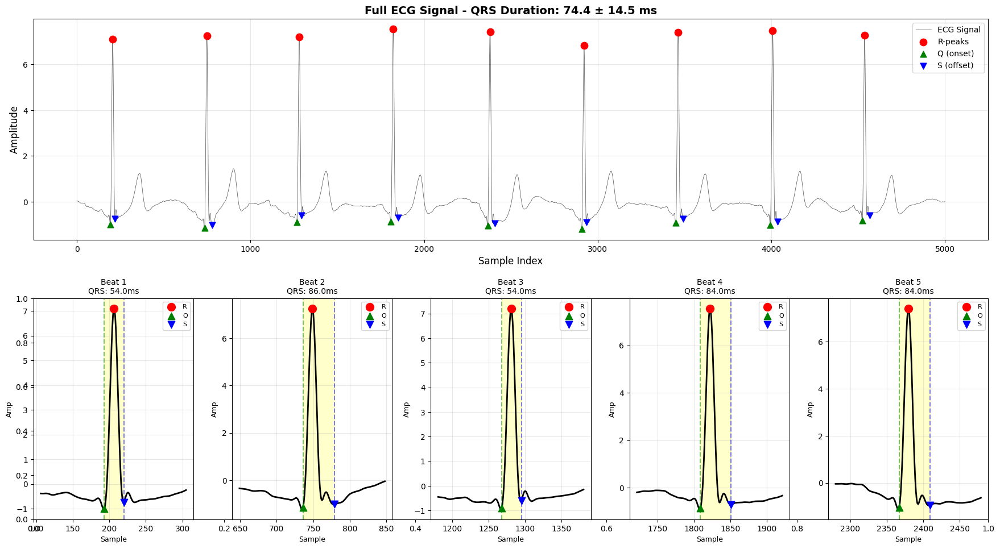



📊 QRS DELINEATION STATISTICS📊 QRS DELINEATION STATISTICS

✅ Total R-peaks detected: 9
✅ Valid Q-peaks detected: 9
✅ Total R-peaks detected: 11✅ Valid S-peaks detected: 9

✅ Valid Q-peaks detected: 11
📏 QRS Duration:

✅ Valid S-peaks detected: 11   Mean: 74.44 ms


📏 QRS Duration:
   Std:  14.48 ms   Mean: 54.18 ms


✅ QRS duration is NORMAL (60-100ms expected)   Std:  1.03 ms



✅ QRS duration is NORMAL (60-100ms expected)


Processing ECG:  90%|█████████ | 9/10 [00:57<00:04,  4.81s/it]

Processing ECG: 100%|██████████| 10/10 [00:57<00:00,  5.75s/it]


✅ Đã hoàn thành trích xuất ECG. Kết quả lưu tại: ecg_features.csv


In [3]:
# kiểm tra tín hiệu ecg có bị ngược không, nếu có: nghịch đảo
def check_and_fix_inverted_signal(ecg_signal):
    """
    Kiểm tra và sửa tín hiệu bị đảo ngược dựa trên skewness.
    Nếu skewness âm rõ rệt => khả năng cao QRS hướng xuống.
    """
    skew = stats.skew(ecg_signal)
    
    if skew < -0.5:
        return -ecg_signal, True
    else:
        return ecg_signal, False

# tìm R-peaks với 5 phương pháp trong neurokit2
def detect_r_peaks_smart(ecg_signal, sampling_rate=500, lead_name="ECG"):
    """
    Phát hiện R-peaks bằng nhiều thuật toán phổ biến và tự động kiểm định chất lượng tín hiệu.
    
    ✅ Dùng 5 phương pháp phổ biến.
    ✅ Chạy hết để đối chiếu, không in ra.
    ✅ Nếu độ lệch chuẩn giữa số peaks lớn → cảnh báo nhiễu hoặc arrhythmia.
    ✅ Nếu hầu hết không phát hiện được → tín hiệu lỗi (bỏ).
    
    Returns:
        {
            'ok': bool,                  # True nếu tín hiệu hợp lệ
            'reason': str,               # Lý do cảnh báo hoặc lỗi
            'consensus_method': str,     # Phương pháp chọn cuối cùng
            'n_peaks': int,
            'r_peaks': np.ndarray,
            'heart_rate': float
        }
    """
    
    methods = ['neurokit', 'pantompkins1985', 'hamilton2002', 'elgendi2010', 'kalidas2017']
    results = {}
    
    for method in methods:
        try:
            _, info = nk.ecg_peaks(ecg_signal, sampling_rate=sampling_rate, method=method)
            rpeaks = info.get('ECG_R_Peaks', [])
            
            if len(rpeaks) > 1:
                rr = np.diff(rpeaks) / sampling_rate
                # ✅ Lọc outliers (30-200 bpm)
                rr_filtered = rr[(rr >= 0.3) & (rr <= 2.0)]
                if len(rr_filtered) >= 2:
                    hr = 60 / np.mean(rr_filtered)
                    hr_std = 60 * np.std(rr_filtered) / (np.mean(rr_filtered) ** 2)
                    
                    # Kiểm tra HR hợp lý
                    if 30 <= hr <= 200:
                        results[method] = {
                            'n_peaks': len(rpeaks), 
                            'r_peaks': rpeaks, 
                            'hr': hr,
                            'hr_std': hr_std,
                            'ok': True, 
                            'info': info
                        }
                    else:
                        results[method] = {'n_peaks': len(rpeaks), 'r_peaks': rpeaks, 'hr': None, 'hr_std': None, 'ok': False}
                else:
                    results[method] = {'n_peaks': len(rpeaks), 'r_peaks': rpeaks, 'hr': None, 'hr_std': None, 'ok': False}
            else:
                results[method] = {'n_peaks': 0, 'r_peaks': [], 'hr': None, 'ok': False}
        
        except Exception as e:
            results[method] = {'n_peaks': 0, 'r_peaks': [], 'hr': None, 'ok': False, 'error': str(e), 'info': {}}
    
    # --- Phân tích kết quả tổng hợp ---
    success_counts = [v['n_peaks'] for v in results.values() if v['ok']]
    fail_ratio = sum(1 for v in results.values() if not v['ok']) / len(methods)
    
    # Không có phương pháp nào phát hiện được R-peaks
    if len(success_counts) == 0 or np.median(success_counts) == 0:
        return {
            'ok': False,
            'reason': f"⚠️ {lead_name}: No R-peaks detected by any method.",
            'consensus_method': None,
            'n_peaks': 0,
            'r_peaks': None,
            'heart_rate': None,
            'info': {}
        }
    
    # Nếu phần lớn phương pháp thất bại → tín hiệu có vấn đề
    if fail_ratio > 0.6:
        return {
            'ok': False,
            'reason': f"⚠️ {lead_name}: Most methods failed to detect R-peaks → possibly bad signal.",
            'consensus_method': None,
            'n_peaks': 0,
            'r_peaks': None,
            'heart_rate': None,
              'info': {}
        }

    # Nếu độ lệch chuẩn số peaks giữa các phương pháp cao
    std = np.std(success_counts)
    median = np.median(success_counts)
    if median > 0 and std > 0.5 * median:
        return {
            'ok': False,
            'reason': f"⚠️ {lead_name}: Inconsistent R-peak detection (std too large → noise or arrhythmia).",
            'consensus_method': None,
            'n_peaks': int(median),
            'r_peaks': None,
            'heart_rate': None,
            'info': {}
        }

    # --- Nếu ổn định → chọn phương pháp có số peaks gần median nhất ---
    consensus_method = min(
        results.items(), 
        key=lambda kv: abs(kv[1]['n_peaks'] - median)
    )[0]
    
    chosen = results[consensus_method]
    
    return {
        'ok': True,
        'reason': None,
        'consensus_method': consensus_method,
        'n_peaks': chosen['n_peaks'],
        'r_peaks': chosen['r_peaks'],
        'heart_rate': chosen['hr']
    }


#Loại bỏ nhiễu trong tín hiệu : nhiễu cơ sở (chuyển động, hô hấp) + nhiễu nguồn điện + nhiễu cơ điện + chuẩn hóa biên độ + đảo ngược chuỗi ecg
def preprocess_ecg(signal, fs=500, notch_freq=50.0, smooth=False):
    """
    Tiền xử lý tín hiệu ECG:
      - Loại bỏ baseline wander (<0.5 Hz)
      - Loại bỏ nhiễu nguồn điện (50/60 Hz)
      - Lọc nhiễu cơ (>40 Hz)
      - Chuẩn hóa biên độ (z-score)
      - (Tùy chọn) Làm mượt nhẹ

    Parameters
    ----------
    signal : array-like
        Tín hiệu ECG gốc (1 kênh)
    fs : int
        Tần số lấy mẫu (Hz)
    notch_freq : float
        Tần số nguồn điện (50 hoặc 60 Hz)
    smooth : bool
        Có làm mượt nhẹ (moving average) sau cùng không

    Returns
    -------
    clean_signal : np.ndarray
        Tín hiệu ECG đã tiền xử lý
    """

    signal = np.asarray(signal, dtype=float)
    if np.isnan(signal).any():
        signal = np.nan_to_num(signal, nan=0.0)

    nyquist = fs / 2

    # 1️⃣ Loại baseline wander (<0.5 Hz) bằng highpass
    b_hp, a_hp = butter(5, 1 / nyquist, btype='high')
    filtered = filtfilt(b_hp, a_hp, signal)

    # 2️⃣ Loại nhiễu cơ (>40 Hz) bằng lowpass
    b_lp, a_lp = butter(4, 35 / nyquist, btype='low')
    filtered = filtfilt(b_lp, a_lp, filtered)

    # 3️⃣ Loại nhiễu nguồn điện (50 hoặc 60 Hz)
    # (Notch filter Q=30 cho cân bằng tốt)
    b_notch, a_notch = iirnotch(notch_freq / nyquist, Q=30)
    filtered = filtfilt(b_notch, a_notch, filtered)

    # 4️⃣ Chuẩn hóa biên độ (z-score)
    mean = np.mean(filtered)
    std = np.std(filtered)
    if std == 0:
        std = 1e-6  # tránh chia 0
    normalized = (filtered - mean) / std

    # 5️⃣ Kiểm tra tín hiệu có bị đảo ngược không
    corrected_signal, inverted = check_and_fix_inverted_signal(normalized)

    # 5️⃣ (Tùy chọn) Làm mượt nhẹ để giảm nhiễu nhỏ lẻ
    # 6️⃣ (Tùy chọn) Làm mượt nhẹ
    if smooth:
        win_size = int(fs * 0.02)  # 20 ms
        win_size = max(win_size, 3)
        kernel = np.ones(win_size) / win_size
        smoothed = np.convolve(corrected_signal, kernel, mode='same')
        clean_signal = smoothed
    else:
        clean_signal = corrected_signal

    return clean_signal



###########################################################################################
#extract feature data: P, SQR, T,  (xử lý dữ liệu trong 1 đạo ecg trong bản ghi)

def extract_ecg_features2(signal, sampling_rate, lead_name):
    features = {}

    # 1️⃣ Tiền xử lý tín hiệu
    clean_signal0 = preprocess_ecg(signal)

    # 2️⃣ Tìm R-peaks bằng nhiều thuật toán
    detect_result = detect_r_peaks_smart(clean_signal0, sampling_rate=sampling_rate, lead_name=lead_name)
    if not detect_result['ok'] or detect_result['r_peaks'] is None:
        print(f"❌ {lead_name}: {detect_result['reason']}")
        features[f'{lead_name}_is_missing'] = True
        return features
    info = {'ECG_R_Peaks': detect_result['r_peaks']}

    # 3️⃣ Đánh giá chất lượng tín hiệu
    quality = nk.ecg_quality(clean_signal0, rpeaks=info['ECG_R_Peaks'], sampling_rate=sampling_rate)
    features[f'ECG_quality_mean_{lead_name}'] = np.nanmean(quality)
    features[f'ECG_quality_std_{lead_name}'] = np.nanstd(quality)

    # 4️⃣ Dò sóng ECG
    waves = nk.ecg_delineate(clean_signal0, info, sampling_rate=sampling_rate, method = 'dwt')

    # 5️⃣ Tính các intervals
    p_onsets = waves[1]['ECG_P_Onsets']
    q_peaks = waves[1]['ECG_Q_Peaks']
    s_peaks = waves[1]['ECG_S_Peaks']
    t_offsets = waves[1]['ECG_T_Offsets']
    qrs_onsets = waves[1]['ECG_R_Onsets']   # Hoặc 'ECG_QRS_Onsets' tùy version
    qrs_offsets = waves[1]['ECG_R_Offsets'] # Hoặc 'ECG_QRS_Offsets'

    pr_intervals = [(q - p) / sampling_rate * 1000 for p, q in zip(p_onsets, q_peaks) if not np.isnan(p) and not np.isnan(q)]

    # qrs_durations = [(s - q) / sampling_rate * 1000 for q, s in zip(q_peaks, s_peaks) if not np.isnan(q) and not np.isnan(s)]
    # ✅ THAY ĐỔI CHÍNH Ở ĐÂY
    qrs_durations = [(off - on) / sampling_rate * 1000 
                     for on, off in zip(qrs_onsets, qrs_offsets) 
                     if not np.isnan(on) and not np.isnan(off)]


    qt_intervals = [(t - q) / sampling_rate * 1000 for q, t in zip(q_peaks, t_offsets) if not np.isnan(q) and not np.isnan(t)]

    features[f'PR_interval_mean_{lead_name}'] = np.mean(pr_intervals) if pr_intervals else np.nan
    features[f'PR_interval_std_{lead_name}'] = np.std(pr_intervals) if pr_intervals else np.nan
    features[f'QRS_duration_mean_{lead_name}'] = np.mean(qrs_durations) if qrs_durations else np.nan
    features[f'QRS_duration_std_{lead_name}'] = np.std(qrs_durations) if qrs_durations else np.nan
    features[f'QT_interval_mean_{lead_name}'] = np.mean(qt_intervals) if qt_intervals else np.nan
    features[f'QT_interval_std_{lead_name}'] = np.std(qt_intervals) if qt_intervals else np.nan


    # 6️⃣ QRS amplitude
    r_peaks = np.array(info['ECG_R_Peaks']).astype(int)
    r_peaks_amplitude = clean_signal0[r_peaks]
    features[f'QRS_amp_mean_{lead_name}'] = np.mean(r_peaks_amplitude)
    features[f'QRS_amp_std_{lead_name}'] = np.std(r_peaks_amplitude)
    features[f'QRS_amplitude_max_{lead_name}'] = np.max(r_peaks_amplitude)
    features[f'QRS_amplitude_min_{lead_name}'] = np.min(r_peaks_amplitude)
    # 7️⃣ HR features
    heart_rate = nk.ecg_rate(info['ECG_R_Peaks'], sampling_rate=sampling_rate)
    features[f'HR_mean_{lead_name}'] = np.mean(heart_rate)
    features[f'HR_std_{lead_name}'] = np.std(heart_rate)
    features[f'HR_min_{lead_name}'] = np.min(heart_rate[~np.isnan(heart_rate)])
    features[f'HR_max_{lead_name}'] = np.max(heart_rate[~np.isnan(heart_rate)])
    
    # 8️⃣ Statistical features
    features[f'Skewness_{lead_name}'] = skew(clean_signal0)
    features[f'Kurtosis_{lead_name}'] = kurtosis(clean_signal0)
    entropy_val = nk.entropy_sample(clean_signal0)
    if isinstance(entropy_val, tuple):
        entropy_val = float(entropy_val[0])
    
    features[f'Entropy_{lead_name}'] = entropy_val
    # Sử dụng hàm visualize_qrs_delineation từ câu trước
    print(lead_name)
    visualize_qrs_delineation(clean_signal0, info['ECG_R_Peaks'], sampling_rate=500, n_beats=5)
    return features

###########################################################################################
# xử lý dữ liệu trong 1 bản ghi 
LEAD_NAMES = ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']

def process_record(record_path):
    try:
        # Đọc tín hiệu ECG
        rec = wfdb.rdrecord(record_path)
        name = rec.record_name
        fs = rec.fs
        sig_len = rec.sig_len
        duration = sig_len / fs

        # ---- Metadata ----
        age, sex, dx = None, None, []
        for c in rec.comments:
            c = c.strip()
            if c.startswith('Age:'):
                try:
                    age = int(c.split(':')[1].strip())
                except:
                    age = None
            elif c.startswith('Sex:'):
                sex = c.split(':')[1].strip()
            elif c.startswith('Dx:'):
                dx = [d.strip() for d in c.split(':')[1].split(',')]

        # Nhãn AF dựa vào mã SNOMED
        has_AF = '164889003' in dx if isinstance(dx, list) else False

        # ---- Trích xuất đặc trưng ----
        features = {}
        
        
        for i, lead_name in enumerate(LEAD_NAMES):
            signal = rec.p_signal[:, i]

            # Nếu toàn 0 hoặc NaN thì bỏ qua
            if np.all(np.isnan(signal)) or np.all(signal == 0):
                features[f'{lead_name}_is_missing'] = True
                continue

            feats = extract_ecg_features2(signal, fs, lead_name)
            features.update(feats)
            features[f'{lead_name}_is_missing'] = False

        # ---- Gộp dữ liệu ----
        row = {
            'record_name': name,
            'sex': sex,
            'age': age,
            'fs': fs,
            'duration_sec': duration,
            'diagnose': ','.join(dx) if isinstance(dx, list) else dx,
            'has_AF': has_AF,
            'record_path': record_path,
        }
        row.update(features)

        return row

    except Exception as e:
        # Ghi log lỗi để debug dễ hơn
        print(f"⚠️ Lỗi ở record {record_path}: {e}")
        return {'record_name': record_path, 'error': str(e)}


def extract_all_records(records, output_csv="ecg_features.csv", max_workers=None, chunk_size=50):
    """
    - records: danh sách các file ECG (.hea không có đuôi)
    - output_csv: nơi ghi kết quả
    - max_workers: số tiến trình song song
    - chunk_size: số record ghi ra file mỗi lần
    """
    if max_workers is None:
        max_workers = max(1, os.cpu_count() - 1)

    print(f"⚙️ Sử dụng {max_workers} tiến trình song song")

    rows_buffer = []
    header_written = False

    with ProcessPoolExecutor(max_workers=max_workers) as executor:
        futures = [executor.submit(process_record, r) for r in records]

        for f in tqdm(as_completed(futures), total=len(records), desc="Processing ECG"):
            result = f.result()
            rows_buffer.append(result)

            # Khi đủ chunk_size bản ghi thì ghi ra CSV
            if len(rows_buffer) >= chunk_size:
                df = pd.DataFrame(rows_buffer)
                df.to_csv(output_csv, mode='a', index=False, header=not header_written)
                header_written = True
                rows_buffer.clear()  # xóa khỏi RAM
                gc.collect()

    # Ghi phần còn lại nếu chưa đủ chunk cuối
    if rows_buffer:
        df = pd.DataFrame(rows_buffer)
        df.to_csv(output_csv, mode='a', index=False, header=not header_written)
        rows_buffer.clear()
        gc.collect()

    print(f"✅ Đã hoàn thành trích xuất ECG. Kết quả lưu tại: {output_csv}")

extract_all_records(records_test, output_csv="ecg_features.csv", max_workers=6, chunk_size=25)

Hàm xử lý feature trong 1 bản ghi

# Read data + test

In [ ]:
import pandas as pd
import numpy as np

# Đọc dữ liệu
df = pd.read_csv("ecg_features.csv")

# Danh sách đạo trình
LEADS = ['I','II','III','aVR','aVL','aVF','V1','V2','V3','V4','V5','V6']

# Ngưỡng tham chiếu sinh lý (theo y học ECG)
normal_ranges = {
    "PR_interval_mean": (120, 200),        # ms
    "QRS_duration_mean": (70, 120),        # ms
    "QT_interval_mean": (350, 440),        # ms
    "HR_mean": (60, 100),                  # bpm
    "QRS_amp_mean": (0.5, 5.0),            # mV (ước lượng)
    "ECG_quality_mean": (0.3, 0.8),        # normalized quality score
    "Entropy": (0.02, 0.15)                # approximate entropy
}

# Hàm đánh giá mức độ "hợp lý" dựa trên ngưỡng
def assess_range(colname, stats, low, high):
    if "mean" not in stats or pd.isna(stats["mean"]):
        return "❓ Không có mean (cột toàn NaN hoặc không phải dạng số)"

    mean = stats["mean"]
    if mean < low * 0.8 or mean > high * 1.2:
        return "⚠️ Ngoài vùng sinh lý (bất thường)"
    elif mean < low or mean > high:
        return "⚠ Có thể nhiễu hoặc lệch pha"
    else:
        return "✅ Bình thường"


# Duyệt qua từng loại đặc trưng và đạo trình
for feature in ["PR_interval_mean", "QRS_duration_mean", "QT_interval_mean", 
                "HR_mean", "QRS_amp_mean", "ECG_quality_mean", "Entropy"]:
    print(f"\n📊 --- {feature.upper()} ---")
    if feature not in df.columns:
        # kiểm tra pattern kiểu Entropy_I
        pass
    for lead in LEADS:
        col = f"{feature}_{lead}"
        if col not in df.columns:
            continue
        stats = df[col].describe()
        if "mean" not in stats:
            print(f"{col:25s}  Không có mean → bỏ qua cột này")
            continue
        low, high = normal_ranges.get(feature, (None, None))
        remark = assess_range(col, stats, low, high)
        print(f"{col:25s}  mean={stats['mean']:.3f}  std={stats['std']:.3f}  min={stats['min']:.3f}  max={stats['max']:.3f} → {remark}")


/tmp/ipykernel_9997/2286205489.py:21: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.replace({True: 1, False: 0})


✅ Đã làm sạch dữ liệu, kết quả lưu tại ecg_features_clean.csv
